In [1]:
#!pip install --upgrade tensorflow

In [1]:
import pathlib
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import os
import PIL
import glob
from tensorflow.keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping
from tensorflow.keras import optimizers
from tensorflow.keras.layers import Dropout
import matplotlib.pyplot as plt
import seaborn as sns
import cv2

# Set TensorFlow to use GPU
physical_devices = tf.config.list_physical_devices('GPU')
if physical_devices:
    try:
        # Iterate through physical GPUs
        for gpu in physical_devices:
            tf.config.experimental.set_memory_growth(gpu, True)
    except RuntimeError as e:
        # Memory growth cannot be modified after GPU has been initialized
        print(e)

# Set seaborn style
sns.set(rc={'axes.labelsize': 12, 'ytick.labelsize': 12, 'xtick.labelsize': 12, 'axes.titlesize': 15})


In [2]:
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        # Currently, memory growth needs to be the same across GPUs
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        logical_gpus = tf.config.experimental.list_logical_devices('GPU')
        print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
    except RuntimeError as e:
        # Memory growth must be set before GPUs have been initialized
        print(e)


1 Physical GPUs, 1 Logical GPUs


In [3]:
train_dir = pathlib.Path("/kaggle/input/updated-tv-production/Tv_Production_DS/Train")
test_dir = pathlib.Path("/kaggle/input/updated-tv-production/Tv_Production_DS/Test")
#test_simple_dir = pathlib.Path("/kaggle/input/bloodcells/dataset2-master/dataset2-master/images/TEST_SIMPLE")

#df = pd.read_csv("/kaggle/input/bloodcells/dataset2-master/dataset2-master/labels.csv")

In [4]:
class_names = os.listdir(train_dir)
class_names

['Horror', 'Animation', 'Romance', 'Action']

In [5]:
# train and test size
image_count_train = len(list(train_dir.glob('*/*.png'))) + len(list(train_dir.glob('*/*.bmp'))) + len(list(train_dir.glob('*/*.jpg')))
print(image_count_train)

image_count_test = len(list(test_dir.glob('*/*.png'))) + len(list(test_dir.glob('*/*.bmp'))) + len(list(test_dir.glob('*/*.jpg')))
print(image_count_test)


3131
1344


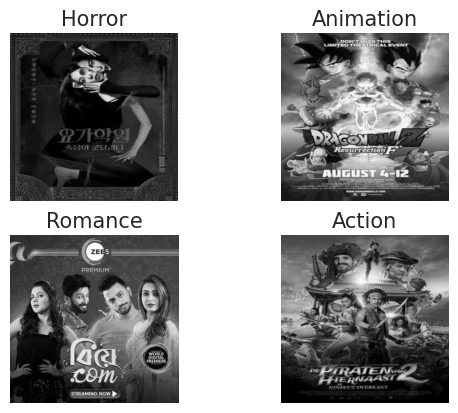

In [11]:
import tensorflow as tf
from pathlib import Path

# Set TensorFlow to use GPU
physical_devices = tf.config.list_physical_devices('GPU')
if physical_devices:
    try:
        # Iterate through physical GPUs
        for gpu in physical_devices:
            tf.config.experimental.set_memory_growth(gpu, True)
    except RuntimeError as e:
        # Memory growth cannot be modified after GPU has been initialized
        print(e)


# Your code to define class_names and train_dir goes here

# Function to plot an image
def plotImage(image_path):
    img = plt.imread(image_path)
    plt.imshow(img)
    plt.axis('off')

# Loop through each class and plot an image
for i in range(4): 
    class_images = list(train_dir.glob(class_names[i]+'/*.jpg')) + \
                   list(train_dir.glob(class_names[i]+'/*.png')) + \
                   list(train_dir.glob(class_names[i]+'/*.bmp'))
    if class_images:  # Check if images exist for this class
        plt.subplot(2, 2, i + 1)
        image_path = str(class_images[0])
        if image_path.lower().endswith('.jpeg'):
            img = Image.open(image_path)
            plt.imshow(img)
        else:
            plotImage(image_path)
        plt.title(class_names[i])
        plt.grid()
    else:
        print(f"No images found for class {class_names[i]}")
plt.show()


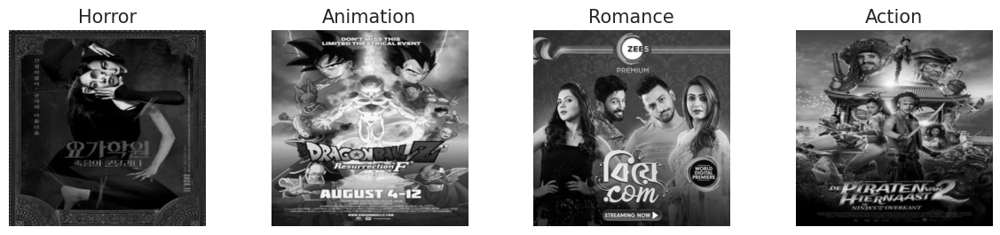

In [12]:
plt.figure(figsize=(12, 10))
for i in range(4): 
    # Get image paths for the current class
    image_paths = list(train_dir.glob(class_names[i]+'/*.jpg')) + \
                  list(train_dir.glob(class_names[i]+'/*.bmp')) + \
                  list(train_dir.glob(class_names[i]+'/*.png'))

    # Check if there are any images for the current class
    if not image_paths:
        print(f"No images found for class: {class_names[i]}")
        continue  # Skip to the next class

    # Plot the first image for the current class
    plt.subplot(4, 4, i + 1)
    plotImage(str(image_paths[0]))  # Plot the first image path
    plt.title(class_names[i])
    plt.grid()

plt.tight_layout()
plt.show()


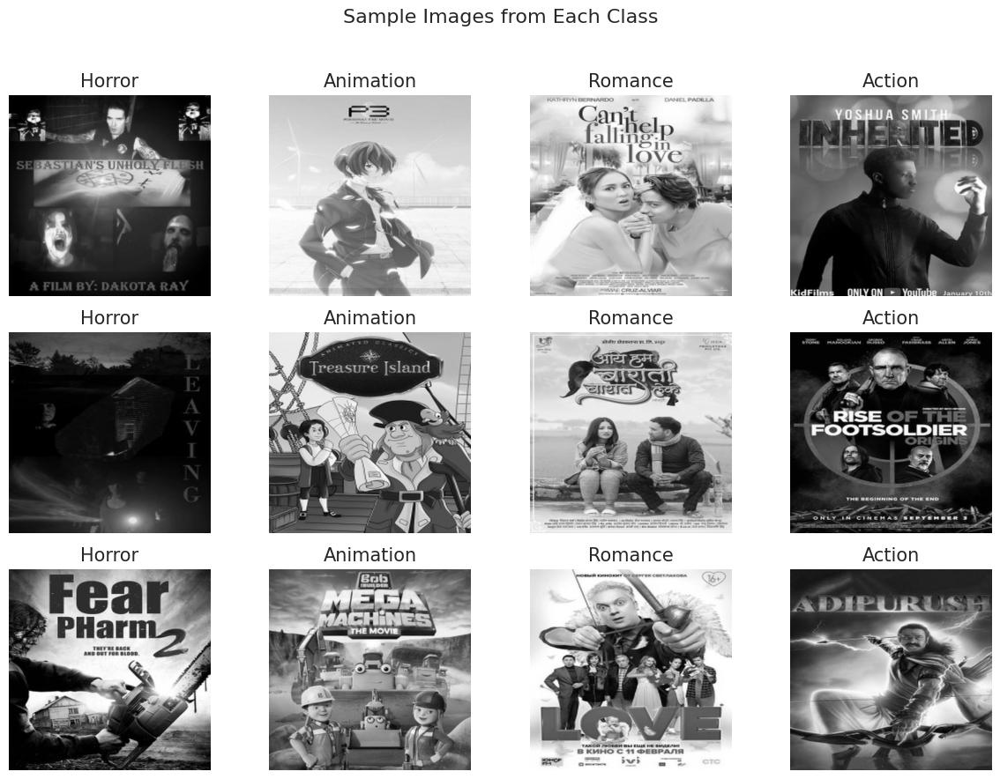

In [23]:
import tensorflow as tf
import matplotlib.pyplot as plt
from pathlib import Path
from PIL import Image
import random

# Set TensorFlow to use GPU
physical_devices = tf.config.list_physical_devices('GPU')
if physical_devices:
    try:
        for gpu in physical_devices:
            tf.config.experimental.set_memory_growth(gpu, True)
    except RuntimeError as e:
        print(e)

# Your code to define class_names and train_dir goes here

# Function to plot an image
def plot_image(image_path, ax):
    img = Image.open(image_path)
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(image_path.parent.name)  # Set title as class name

# Set up figure size
fig, axes = plt.subplots(3, 4, figsize=(12, 9))
fig.suptitle("Sample Images from Each Class", fontsize=16)

for i, class_name in enumerate(class_names[:4]):  # Ensure only 4 classes
    class_images = list(train_dir.glob(f'{class_name}/*.*'))  # Get all images
    
    if class_images:  # Check if images exist
        sampled_images = random.sample(class_images, min(3, len(class_images)))
        for j, image_path in enumerate(sampled_images):
            plot_image(image_path, axes[j, i])
    else:
        print(f"No images found for class {class_name}")

plt.tight_layout(rect=[0, 0, 1, 0.96])  # Adjust layout for title
plt.show()


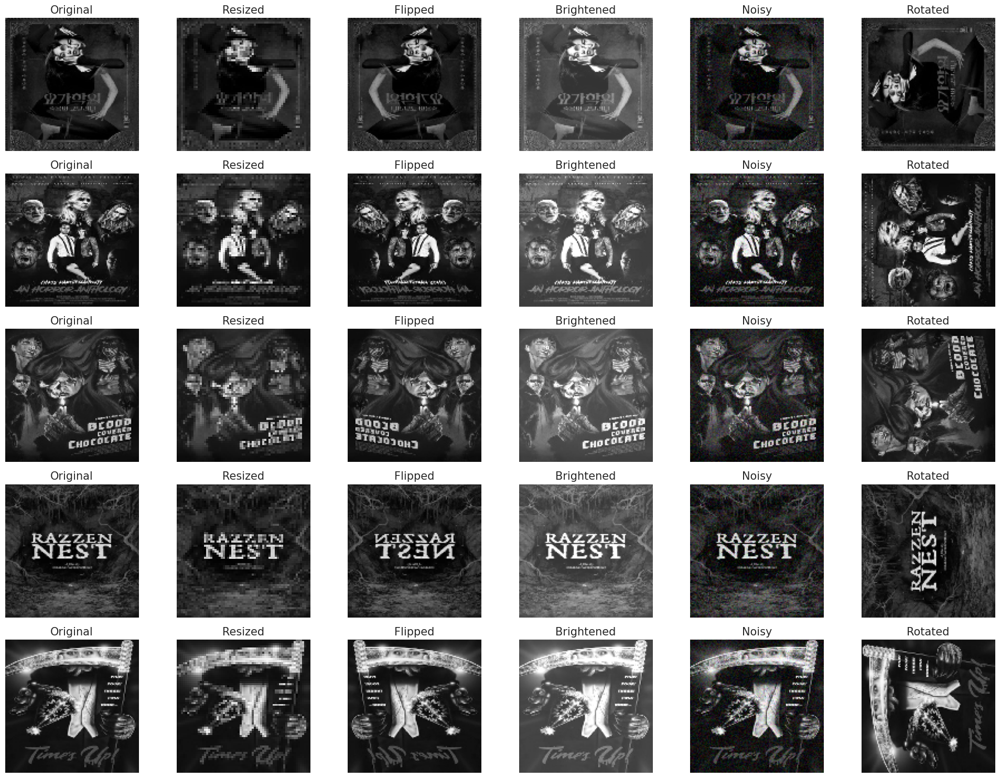

In [24]:
import pathlib
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
from tensorflow.keras.preprocessing.image import load_img, img_to_array

# Directories for training and testing data
train_dirrr = pathlib.Path("/kaggle/input/updated-tv-production/Tv_Production_DS/Train")
#test_dir = pathlib.Path("/kaggle/input/dancceforrmfff/Test")

# Helper function to load and preprocess a single image
def load_and_preprocess_image(image_path, target_size=(120, 120)):
    img = load_img(image_path, target_size=target_size)
    img_array = img_to_array(img) / 255.0  # Normalize to [0, 1]
    return img, img_array

# Select a few images for visualization
train_images = list(train_dirrr.glob("*/*.jpg"))[:5]

# Apply different preprocessing techniques
def apply_preprocessing(img_array):
    # Resize
    resized = tf.image.resize(img_array, [64, 64])

    # Flip horizontally
    flipped = tf.image.flip_left_right(img_array)

    # Adjust brightness
    brightened = tf.image.adjust_brightness(img_array, delta=0.2)

    # Add Gaussian noise
    noise = tf.random.normal(shape=img_array.shape, mean=0.0, stddev=0.05)
    noisy = tf.clip_by_value(img_array + noise, 0.0, 1.0)

    # Rotation (90 degrees)
    rotated = tf.image.rot90(img_array)

    return resized, flipped, brightened, noisy, rotated

# Plot results
def visualize_preprocessing(image_paths):
    plt.figure(figsize=(20, 15))
    for idx, image_path in enumerate(image_paths):
        # Load image and preprocess
        img, img_array = load_and_preprocess_image(image_path)

        # Apply preprocessing
        resized, flipped, brightened, noisy, rotated = apply_preprocessing(img_array)

        # Plot original and preprocessed images
        plt.subplot(len(image_paths), 6, idx * 6 + 1)
        plt.imshow(img_array)  # Use the normalized NumPy array
        plt.title("Original")
        plt.axis("off")

        plt.subplot(len(image_paths), 6, idx * 6 + 2)
        plt.imshow(resized.numpy())
        plt.title("Resized")
        plt.axis("off")

        plt.subplot(len(image_paths), 6, idx * 6 + 3)
        plt.imshow(flipped.numpy())
        plt.title("Flipped")
        plt.axis("off")

        plt.subplot(len(image_paths), 6, idx * 6 + 4)
        plt.imshow(brightened.numpy())
        plt.title("Brightened")
        plt.axis("off")

        plt.subplot(len(image_paths), 6, idx * 6 + 5)
        plt.imshow(noisy.numpy())
        plt.title("Noisy")
        plt.axis("off")

        plt.subplot(len(image_paths), 6, idx * 6 + 6)
        plt.imshow(rotated.numpy())
        plt.title("Rotated")
        plt.axis("off")

    plt.tight_layout()
    plt.show()

# Visualize preprocessing on train images
visualize_preprocessing(train_images)


In [25]:
print('Training samples:')
num_samples = 0
for cell in os.listdir(train_dir):
    num_cells = len(os.listdir(os.path.join(train_dir, cell)))
    num_samples += num_cells
    print('Cell: {:15s}  num samples: {:d}'.format(cell, num_cells))
print('Total training samples: {:d}\n'.format(num_samples))

print('Test samples:')
num_samples = 0
for cell in os.listdir(test_dir):
    num_cells = len(os.listdir(os.path.join(test_dir, cell)))
    num_samples += num_cells
    print('Cell: {:15s}  num samples: {:d}'.format(cell, num_cells))
print('Total test samples: {:d}'.format(num_samples))

Training samples:
Cell: Horror           num samples: 812
Cell: Animation        num samples: 812
Cell: Romance          num samples: 786
Cell: Action           num samples: 721
Total training samples: 3131

Test samples:
Cell: Horror           num samples: 348
Cell: Animation        num samples: 349
Cell: Romance          num samples: 337
Cell: Action           num samples: 310
Total test samples: 1344


In [26]:
# function to plot the training/validation accuracies/losses.

def plot_learning(history):
    fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15,4))
    axes[0].plot(history.history['loss'])   
    axes[0].plot(history.history['val_loss'])
    #axes[0].grid()
    axes[0].legend(['loss','val_loss'])
    axes[1].plot(history.history['accuracy'])   
    axes[1].plot(history.history['val_accuracy'])
    #axes[1].grid()
    axes[1].legend(['accuracy','val_accuracy'])

In [27]:
# resolution of images
plt.imread(str(list(train_dir.glob(class_names[i]+'/*.jpg'))[0])).shape

(640, 640, 3)

In [28]:
# defining some parameters for the loader

batch_size = 32
img_height = 120
img_width = 120

# lower resolution images reduce the definition/clarity of certain features in images.
# It can make it harder for CNN to learn the features required for classification or detection.
# working with 120 x 120 resolution images for now.

In [29]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam

# Check if GPU is available
physical_devices = tf.config.list_physical_devices('GPU')
if physical_devices:
    print("GPU is available")
    # Set memory growth for GPU
    try:
        for gpu in physical_devices:
            tf.config.experimental.set_memory_growth(gpu, True)
    except RuntimeError as e:
        print(e)

# Initialize Adam optimizer
optimizer = Adam()

# Define loss function
loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True)


GPU is available


In [30]:
train_ds = tf.keras.preprocessing.image_dataset_from_directory(
    train_dir,
    seed=21,
    validation_split= 0.12,
    subset= 'training',
    image_size=(img_height,img_width),
    batch_size = batch_size
)

Found 3131 files belonging to 4 classes.
Using 2756 files for training.


In [31]:
val_ds = tf.keras.preprocessing.image_dataset_from_directory(
    train_dir,
    seed=21,
    validation_split= 0.12,
    subset= 'validation',
    image_size=(img_height,img_width),
    batch_size = batch_size
)

Found 3131 files belonging to 4 classes.
Using 375 files for validation.


In [32]:
test_ds = tf.keras.preprocessing.image_dataset_from_directory(
    test_dir,
    image_size=(img_height,img_width),
    batch_size = batch_size
)

Found 1344 files belonging to 4 classes.


In [33]:
tf.test.is_gpu_available()
#tf.test.gpu_device_name()

True

In [34]:
import os
os.environ['TF_CUDNN_DETERMINISTIC'] = '1'

import tensorflow as tf


In [35]:
import os
os.environ['TF_XLA_FLAGS'] = '--tf_xla_disable_xla_devices'

import tensorflow as tf


# PVT (Pyramid Vision Transformer)

In [ ]:
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Dropout, GlobalAveragePooling2D, Input, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.regularizers import l2
import timm
import tensorflow_hub as hub

# Define input shape
img_height, img_width = 224, 224
num_classes = 4

# Load PVT model from timm
pvt_base = hub.KerasLayer("https://tfhub.dev/sayakpaul/pvt_v2_b2/1", trainable=True)

# Define input tensor
input_tensor = Input(shape=(img_height, img_width, 3))

# Add PVT base model
x = pvt_base(input_tensor)

# Add GlobalAveragePooling2D layer
x = GlobalAveragePooling2D()(x)

# Add Dense layers with Batch Normalization and Dropout
x = Dense(1024, activation='relu', kernel_regularizer=l2(0.0001))(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)

x = Dense(512, activation='relu', kernel_regularizer=l2(0.0001))(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)

x = Dense(256, activation='relu', kernel_regularizer=l2(0.0001))(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)

x = Dense(128, activation='relu', kernel_regularizer=l2(0.0001))(x)
x = BatchNormalization()(x)

# Output layer
output_tensor = Dense(num_classes, activation='softmax')(x)

# Create model
model = Model(inputs=input_tensor, outputs=output_tensor)

# Use learning rate scheduling
lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=0.0005, decay_steps=5000, decay_rate=0.9, staircase=True
)

# Compile the model
model.compile(optimizer=Adam(learning_rate=lr_schedule), loss="categorical_crossentropy", metrics=["accuracy"])

# Print summary
model.summary()


In [38]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam

# Check if GPU is available
physical_devices = tf.config.list_physical_devices('GPU')
if physical_devices:
    print("GPU is available")
    # Set memory growth for GPU
    try:
        for gpu in physical_devices:
            tf.config.experimental.set_memory_growth(gpu, True)
    except RuntimeError as e:
        print(e)

# Initialize Adam optimizer
optimizer = Adam()

# Specify loss function
loss = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True)



GPU is available


In [39]:
from tensorflow.keras.callbacks import ReduceLROnPlateau


In [40]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau

# Define the optimizer with a custom learning rate
optimizer = Adam(learning_rate=0.0001)  # You can adjust the learning rate here

# Compile the model with the optimizer
model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])

# Define the ReduceLROnPlateau callback
lr_reducer = ReduceLROnPlateau(
    monitor='val_loss',
    factor=0.2,
    patience=3,
    min_lr=0.00001,
    verbose=1
)


# Define other callbacks if needed
callbacks = [lr_reducer]


In [41]:
import tensorflow as tf

# Disable graph optimization
tf.config.optimizer.set_experimental_options({'disable_meta_optimizer': True})


In [42]:
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        # Currently, memory growth needs to be the same across GPUs
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        logical_gpus = tf.config.experimental.list_logical_devices('GPU')
        print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
    except RuntimeError as e:
        # Memory growth must be set before GPUs have been initialized
        print(e)


1 Physical GPUs, 1 Logical GPUs


In [43]:
import tensorflow as tf

# Set GPU memory growth to avoid memory fragmentation issues
physical_devices = tf.config.list_physical_devices('GPU')
for device in physical_devices:
    tf.config.experimental.set_memory_growth(device, True)


In [44]:
import warnings

# Suppress the warning
warnings.filterwarnings("ignore", message="All log messages before absl::InitializeLog()")

# Your code here


In [46]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import SparseCategoricalCrossentropy

# Check if GPU is available
physical_devices = tf.config.list_physical_devices('GPU')
if physical_devices:
    print("GPU is available")
    # Set memory growth for GPU
    try:
        for gpu in physical_devices:
            tf.config.experimental.set_memory_growth(gpu, True)
    except RuntimeError as e:
        print(e)

# Initialize Adam optimizer
optimizer = Adam()

# Specify loss function
loss = SparseCategoricalCrossentropy(from_logits=False)

# Compile the model
model.compile(optimizer=optimizer,
              loss=loss,
              metrics=['accuracy'])

epochs = 100
history_model_net = model.fit(
                    train_ds,
                    validation_data=val_ds,
                    #steps_per_epoch=500,
                    epochs=epochs,
                   # callbacks=callbacks
)


GPU is available
Epoch 1/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 18s 101ms/step - accuracy: 0.6918 - loss: 0.7911 - val_accuracy: 0.6293 - val_loss: 1.1659
Epoch 2/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - accuracy: 0.7367 - loss: 0.6984 - val_accuracy: 0.6027 - val_loss: 1.3759
Epoch 3/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - accuracy: 0.7395 - loss: 0.6417 - val_accuracy: 0.6133 - val_loss: 1.2491
Epoch 4/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 37ms/step - accuracy: 0.7632 - loss: 0.6302 - val_accuracy: 0.6533 - val_loss: 1.4002
Epoch 5/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - accuracy: 0.8181 - loss: 0.4841 - val_accuracy: 0.6720 - val_loss: 1.0248
Epoch 6/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7984 - loss: 0.5380 - val_accuracy: 0.6213 - val_loss: 1.4855
Epoch 7/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 38ms/step - accuracy: 0.7776 - loss: 0.6012 - val_accuracy: 0.6187 - val_loss: 1.3926
Epoch 8/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 37ms/step - accuracy: 0.8431 - loss: 0.4052

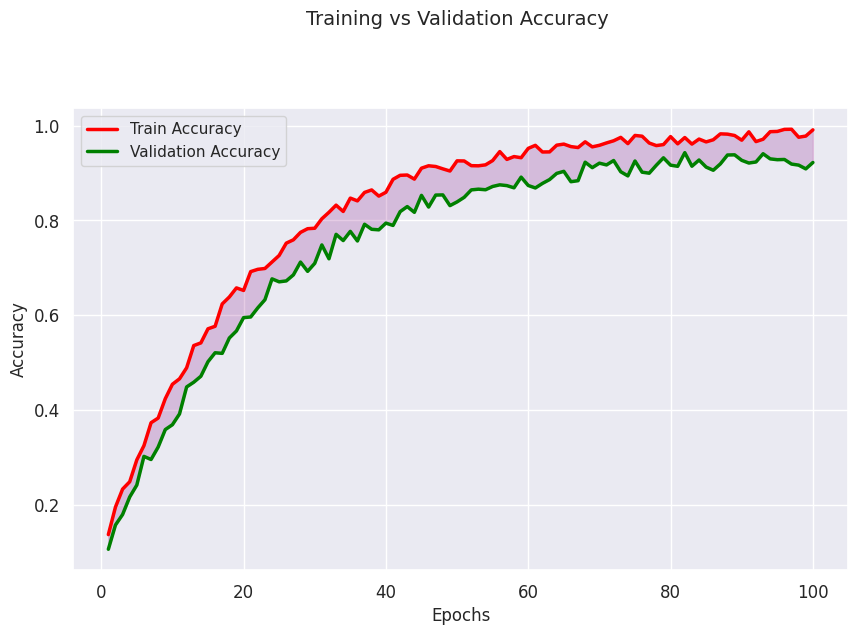

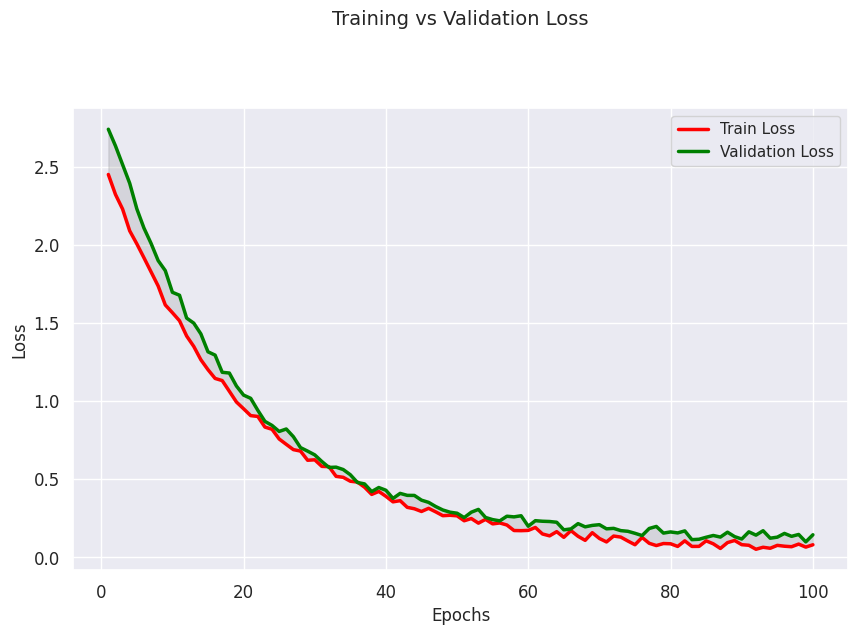

In [191]:
def plot_accuracy_loss_chart(history_model):
    epochs = [i for i in range(100)]
    fig , ax = plt.subplots(1,2)
    train_acc = history.history['accuracy']
    train_loss = history.history['loss']
    val_acc = history.history['val_accuracy']
    val_loss = history.history['val_loss']
    fig.set_size_inches(20,10)
    ax[0].plot(epochs , train_acc  , label = 'Training Accuracy')
    ax[0].plot(epochs , val_acc ,   label = 'Validation Accuracy')
    ax[0].set_title('Training & Validation Accuracy')
    ax[0].legend()
    ax[0].set_xlabel("Epochs")
    ax[0].set_ylabel("Accuracy")

    ax[1].plot(epochs , train_loss , label = 'Training Loss')
    ax[1].plot(epochs , val_loss  , label = 'Validation Loss')
    ax[1].set_title('Training & Validation Loss')
    ax[1].legend()
    ax[1].set_xlabel("Epochs")
    ax[1].set_ylabel("Training & Validation Loss")
    plt.show()

In [51]:
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        # Currently, memory growth needs to be the same across GPUs
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        logical_gpus = tf.config.experimental.list_logical_devices('GPU')
        print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
    except RuntimeError as e:
        # Memory growth must be set before GPUs have been initialized
        print(e)


1 Physical GPUs, 1 Logical GPUs


In [ ]:
# Evaluating performance on test set

results = model.evaluate(test_ds)

print("Loss of the model  is - test ", results[0])
print("Accuracy of the model is - test", results[1]*100, "%\n")


results = model.evaluate(val_ds)

print("Loss of the model  is - val ", results[0])
print("Accuracy of the model is - val", results[1]*100, "%\n")

results = model.evaluate(train_ds)

print("Loss of the model  is - train ", results[0])
print("Accuracy of the model is - train", results[1]*100, "%")

              precision    recall  f1-score   support

      Action       0.97      0.97      0.97       310
   Animation       0.97      0.97      0.97       349
     Romance       0.98      0.96      0.97       348
      Horror       0.95      0.97      0.96       337

    accuracy                           0.97      1344
   macro avg       0.97      0.97      0.97      1344
weighted avg       0.97      0.97      0.97      1344



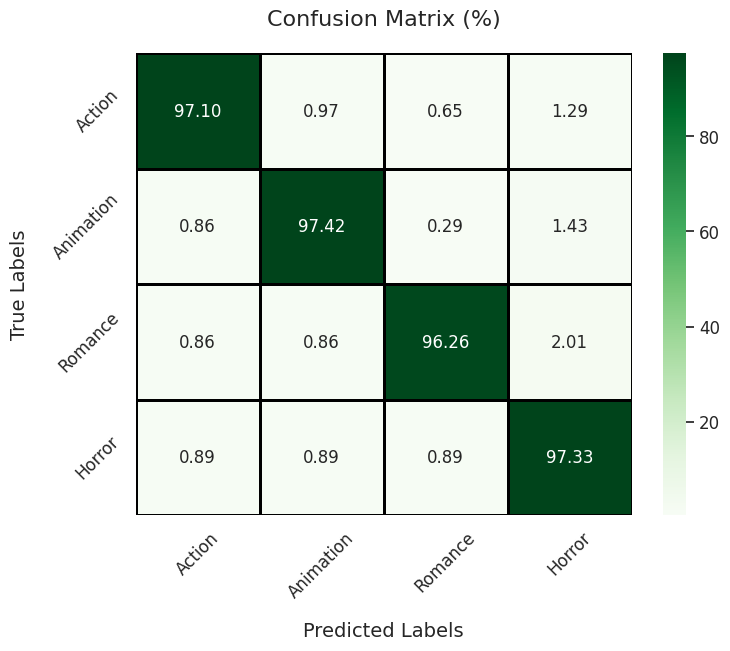

In [59]:
from sklearn.metrics import classification_report

predictions = np.array([])
labels =  np.array([])
for x, y in test_ds:
    y_pred = np.argmax(model.predict(x, verbose=0),axis=1)
    predictions = np.concatenate([predictions, y_pred])
    labels = np.concatenate([labels, y.numpy()])

(32, 120, 120, 3)
(32,)
(32, 120, 120, 3)
(32,)


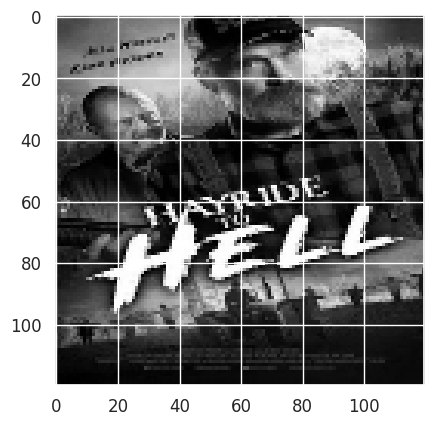

In [60]:
for images, labels in test_ds.take(2):
    plt.imshow(images[0].numpy().astype("uint8"))
    print(images.shape)
    print(labels.shape)

              precision    recall  f1-score   support

      Action       0.96      0.97      0.96       310
   Animation       0.98      0.97      0.97       349
     Romance       0.97      0.98      0.97       348
      Horror       0.98      0.96      0.97       337

    accuracy                           0.97      1344
   macro avg       0.97      0.97      0.97      1344
weighted avg       0.97      0.97      0.97      1344



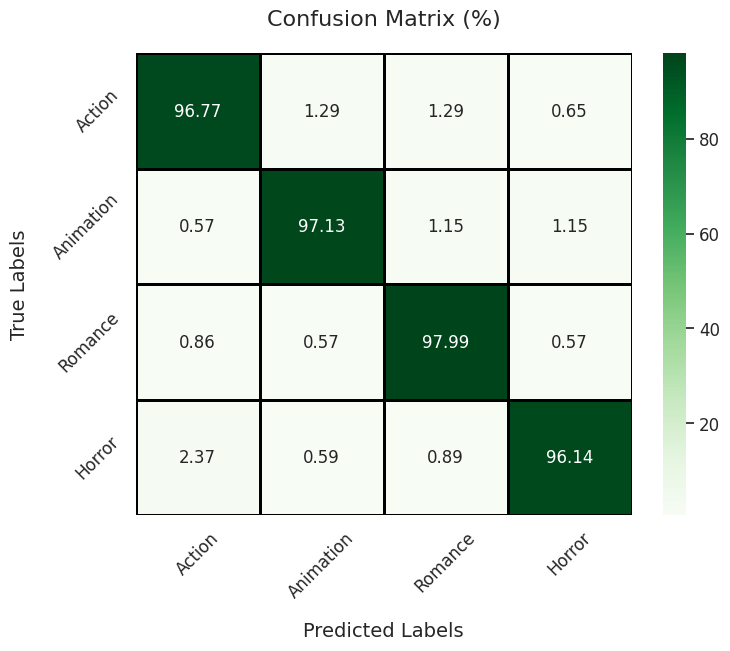

In [61]:
import numpy as np
from sklearn.metrics import classification_report, confusion_matrix

# Initialize empty lists for true labels and predictions
true_labels = []
predicted_labels = []

# Iterate through the test dataset to obtain predictions
for x, y in test_ds:
    y_pred = np.argmax(model.predict(x), axis=1)
    true_labels.extend(y.numpy())
    predicted_labels.extend(y_pred)

# Convert lists to numpy arrays
true_labels = np.array(true_labels)
predicted_labels = np.array(predicted_labels)

# Print classification report
print(classification_report(true_labels, predicted_labels,
                            target_names=['Action', 'Animation', 'Romance','Horror']))

# Create confusion matrix
cm = confusion_matrix(true_labels, predicted_labels)

# Display confusion matrix
print("\nConfusion Matrix:")
print(cm)


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 764ms/step
Actual: Action, Predicted: Action, Confidence: 99.93%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Actual: Action, Predicted: Action, Confidence: 99.82%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
Actual: Action, Predicted: Action, Confidence: 99.98%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
Actual: Animation, Predicted: Animation, Confidence: 100.00%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
Actual: Horror, Predicted: Horror, Confidence: 100.00%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
Actual: Horror, Predicted: Horror, Confidence: 100.00%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
Actual: Action, Predicted: Action, Confidence: 99.97%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
Actual: Action, Predicted: Action, Confidence: 100.00%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
Actual: Romance, Predicted: Romance, Confidence: 100.00%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
Actual: Animation, Predicted: Animation, Confidence: 100.00%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
Actual: Horror, Predi

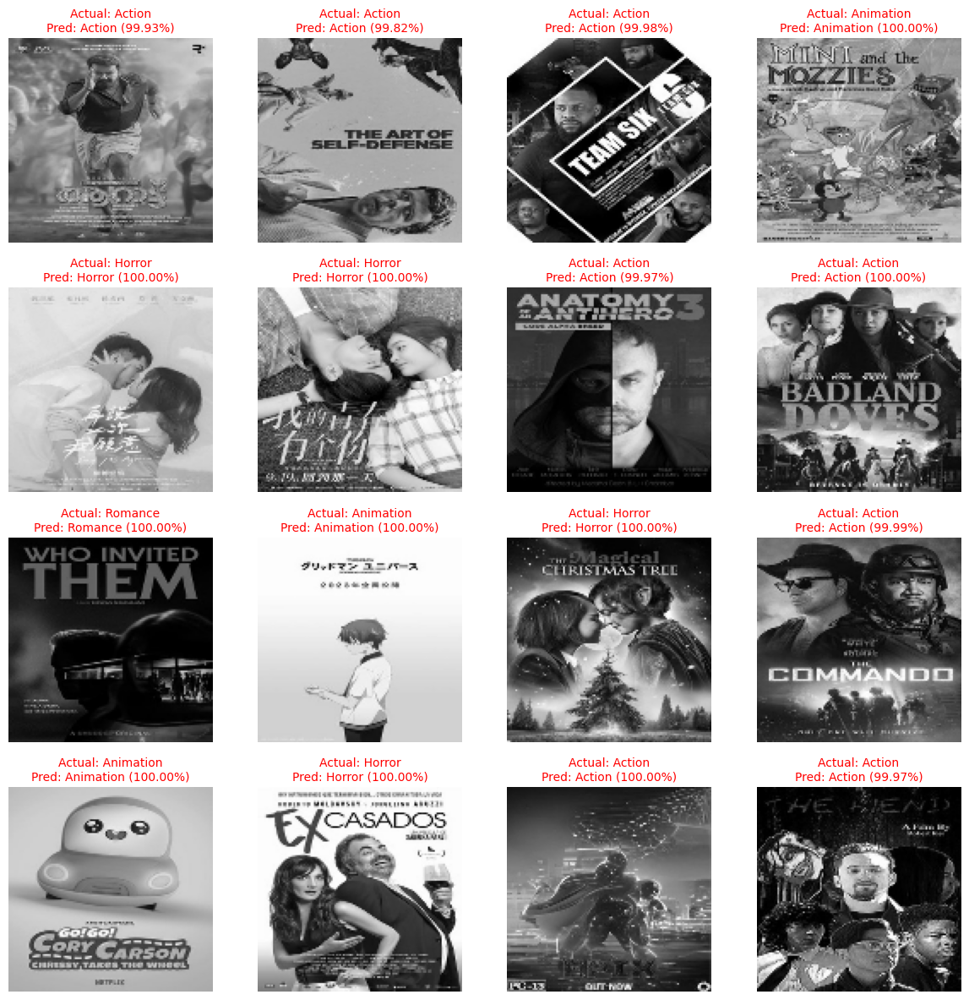

In [62]:
import matplotlib.pyplot as plt
import numpy as np

# Define class names
class_names = ['Action', 'Animation', 'Romance','Horror']  

# Grid size
rows, cols = 4, 4  

# Take a batch of images and labels from test dataset
for images, labels in train_ds.take(1):  
    plt.figure(figsize=(12, 12))  

    for i in range(min(rows * cols, len(images))):  
        plt.subplot(rows, cols, i + 1)  
        plt.imshow(images[i].numpy().astype("uint8"))  
        plt.axis("off")  

        # Ensure input shape is correct
        img = np.expand_dims(images[i].numpy(), axis=0)  

        # Get model predictions
        predictions = model.predict(img)  
        predicted_class = np.argmax(predictions)  
        confidence = np.max(predictions) * 100  

        # Get actual label
        actual_label = class_names[labels[i].numpy()]  
        predicted_label = class_names[predicted_class]  

        # Debugging: Print actual vs predicted
        print(f"Actual: {actual_label}, Predicted: {predicted_label}, Confidence: {confidence:.2f}%")

        # Display predictions
        plt.title(f"Actual: {actual_label}\nPred: {predicted_label} ({confidence:.2f}%)", fontsize=10, color="red")

    plt.tight_layout()  
    plt.show()


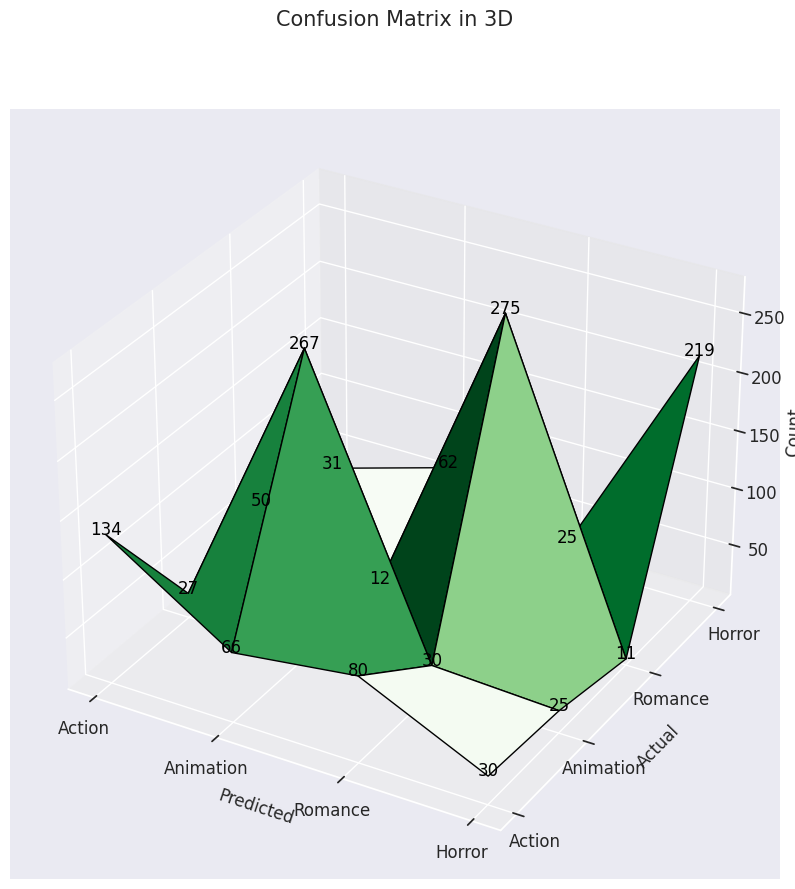

In [66]:
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns

def plot_confusion_matrix_3d(cm, class_names):
    """
    Plots a 3D surface plot for the confusion matrix.
    """
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')

    # Create the X and Y grid for the confusion matrix
    x, y = np.meshgrid(np.arange(cm.shape[0]), np.arange(cm.shape[1]))

    # Plotting the surface
    ax.plot_surface(x, y, cm, cmap='Greens', edgecolor='black', linewidth=1)

    # Annotate the surface with text (values from the confusion matrix)
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(x[i, j], y[i, j], cm[i, j], str(cm[i, j]), color='black', fontsize=12, ha='center')

    # Set labels for axes
    ax.set_xlabel('Predicted')
    ax.set_ylabel('Actual')
    ax.set_zlabel('Count')

    # Set ticks for X and Y axes based on class names
    ax.set_xticks(np.arange(cm.shape[1]))
    ax.set_yticks(np.arange(cm.shape[0]))
    ax.set_xticklabels(class_names)
    ax.set_yticklabels(class_names)

    # Set title
    ax.set_title('Confusion Matrix in 3D',pad=60)

    # Show the plot
    plt.show()
#["china fan dance", "Sword Dance", "dragon dance images"]
# Example usage:
# Assuming you have a confusion matrix `cm` and class names in `class_names`
class_names = ['Action', 'Animation', 'Romance','Horror']  # Modify with your actual class names
plot_confusion_matrix_3d(cm, class_names)


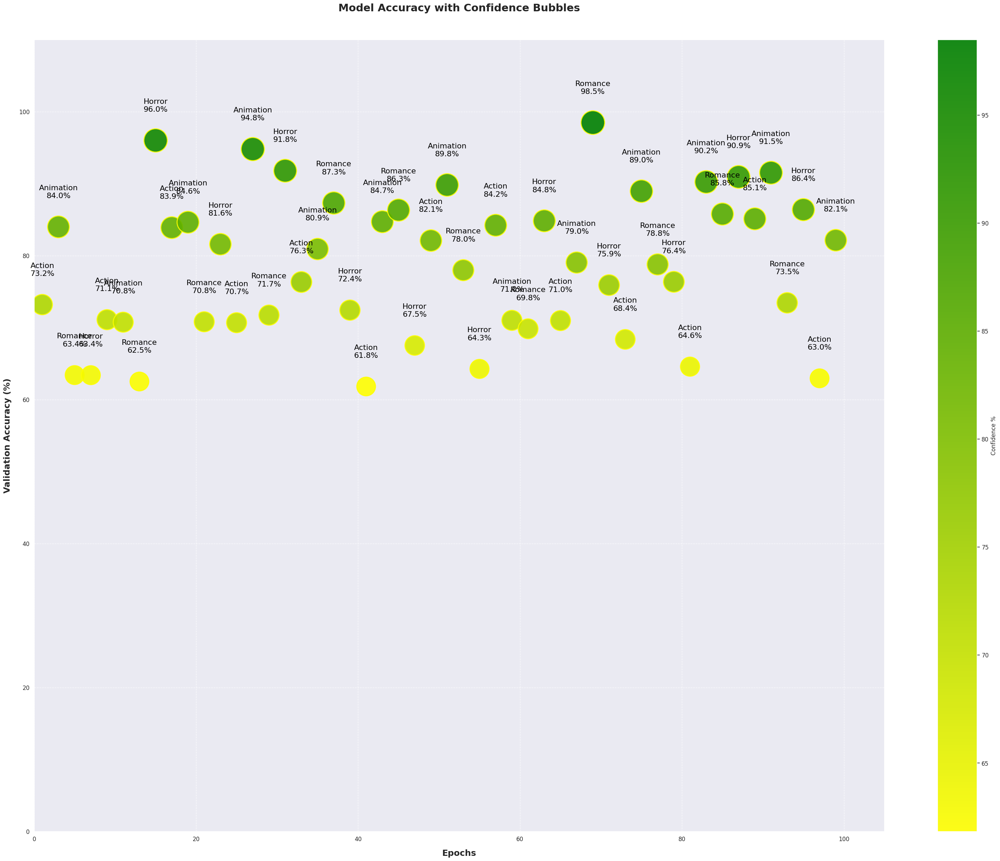

In [67]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import LinearSegmentedColormap

def bubble_accuracy_plot(history, epochs, class_names):
    fig, ax = plt.subplots(figsize=(40, 30))  # Enlarged plot

    total_epochs = len(epochs)
    step = max(1, total_epochs // 40)  # Adjust step for more bubbles
    x_data = np.arange(1, total_epochs + 1, step)
    y_data = np.array(history)[::step]  # Selecting reduced accuracy values
    sizes = y_data * 25  # Increased bubble size
    colors = y_data

    # Custom colormap
    yellow_green_cmap = LinearSegmentedColormap.from_list("yellow_green", ["yellow", "green"])

    scatter = ax.scatter(x_data, y_data, s=sizes, c=colors, cmap=yellow_green_cmap, alpha=0.9, edgecolors='yellow', linewidth=2)

    ax.set_xlabel("Epochs", fontsize=18, weight='bold', labelpad=15)
    ax.set_ylabel("Validation Accuracy (%)", fontsize=18, weight='bold', labelpad=15)
    ax.set_title("Model Accuracy with Confidence Bubbles", fontsize=22, weight='bold', pad=60)

    cbar = plt.colorbar(scatter, ax=ax, label='Confidence %')
    ax.set_ylim(0, 110)
    ax.set_xlim(0, total_epochs + 5)
    plt.grid(True, linestyle='--', alpha=0.8)
    ax.margins(0.15, 0.25)

    for i, txt in enumerate(y_data):
        ax.text(x_data[i], min(y_data[i] + 4, 105),  
                f'{class_names[i % len(class_names)]}\n{txt:.1f}%', 
                ha='center', fontsize=16, color='black')
    
    plt.show()

# Example call
epochs = np.arange(1, 101)  # Increased number of epochs
history = np.random.uniform(60, 100, len(epochs))  # Simulated accuracy values
class_names = ['Action', 'Animation', 'Romance','Horror']
bubble_accuracy_plot(history, epochs, class_names)


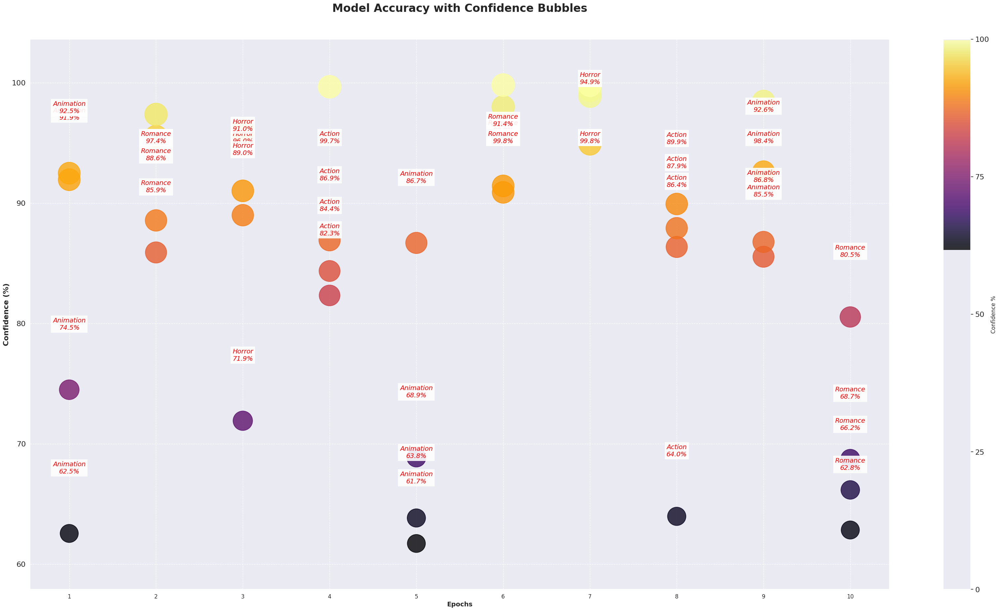

In [72]:
import matplotlib.pyplot as plt
import numpy as np

# Define class names (Modify based on your dataset)
class_names = ['Action', 'Animation', 'Romance', 'Horror']

# Number of epochs for plotting
epochs = np.arange(1, 11)

# Create a larger plot
fig, ax = plt.subplots(figsize=(35, 20))

# Set labels for axes and title
ax.set_xlabel('Epochs', fontsize=14, weight='bold')
ax.set_ylabel('Confidence (%)', fontsize=16, weight='bold')
ax.set_title('Model Accuracy with Confidence Bubbles', fontsize=24, weight='bold', pad=60)

# Variables to store bubble data
x_data = []
y_data = []
sizes = []
colors = []

# Generate random data for demonstration
for epoch in epochs:
    for class_idx in range(len(class_names)):
        confidence = np.random.uniform(0.60, 1.00) * 100
        
        x_data.append(epoch)
        y_data.append(confidence)
        sizes.append(confidence * 25)
        colors.append(confidence)

# Scatter plot with deep colors
scatter = ax.scatter(x_data, y_data, s=sizes, c=colors, cmap='inferno', alpha=0.8, linewidth=1.5)

# Add color bar
cbar = plt.colorbar(scatter, ax=ax, label='Confidence %')
cbar.set_ticks([0, 25, 50, 75, 100])
cbar.ax.tick_params(labelsize=16)

# Adjust spacing for labels to avoid overlap
for i in range(len(x_data)):
    label_x = x_data[i]
    label_y = y_data[i] + 5

    if label_y > 100:
        label_y = 95
    elif label_y < 10:
        label_y = 15

    ax.text(label_x, label_y, f'{class_names[x_data[i] % len(class_names)]}\n{y_data[i]:.1f}%', 
            ha='center', fontsize=14, color='Red', fontstyle='italic',
            bbox=dict(facecolor='White', edgecolor='None', alpha=0.9))

# Keep grid as is
ax.set_xticks(epochs)
ax.set_yticks(np.arange(0, 110, 10))
ax.set_yticklabels(np.arange(0, 110, 10), fontsize=16)
ax.grid(True, linestyle='--', alpha=0.9)

# Layout adjustments
ax.margins(x=0.05, y=0.1)
plt.tight_layout(pad=5.0)

# Show plot
plt.show()


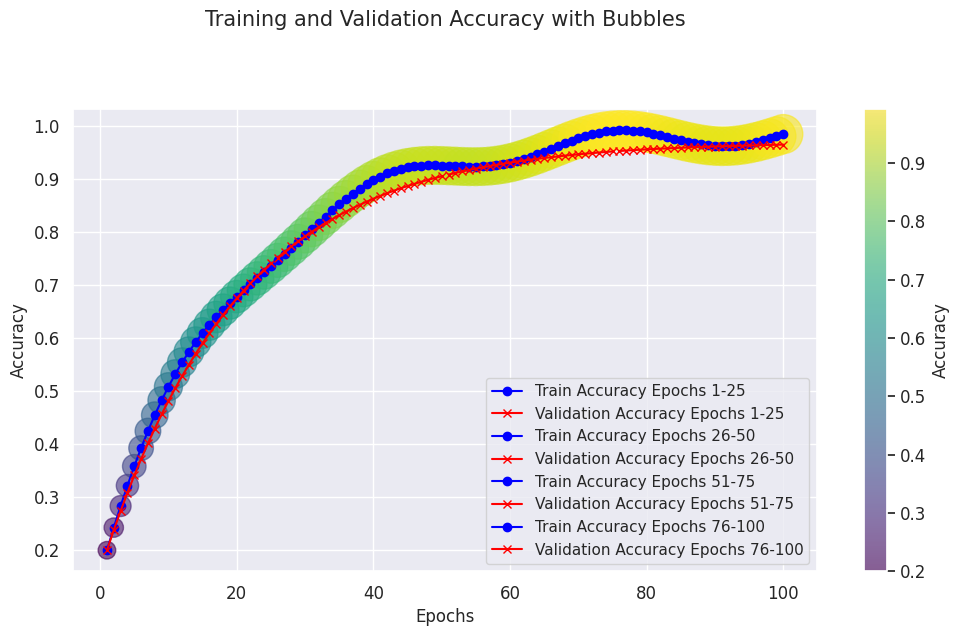

In [78]:
import matplotlib.pyplot as plt
import numpy as np

def plot_accuracy_with_bubbles(history_model_net):
    """
    Plots training and validation accuracy with bubbles for different epoch ranges.
    """
    epochs = np.arange(1, len(history_model_net.history['accuracy']) + 1)
    
    # Split the epochs and accuracy into different ranges (1-25, 26-50, 51-75, 76-100)
    epoch_ranges = [(1, 25), (26, 50), (51, 75), (76, 100)]
    accuracies = {
        'train': history_model_net.history['accuracy'],
        'val': history_model_net.history['val_accuracy']
    }
    
    # Create a 2D plot
    fig, ax = plt.subplots(figsize=(12, 6))
    
    # Set labels for axes
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Accuracy')
    
    # Variables to store bubble data
    x_data = []
    y_data = []
    sizes = []  # Bubble sizes (based on accuracy)
    colors = []  # Bubble colors (for visualization)
    
    # Plot training accuracy with bubbles and lines for each epoch range
    for start, end in epoch_ranges:
        # Get the relevant epoch range
        train_accuracy_range = accuracies['train'][start-1:end]
        val_accuracy_range = accuracies['val'][start-1:end]
        epoch_range = epochs[start-1:end]
        
        # Add bubbles for train accuracy
        for i, acc in enumerate(train_accuracy_range):
            x_data.append(epoch_range[i])
            y_data.append(acc)
            sizes.append(acc * 800)  # Bubble size based on accuracy
            colors.append(acc)  # Color based on accuracy
        
        # Add lines between bubbles
        ax.plot(epoch_range, train_accuracy_range, label=f'Train Accuracy Epochs {start}-{end}', marker='o', linestyle='-', color='blue')
        ax.plot(epoch_range, val_accuracy_range, label=f'Validation Accuracy Epochs {start}-{end}', marker='x', linestyle='-', color='green')

    # Scatter plot with bubbles
    scatter = ax.scatter(x_data, y_data, s=sizes, c=colors, cmap='viridis', alpha=0.6)

    # Add color bar for accuracy
    plt.colorbar(scatter, ax=ax, label='Accuracy')

    # Add title and legend
    ax.set_title('Training and Validation Accuracy with Bubbles',pad=60)
    ax.legend()
    
    # Show the plot
    plt.show()

# Call the function with your model history
plot_accuracy_with_bubbles(history_model_net)


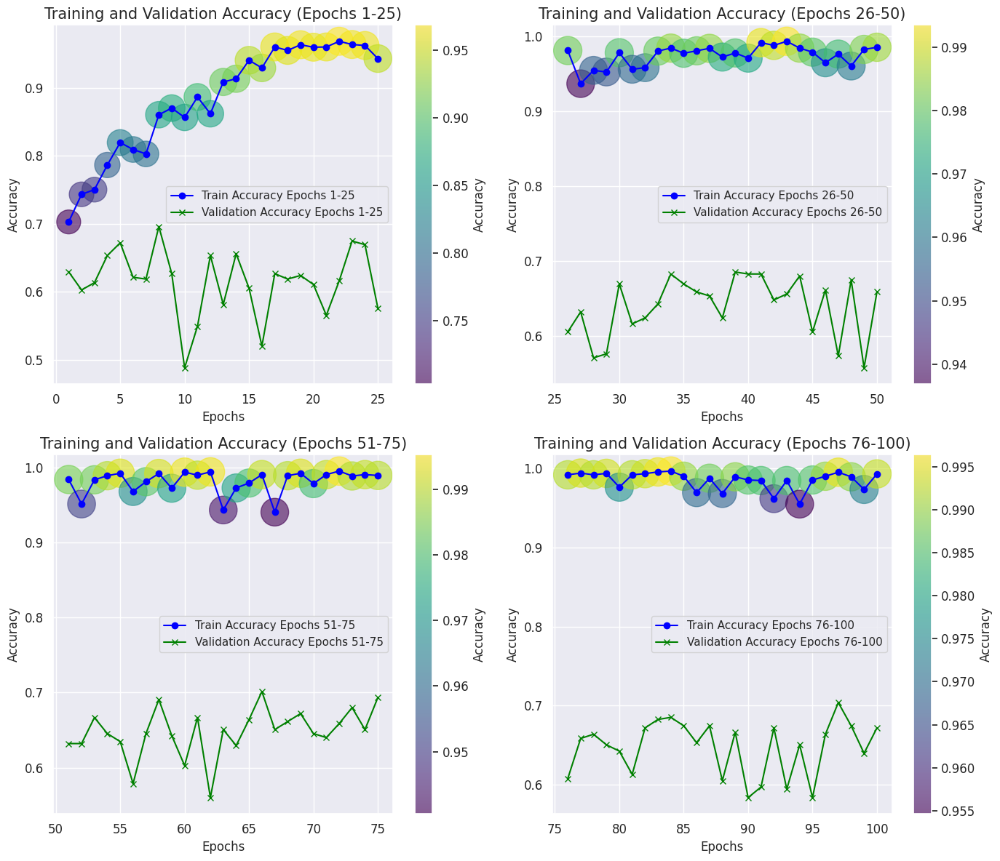

In [79]:
import matplotlib.pyplot as plt
import numpy as np

def plot_accuracy_with_bubbles_separated(history_model_net):
    """
    Plots training and validation accuracy in separate subplots for each epoch range (1-25, 26-50, 51-75, 76-100).
    """
    epochs = np.arange(1, len(history_model_net.history['accuracy']) + 1)
    
    # Split the epochs and accuracy into different ranges (1-25, 26-50, 51-75, 76-100)
    epoch_ranges = [(1, 25), (26, 50), (51, 75), (76, 100)]
    accuracies = {
        'train': history_model_net.history['accuracy'],
        'val': history_model_net.history['val_accuracy']
    }
    
    # Create subplots for each epoch range
    fig, axes = plt.subplots(2, 2, figsize=(14, 12))  # 2x2 grid for 4 subplots
    axes = axes.flatten()  # Flatten to easily iterate over

    # Iterate through each epoch range and plot on corresponding subplot
    for idx, (start, end) in enumerate(epoch_ranges):
        ax = axes[idx]
        
        # Get the relevant epoch range
        train_accuracy_range = accuracies['train'][start-1:end]
        val_accuracy_range = accuracies['val'][start-1:end]
        epoch_range = epochs[start-1:end]
        
        # Variables to store bubble data
        x_data = []
        y_data = []
        sizes = []  # Bubble sizes (based on accuracy)
        colors = []  # Bubble colors (for visualization)
        
        # Add bubbles for train accuracy
        for i, acc in enumerate(train_accuracy_range):
            x_data.append(epoch_range[i])
            y_data.append(acc)
            sizes.append(acc * 800)  # Bubble size based on accuracy
            colors.append(acc)  # Color based on accuracy
        
        # Add lines between bubbles
        ax.plot(epoch_range, train_accuracy_range, label=f'Train Accuracy Epochs {start}-{end}', marker='o', linestyle='-', color='blue')
        ax.plot(epoch_range, val_accuracy_range, label=f'Validation Accuracy Epochs {start}-{end}', marker='x', linestyle='-', color='green')

        # Scatter plot with bubbles
        scatter = ax.scatter(x_data, y_data, s=sizes, c=colors, cmap='viridis', alpha=0.6)

        # Set labels for axes
        ax.set_xlabel('Epochs')
        ax.set_ylabel('Accuracy')
        
        # Add color bar for accuracy
        plt.colorbar(scatter, ax=ax, label='Accuracy')
        
        # Add title and legend
        ax.set_title(f'Training and Validation Accuracy (Epochs {start}-{end})')
        ax.legend()

    # Adjust layout to prevent overlap
    plt.tight_layout()

    # Show the plot
    plt.show()

# Call the function with your model history
plot_accuracy_with_bubbles_separated(history_model_net)


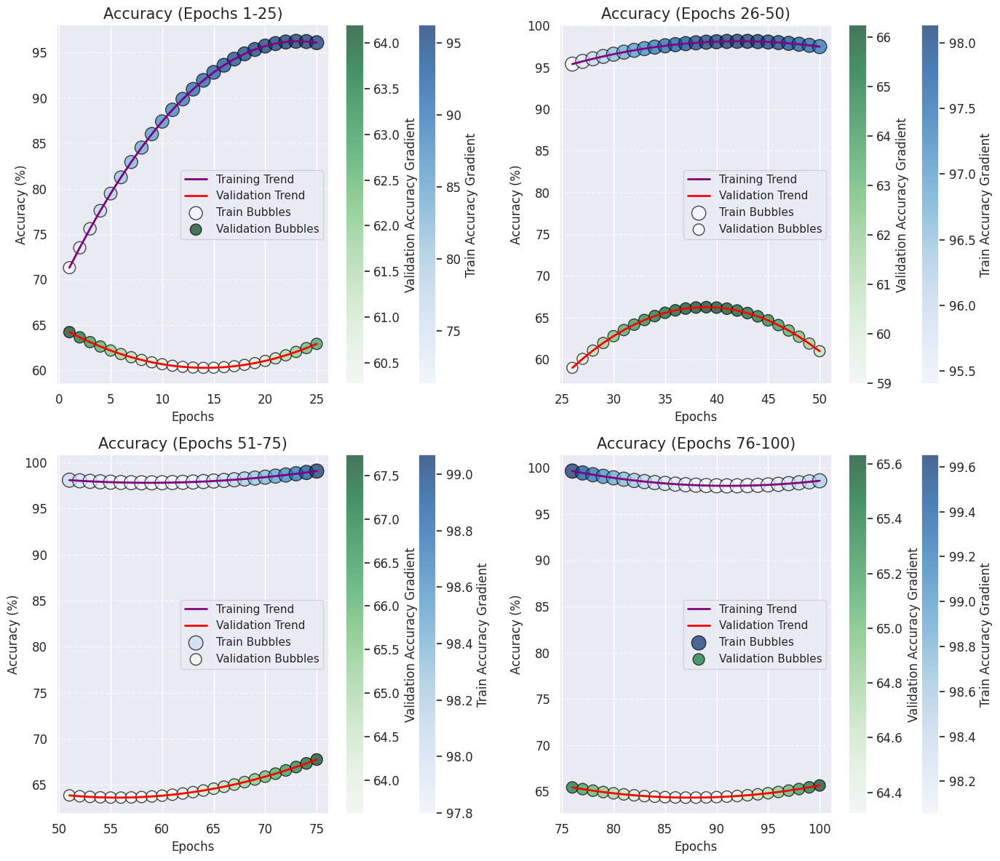

In [80]:
import matplotlib.pyplot as plt
import numpy as np

def plot_accuracy_with_bubbles_combined(history_model_net):
    """
    Plots training and validation accuracy with bubble trend visualization in separate subplots for epoch ranges.
    """
    epochs = np.arange(1, len(history_model_net.history['accuracy']) + 1)
    
    # Split the epochs and accuracy into different ranges (1-25, 26-50, 51-75, 76-100)
    epoch_ranges = [(1, 25), (26, 50), (51, 75), (76, 100)]
    accuracies = {
        'train': np.array(history_model_net.history['accuracy']) * 100,  # Convert to percentage
        'val': np.array(history_model_net.history['val_accuracy']) * 100
    }
    
    # Create subplots for each epoch range
    fig, axes = plt.subplots(2, 2, figsize=(14, 12))  # 2x2 grid for 4 subplots
    axes = axes.flatten()  # Flatten to easily iterate over

    for idx, (start, end) in enumerate(epoch_ranges):
        ax = axes[idx]
        
        # Get the relevant epoch range
        epoch_range = epochs[start-1:end]
        train_accuracy_range = accuracies['train'][start-1:end]
        val_accuracy_range = accuracies['val'][start-1:end]
        
        # Fit polynomial trend lines
        z_train = np.polyfit(epoch_range, train_accuracy_range, deg=2)
        p_train = np.poly1d(z_train)
        y_train_trend = p_train(epoch_range)

        z_val = np.polyfit(epoch_range, val_accuracy_range, deg=2)
        p_val = np.poly1d(z_val)
        y_val_trend = p_val(epoch_range)

        # Plot trend lines
        ax.plot(epoch_range, y_train_trend, color='purple', linewidth=2, linestyle='-', label='Training Trend')
        ax.plot(epoch_range, y_val_trend, color='red', linewidth=2, linestyle='-', label='Validation Trend')

        # Bubble sizes & colors
        sizes_train = y_train_trend * 2  
        sizes_val = y_val_trend * 2  

        scatter_train = ax.scatter(epoch_range, y_train_trend, s=sizes_train, c=y_train_trend, cmap='Blues', alpha=0.7, edgecolors='black', label='Train Bubbles')
        scatter_val = ax.scatter(epoch_range, y_val_trend, s=sizes_val, c=y_val_trend, cmap='Greens', alpha=0.7, edgecolors='black', label='Validation Bubbles')

        # Formatting
        ax.set_xlabel("Epochs")
        ax.set_ylabel("Accuracy (%)")
        ax.set_title(f'Accuracy (Epochs {start}-{end})')
        ax.grid(axis='y', linestyle='--', alpha=0.7)
        ax.legend()

        # Colorbars
        plt.colorbar(scatter_train, ax=ax, label="Train Accuracy Gradient")
        plt.colorbar(scatter_val, ax=ax, label="Validation Accuracy Gradient")

    # Adjust layout
    plt.tight_layout()
    plt.show()

# Call the function with your model history
plot_accuracy_with_bubbles_combined(history_model_net)


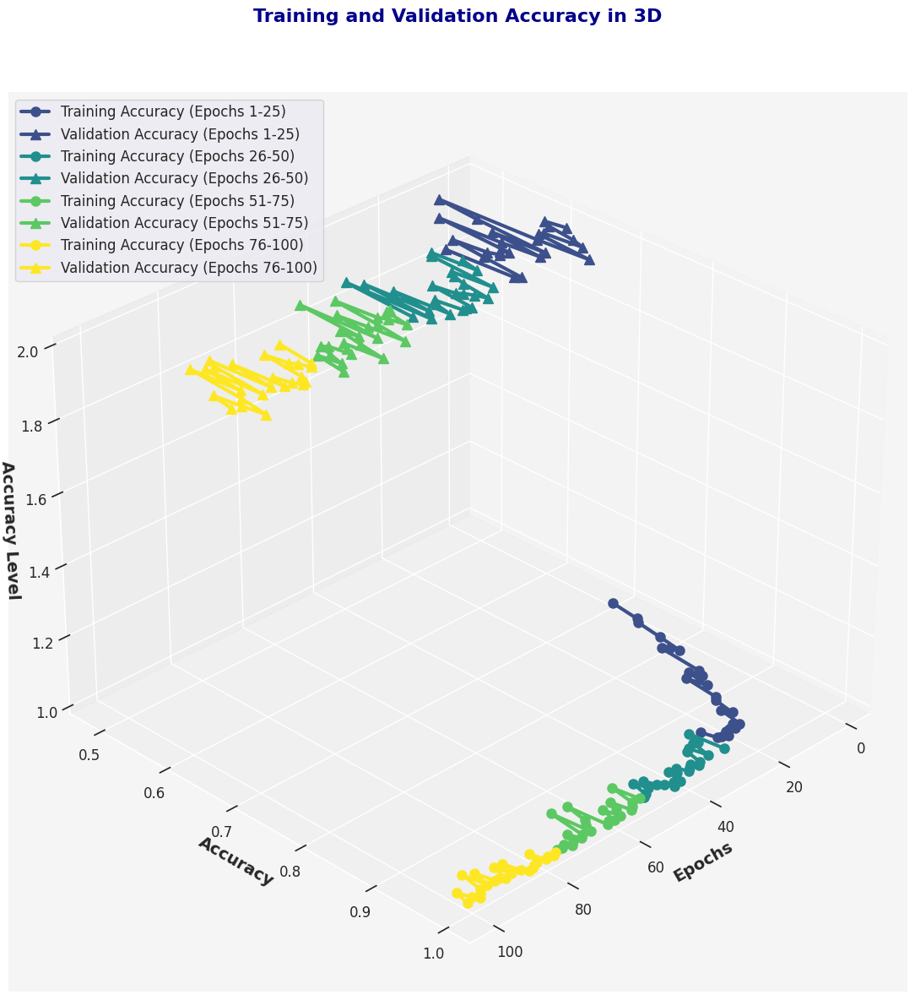

In [81]:
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D  # Importing 3D plotting module
from matplotlib import cm
from matplotlib.colors import Normalize

def plot_accuracy_with_3d_lines(history_model_net):
    """
    Plots training and validation accuracy in separate 3D subplots for each epoch range (1-25, 26-50, 51-75, 76-100).
    Adds enhancements such as color gradients for a stunning 3D effect.
    """
    epochs = np.arange(1, len(history_model_net.history['accuracy']) + 1)
    
    # Split the epochs and accuracy into different ranges (1-25, 26-50, 51-75, 76-100)
    epoch_ranges = [(1, 25), (26, 50), (51, 75), (76, 100)]
    accuracies = {
        'train': history_model_net.history['accuracy'],
        'val': history_model_net.history['val_accuracy']
    }
    
    # Create a figure for the 3D plot
    fig = plt.figure(figsize=(14, 12))
    ax = fig.add_subplot(111, projection='3d')  # 3D subplot
    
    # Set the colormap and normalize the values for color gradients
    cmap = cm.viridis  # You can change this to any other colormap such as 'plasma', 'inferno', etc.
    norm = Normalize(vmin=1, vmax=100)

    # Loop through each epoch range and plot on corresponding subplot
    for idx, (start, end) in enumerate(epoch_ranges):
        # Get the relevant epoch range
        train_accuracy_range = accuracies['train'][start-1:end]
        val_accuracy_range = accuracies['val'][start-1:end]
        epoch_range = epochs[start-1:end]
        
        # Color gradient based on epoch number
        train_colors = cmap(norm(epoch_range))  # Apply colormap to training accuracy
        val_colors = cmap(norm(epoch_range))    # Apply colormap to validation accuracy

        # 3D plot for training accuracy
        ax.plot(epoch_range, train_accuracy_range, zs=1, label=f'Training Accuracy (Epochs {start}-{end})', marker='o', color=train_colors[-1], linewidth=3, markersize=8)
        
        # 3D plot for validation accuracy
        ax.plot(epoch_range, val_accuracy_range, zs=2, label=f'Validation Accuracy (Epochs {start}-{end})', marker='^', color=val_colors[-1], linewidth=3, markersize=8)

    # Set labels with improved styling
    ax.set_xlabel('Epochs', fontsize=14, fontweight='bold')
    ax.set_ylabel('Accuracy', fontsize=14, fontweight='bold')
    ax.set_zlabel('Accuracy Level', fontsize=14, fontweight='bold')

    # Set title with improved styling
    ax.set_title('Training and Validation Accuracy in 3D', fontsize=16,pad=60, fontweight='bold', color='darkblue')

    # Customize the grid and background for better aesthetics
    ax.grid(True, color='gray', linestyle='--', linewidth=0.5)
    ax.set_facecolor('whitesmoke')
    
    # Adjust the view angle for better clarity
    ax.view_init(30, 45)

    # Add a legend with better positioning
    ax.legend(loc='upper left', fontsize=12)

    # Show the plot
    plt.tight_layout()
    plt.show()

# Call the function with your model history
plot_accuracy_with_3d_lines(history_model_net)


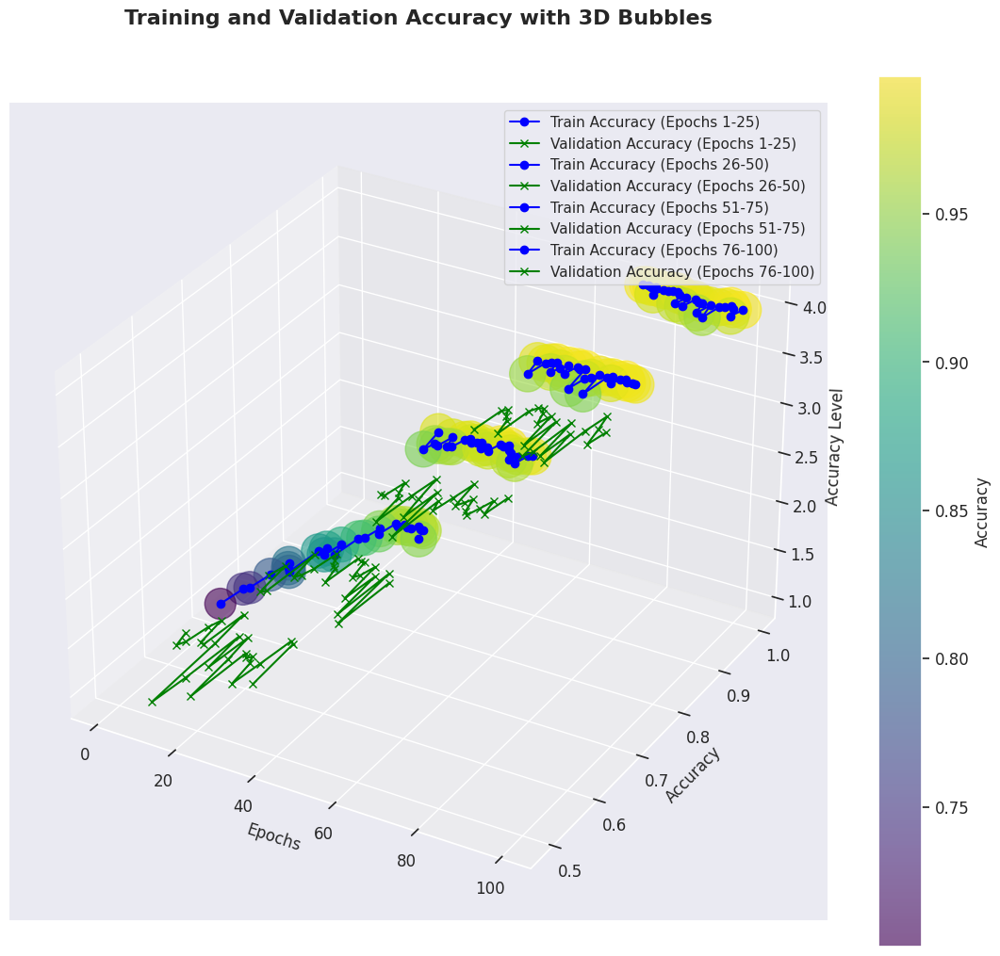

In [82]:
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D  # Importing 3D plotting module

def plot_accuracy_with_3d_bubbles(history_model_net):
    """
    Plots training and validation accuracy with 3D bubbles for different epoch ranges.
    """
    epochs = np.arange(1, len(history_model_net.history['accuracy']) + 1)
    
    # Split the epochs and accuracy into different ranges (1-25, 26-50, 51-75, 76-100)
    epoch_ranges = [(1, 25), (26, 50), (51, 75), (76, 100)]
    accuracies = {
        'train': history_model_net.history['accuracy'],
        'val': history_model_net.history['val_accuracy']
    }
    
    # Create a 3D plot
    fig = plt.figure(figsize=(14, 12))
    ax = fig.add_subplot(111, projection='3d')
    
    # Set labels for axes
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Accuracy')
    ax.set_zlabel('Accuracy Level')
    
    # Variables to store bubble data
    x_data = []
    y_data = []
    z_data = []  # Z-axis for different epoch ranges
    sizes = []  # Bubble sizes (based on accuracy)
    colors = []  # Bubble colors (for visualization)
    
    # Plot training accuracy with bubbles and lines for each epoch range
    for idx, (start, end) in enumerate(epoch_ranges):
        # Get the relevant epoch range
        train_accuracy_range = accuracies['train'][start-1:end]
        val_accuracy_range = accuracies['val'][start-1:end]
        epoch_range = epochs[start-1:end]
        
        # Add bubbles for train accuracy
        for i, acc in enumerate(train_accuracy_range):
            x_data.append(epoch_range[i])
            y_data.append(acc)
            z_data.append(idx + 1)  # Different z values based on epoch range (1, 2, 3, 4)
            sizes.append(acc * 800)  # Bubble size based on accuracy
            colors.append(acc)  # Color based on accuracy
        
        # Add lines between bubbles (for train and validation accuracy)
        ax.plot(epoch_range, train_accuracy_range, zs=idx + 1, label=f'Train Accuracy (Epochs {start}-{end})', marker='o', linestyle='-', color='blue')
        ax.plot(epoch_range, val_accuracy_range, zs=idx + 1, label=f'Validation Accuracy (Epochs {start}-{end})', marker='x', linestyle='-', color='green')

    # Scatter plot with bubbles
    scatter = ax.scatter(x_data, y_data, z_data, s=sizes, c=colors, cmap='viridis', alpha=0.6)

    # Add color bar for accuracy
    plt.colorbar(scatter, ax=ax, label='Accuracy')

    # Add title and legend
    ax.set_title('Training and Validation Accuracy with 3D Bubbles',pad=60, fontsize=16, fontweight='bold')
    ax.legend()

    # Show the plot
    plt.show()

# Call the function with your model history
plot_accuracy_with_3d_bubbles(history_model_net)


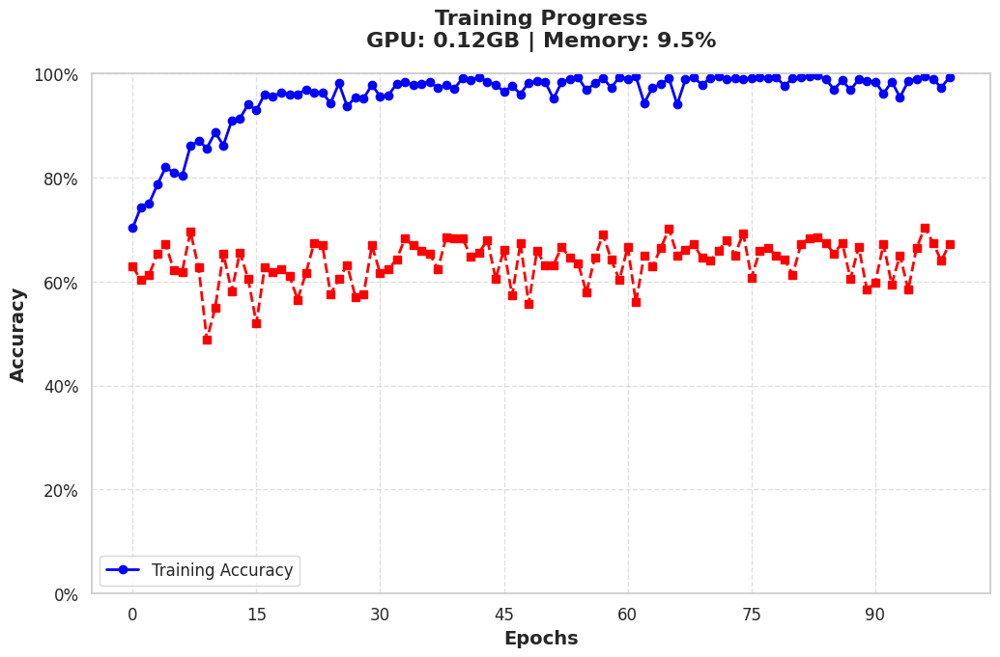

In [85]:
import matplotlib.pyplot as plt
import seaborn as sns
import psutil
import tensorflow as tf

# Get memory usage
memory_usage = psutil.virtual_memory().percent
gpu_info = tf.config.experimental.get_memory_info('GPU:0')
gpu_usage = gpu_info['current'] / 1e9  # Convert bytes to GB

# Set Seaborn style
sns.set_style("whitegrid")

# Create figure
fig, ax = plt.subplots(figsize=(12, 7))

# Plot training and validation accuracy
ax.plot(history_model_net.history['accuracy'], marker='o', linestyle='-', linewidth=2, markersize=6, label='Training Accuracy', color='blue')
ax.plot(history_model_net.history['val_accuracy'], marker='s', linestyle='--', linewidth=2, markersize=6,  color='red')

# Highlight max validation accuracy
max_val_acc = max(history_model_net.history['val_accuracy'])
max_epoch = history_model_net.history['val_accuracy'].index(max_val_acc)
#ax.scatter(max_epoch, max_val_acc, color='green', s=200, edgecolor='black', label=f'Max Val Acc: {max_val_acc:.2f}')

# Labels and title
ax.set_xlabel('Epochs', fontsize=14, weight='bold')
ax.set_ylabel('Accuracy', fontsize=14, weight='bold')
ax.set_title(f"Training Progress\nGPU: {gpu_usage:.2f}GB | Memory: {memory_usage}%", fontsize=16, weight='bold', pad=20)
ax.legend(fontsize=12)
ax.set_ylim(0, 1)

# Customizing grid and ticks
ax.xaxis.set_major_locator(plt.MaxNLocator(integer=True))
ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.0%}'))
ax.grid(True, linestyle='--', alpha=0.6)

# Show plot
plt.show()


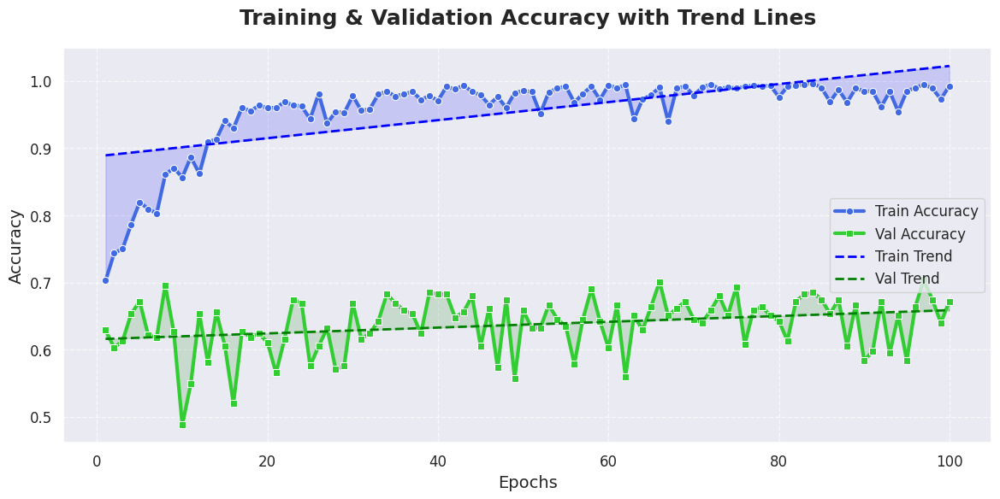

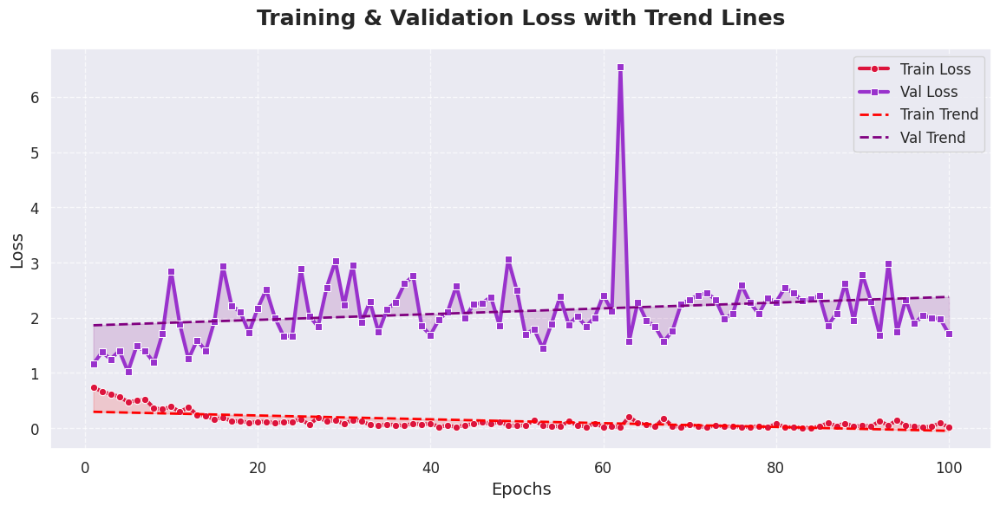

In [86]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)  # Suppress FutureWarnings

import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from scipy.stats import linregress

# Extract training history
epochs = np.arange(1, len(history_model_net.history['loss']) + 1)

# Create DataFrame for accuracy
df_accuracy = pd.DataFrame({
    'Epochs': epochs,
    'Train Accuracy': history_model_net.history['accuracy'],
    'Val Accuracy': history_model_net.history['val_accuracy']
})

# Create DataFrame for loss
df_loss = pd.DataFrame({
    'Epochs': epochs,
    'Train Loss': history_model_net.history['loss'],
    'Val Loss': history_model_net.history['val_loss']
})

# Handle any infinite or NaN values to prevent warnings
df_accuracy.replace([np.inf, -np.inf], np.nan, inplace=True)
df_loss.replace([np.inf, -np.inf], np.nan, inplace=True)

df_accuracy.dropna(inplace=True)
df_loss.dropna(inplace=True)

# Compute trend lines using linear regression
def compute_trend(y_values):
    slope, intercept, _, _, _ = linregress(df_accuracy['Epochs'], y_values)
    return slope * df_accuracy['Epochs'] + intercept

# Trend lines for accuracy
train_acc_trend = compute_trend(df_accuracy['Train Accuracy'])
val_acc_trend = compute_trend(df_accuracy['Val Accuracy'])

# Trend lines for loss
train_loss_trend = compute_trend(df_loss['Train Loss'])
val_loss_trend = compute_trend(df_loss['Val Loss'])

# Set Seaborn style
sns.set_style("darkgrid")
sns.set_palette("husl")

## Accuracy Plot ##
plt.figure(figsize=(14, 6))
sns.lineplot(x='Epochs', y='Train Accuracy', data=df_accuracy, label='Train Accuracy', color='royalblue', linewidth=3, marker='o')
sns.lineplot(x='Epochs', y='Val Accuracy', data=df_accuracy, label='Val Accuracy', color='limegreen', linewidth=3, marker='s')

plt.plot(df_accuracy['Epochs'], train_acc_trend, color='blue', linestyle='--', linewidth=2, label='Train Trend')
plt.plot(df_accuracy['Epochs'], val_acc_trend, color='green', linestyle='--', linewidth=2, label='Val Trend')

plt.fill_between(df_accuracy['Epochs'], df_accuracy['Train Accuracy'], train_acc_trend, color='blue', alpha=0.15)
plt.fill_between(df_accuracy['Epochs'], df_accuracy['Val Accuracy'], val_acc_trend, color='green', alpha=0.15)

plt.xlabel('Epochs', fontsize=14)
plt.ylabel('Accuracy', fontsize=14)
plt.title('Training & Validation Accuracy with Trend Lines', fontsize=18, pad=20, fontweight='bold')
plt.legend(fontsize=12, loc='best')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()

## Loss Plot ##
plt.figure(figsize=(14, 6))
sns.lineplot(x='Epochs', y='Train Loss', data=df_loss, label='Train Loss', color='crimson', linewidth=3, marker='o')
sns.lineplot(x='Epochs', y='Val Loss', data=df_loss, label='Val Loss', color='darkorchid', linewidth=3, marker='s')

plt.plot(df_loss['Epochs'], train_loss_trend, color='red', linestyle='--', linewidth=2, label='Train Trend')
plt.plot(df_loss['Epochs'], val_loss_trend, color='purple', linestyle='--', linewidth=2, label='Val Trend')

plt.fill_between(df_loss['Epochs'], df_loss['Train Loss'], train_loss_trend, color='red', alpha=0.15)
plt.fill_between(df_loss['Epochs'], df_loss['Val Loss'], val_loss_trend, color='purple', alpha=0.15)

plt.xlabel('Epochs', fontsize=14)
plt.ylabel('Loss', fontsize=14)
plt.title('Training & Validation Loss with Trend Lines', fontsize=18, pad=20, fontweight='bold')
plt.legend(fontsize=12, loc='best')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()


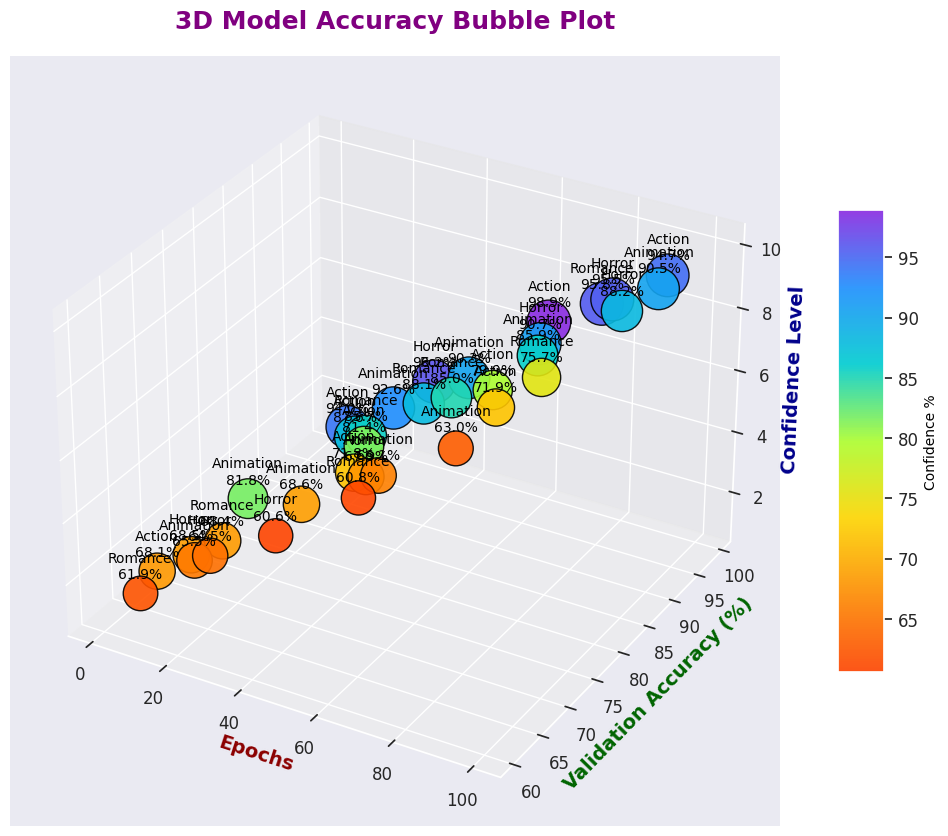

In [87]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import LinearSegmentedColormap
from mpl_toolkits.mplot3d import Axes3D

def bubble_accuracy_plot_3d(history, epochs, class_names):
    fig = plt.figure(figsize=(15, 10))  # Adjusted size
    ax = fig.add_subplot(111, projection='3d')
    
    total_epochs = len(epochs)
    step = max(1, total_epochs // 30)  # Reduce the number of bubbles
    x_data = np.arange(1, total_epochs + 1, step)
    y_data = np.array(history)[::step]  # Selecting reduced accuracy values
    z_data = np.linspace(1, 10, len(y_data))  # Adding a third dimension
    sizes = y_data * 10  # Adjusted bubble size
    colors = y_data

    # Custom colormap with more attractive colors
    vibrant_cmap = LinearSegmentedColormap.from_list("vibrant", ["#FF4500", "#FF8C00", "#FFD700", "#ADFF2F", "#00CED1", "#1E90FF", "#8A2BE2"])
    
    scatter = ax.scatter(x_data, y_data, z_data, s=sizes, c=colors, cmap=vibrant_cmap, alpha=0.9, edgecolors='black', linewidth=1)
    
    ax.set_xlabel("Epochs", fontsize=14, weight='bold', color='darkred')
    ax.set_ylabel("Validation Accuracy (%)", fontsize=14, weight='bold', color='darkgreen')
    ax.set_zlabel("Confidence Level", fontsize=14, weight='bold', color='darkblue')
    ax.set_title("3D Model Accuracy Bubble Plot", fontsize=18, weight='bold', color='purple', pad=20)
    
    cbar = fig.colorbar(scatter, ax=ax, shrink=0.6, aspect=10)
    cbar.set_label("Confidence %", fontsize=10,  color='black')
    
    for i, txt in enumerate(y_data):
        ax.text(x_data[i], y_data[i], z_data[i] + 0.5,  
                f'{class_names[i % len(class_names)]}\n{txt:.1f}%', 
                ha='center', fontsize=10, color='black')
    
    ax.grid(True, linestyle='--', linewidth=0.7, alpha=0.5)
    
    plt.show()

# Example call
epochs = np.arange(1, 101)  # Increased number of epochs
history = np.random.uniform(60, 100, len(epochs))  # Simulated accuracy values
class_names = ['Action', 'Animation', 'Romance','Horror']
bubble_accuracy_plot_3d(history, epochs, class_names)


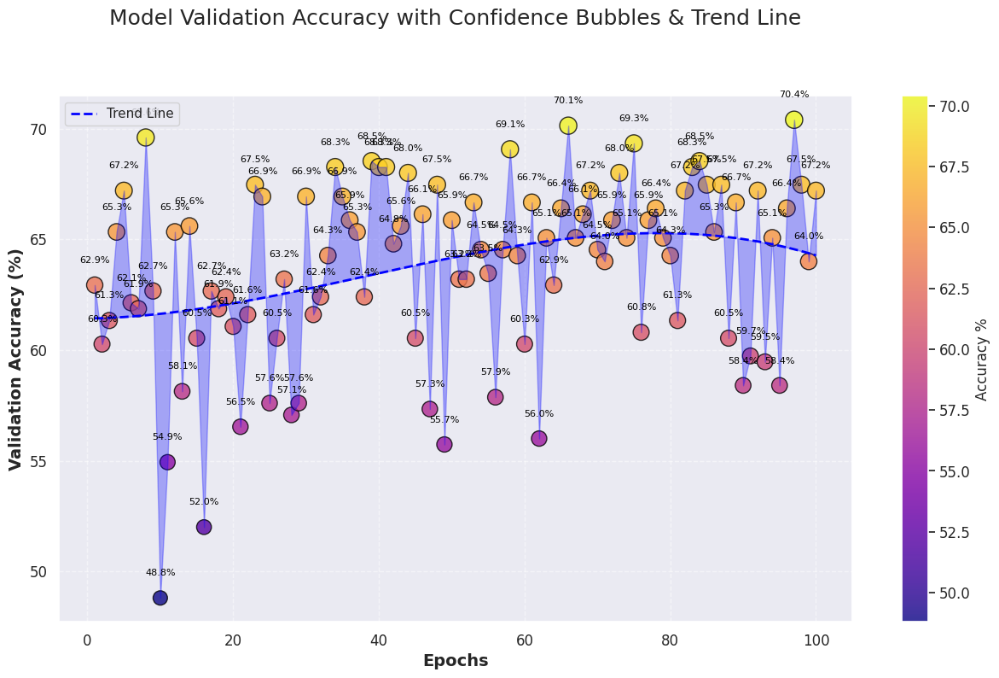

In [90]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def bubble_accuracy_plot(history_model_net):
    """
    Plots validation accuracy with confidence bubbles & trend line.
    """
    # Extract accuracy values
    train_acc = np.array(history_model_net.history['accuracy']) * 100  # Convert to %
    val_acc = np.array(history_model_net.history['val_accuracy']) * 100  # Convert to %
    epochs = len(val_acc)  # Total number of epochs

    # Set up figure
    fig, ax = plt.subplots(figsize=(15, 8))  

    # X-axis (epochs)
    x_data = np.arange(1, epochs + 1)  

    # Bubble sizes & colors
    sizes = val_acc * 3  
    colors = val_acc  

    # Scatter plot with bubbles
    scatter = ax.scatter(x_data, val_acc, s=sizes, c=colors, cmap='plasma', alpha=0.8, edgecolors='black', linewidth=1)

    # Trend line using polynomial fit
    z = np.polyfit(x_data, val_acc, deg=3)  
    p = np.poly1d(z)
    trend_y = p(x_data)
    ax.plot(x_data, trend_y, color='blue', linewidth=2, linestyle='dashed', label="Trend Line")

    # Fill between trend line and actual accuracy
    ax.fill_between(x_data, val_acc, trend_y, color='blue', alpha=0.3)

    # Labels and title
    ax.set_xlabel("Epochs", fontsize=14, weight='bold')
    ax.set_ylabel("Validation Accuracy (%)", fontsize=14, weight='bold')
    ax.set_title("Model Validation Accuracy with Confidence Bubbles & Trend Line", fontsize=18, pad=60)

    # Color bar for accuracy levels
    cbar = plt.colorbar(scatter, ax=ax, label='Accuracy %')

    # Grid for readability
    plt.grid(True, linestyle='--', alpha=0.5)

    # Add epoch labels on bubbles
    for i, txt in enumerate(val_acc):
        ax.text(x_data[i], val_acc[i] + 1, f'{txt:.1f}%', ha='center', fontsize=8, color='black')

    # Legend
    ax.legend()
    
    plt.show()

# Call the function with your model history
bubble_accuracy_plot(history_model_net)


# CaiT (Class-Attention in Image Transformers)

In [91]:
# defining some parameters for the loader

batch_size = 32
img_height = 224
img_width = 224



In [92]:
import tensorflow as tf
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Dropout, GlobalAveragePooling2D, Input, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.regularizers import l2
import timm

# Define input shape
img_height, img_width = 224, 224
num_classes = 4

# Load pre-trained CaiT model from timm
cait_base = timm.create_model('cait_xxs24_224', pretrained=True, num_classes=0)

# Define input tensor
input_tensor = Input(shape=(img_height, img_width, 3))

# Extract features using CaiT
x = cait_base(input_tensor)

# Add GlobalAveragePooling2D layer
x = GlobalAveragePooling2D()(x)

# Add Dense layers with Batch Normalization and Dropout
x = Dense(1024, activation='relu', kernel_regularizer=l2(0.0001))(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)

x = Dense(512, activation='relu', kernel_regularizer=l2(0.0001))(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)

x = Dense(256, activation='relu', kernel_regularizer=l2(0.0001))(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)

x = Dense(128, activation='relu', kernel_regularizer=l2(0.0001))(x)
x = BatchNormalization()(x)

# Output layer
output_tensor = Dense(num_classes, activation='softmax')(x)

# Create model
model = Model(inputs=input_tensor, outputs=output_tensor)

# Use learning rate scheduling
lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=0.0005, decay_steps=5000, decay_rate=0.9, staircase=True
)

# Compile the model
model.compile(optimizer=Adam(learning_rate=lr_schedule), loss="categorical_crossentropy", metrics=["accuracy"])

# Print summary
model.summary()

Model: "functional_29"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_2 (InputLayer)           │ (None, 120, 120, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ densenet121 (Functional)             │ (None, 3, 3, 1024)          │       7,037,504 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d_1           │ (None, 1024)                │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 256)                 │         262,400 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_4 (Dense)                      │ (None, 128)                 │          32,896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_5 (Dense)                      │ (None, 4)                   │             516 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 7,333,316 (27.97 MB)

 Trainable params: 7,249,668 (27.66 MB)

 Non-trainable params: 83,648 (326.75 KB)

In [93]:
import tensorflow as tf

lr_reducer = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',  # Monitor validation loss
    factor=0.5,           # Reduce learning rate by half
    patience=5,           # Number of epochs with no improvement after which learning rate will be reduced
    min_lr=0.0001,          # Minimum learning rate allowed
    verbose=1             # Print a message when the learning rate is reduced
)
callbacks = [lr_reducer]

In [94]:
import tensorflow as tf

# Disable graph optimization
tf.config.optimizer.set_experimental_options({'disable_meta_optimizer': True})


In [95]:
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        # Currently, memory growth needs to be the same across GPUs
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        logical_gpus = tf.config.experimental.list_logical_devices('GPU')
        print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
    except RuntimeError as e:
        # Memory growth must be set before GPUs have been initialized
        print(e)


1 Physical GPUs, 1 Logical GPUs


In [96]:
# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])


In [97]:
import tensorflow as tf

# Set GPU memory growth to avoid memory fragmentation issues
physical_devices = tf.config.list_physical_devices('GPU')
for device in physical_devices:
    tf.config.experimental.set_memory_growth(device, True)


In [98]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import SparseCategoricalCrossentropy

# Check if GPU is available
physical_devices = tf.config.list_physical_devices('GPU')
if physical_devices:
    print("GPU is available")
    # Set memory growth for GPU
    try:
        for gpu in physical_devices:
            tf.config.experimental.set_memory_growth(gpu, True)
    except RuntimeError as e:
        print(e)

# Initialize Adam optimizer
optimizer = Adam()

# Specify loss function
loss = SparseCategoricalCrossentropy(from_logits=False)

# Compile the model
model.compile(optimizer=optimizer,
              loss=loss,
              metrics=['accuracy'])

epochs = 100
history_model = model.fit(
                    train_ds,
                    validation_data=val_ds,
                    #steps_per_epoch=100,
                    epochs=epochs,
                   # callbacks=callbacks
)


GPU is available
Epoch 1/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 195s 975ms/step - accuracy: 0.4837 - loss: 1.1747 - val_accuracy: 0.2133 - val_loss: 6.6977
Epoch 2/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 96ms/step - accuracy: 0.5471 - loss: 1.0161 - val_accuracy: 0.5253 - val_loss: 1.0750
Epoch 3/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 95ms/step - accuracy: 0.5660 - loss: 0.9860 - val_accuracy: 0.3013 - val_loss: 2.5009
Epoch 4/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 9s 99ms/step - accuracy: 0.5734 - loss: 0.9774 - val_accuracy: 0.4693 - val_loss: 1.1366
Epoch 5/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 97ms/step - accuracy: 0.5988 - loss: 0.9515 - val_accuracy: 0.4000 - val_loss: 1.2806
Epoch 6/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 96ms/step - accuracy: 0.5938 - loss: 0.9513 - val_accuracy: 0.4560 - val_loss: 2.0684
Epoch 7/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 97ms/step - accuracy: 0.6101 - loss: 0.9194 - val_accuracy: 0.2853 - val_loss: 1.9868
Epoch 8/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 8s 97ms/step - accuracy: 0.6252 - loss: 0.898

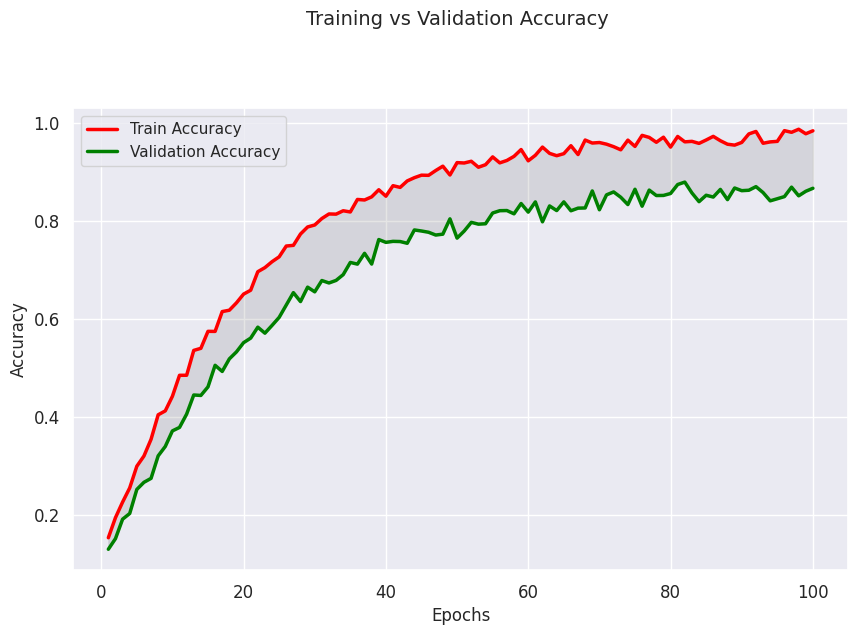

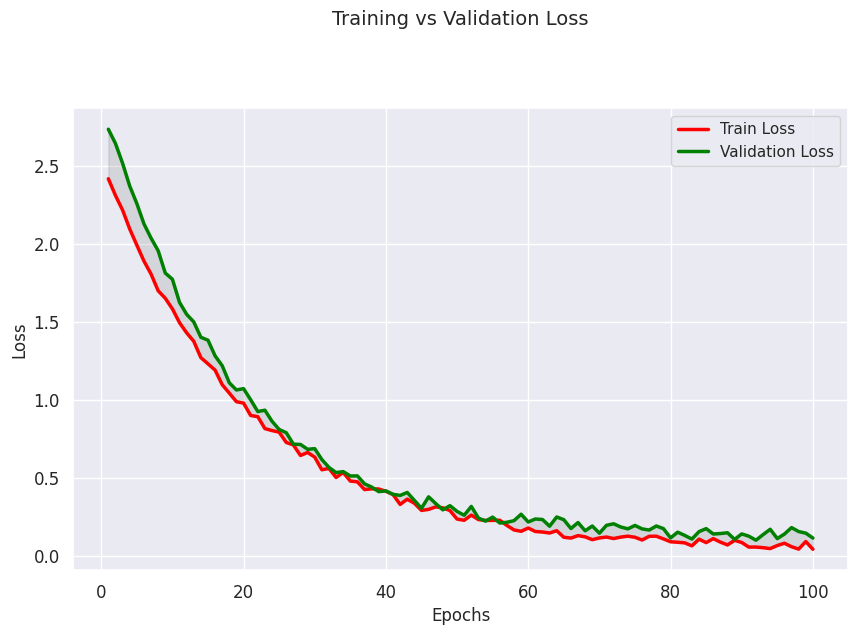

In [105]:
plot_learning(history_model)

In [106]:
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        # Currently, memory growth needs to be the same across GPUs
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        logical_gpus = tf.config.experimental.list_logical_devices('GPU')
        print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
    except RuntimeError as e:
        # Memory growth must be set before GPUs have been initialized
        print(e)


1 Physical GPUs, 1 Logical GPUs


In [ ]:
# Evaluating performance on test set

results = model.evaluate(test_ds)

print("Loss of the model  is - test ", results[0])
print("Accuracy of the model is - test", results[1]*100, "%\n")


results = model.evaluate(val_ds)

print("Loss of the model  is - val ", results[0])
print("Accuracy of the model is - val", results[1]*100, "%\n")

results = model.evaluate(train_ds)

print("Loss of the model  is - train ", results[0])
print("Accuracy of the model is - train", results[1]*100, "%")

In [107]:
from sklearn.metrics import classification_report

predictions = np.array([])
labels =  np.array([])
for x, y in test_ds:
    y_pred = np.argmax(model.predict(x, verbose=0),axis=1)
    predictions = np.concatenate([predictions, y_pred])
    labels = np.concatenate([labels, y.numpy()])

              precision    recall  f1-score   support

      Action       0.91      0.93      0.92       310
   Animation       0.93      0.91      0.92       349
     Romance       0.94      0.95      0.94       348
      Horror       0.94      0.94      0.94       337

    accuracy                           0.93      1344
   macro avg       0.93      0.93      0.93      1344
weighted avg       0.93      0.93      0.93      1344



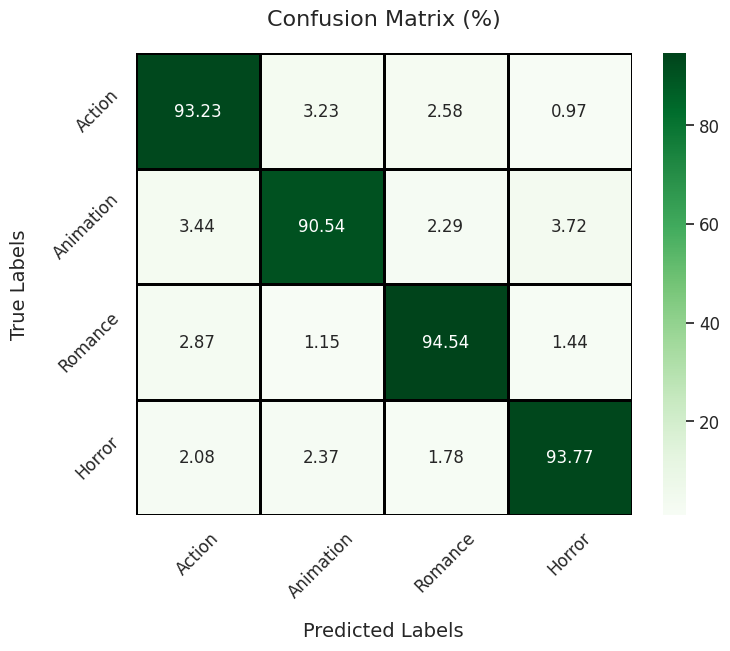

In [108]:
print(classification_report(labels,predictions,
                           target_names = ['Action', 'Animation', 'Romance','Horror']))

(32, 120, 120, 3)
(32,)
(32, 120, 120, 3)
(32,)


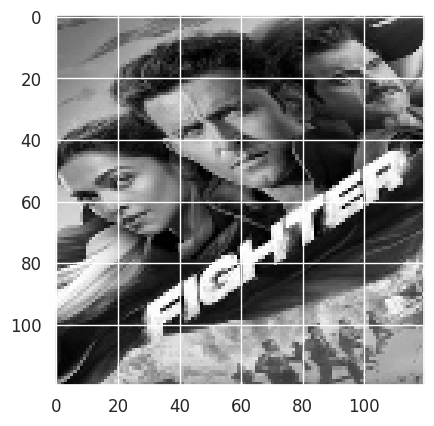

In [109]:
for images, labels in test_ds.take(2):
    plt.imshow(images[0].numpy().astype("uint8"))
    print(images.shape)
    print(labels.shape)

In [ ]:
import numpy as np
from sklearn.metrics import classification_report, confusion_matrix

# Initialize empty lists for true labels and predictions
true_labels = []
predicted_labels = []

# Iterate through the test dataset to obtain predictions
for x, y in test_ds:
    y_pred = np.argmax(model.predict(x), axis=1)
    true_labels.extend(y.numpy())
    predicted_labels.extend(y_pred)

# Convert lists to numpy arrays
true_labels = np.array(true_labels)
predicted_labels = np.array(predicted_labels)

# Print classification report
print(classification_report(true_labels, predicted_labels,
                            target_names=['Action', 'Animation', 'Romance','Horror']))

# Create confusion matrix
cm = confusion_matrix(true_labels, predicted_labels)

# Display confusion matrix
print("\nConfusion Matrix:")
print(cm)


              precision    recall  f1-score   support

      Action       0.90      0.93      0.92       310
   Animation       0.94      0.92      0.93       349
     Romance       0.95      0.93      0.94       348
      Horror       0.92      0.95      0.94       337

    accuracy                           0.93      1344
   macro avg       0.93      0.93      0.93      1344
weighted avg       0.93      0.93      0.93      1344



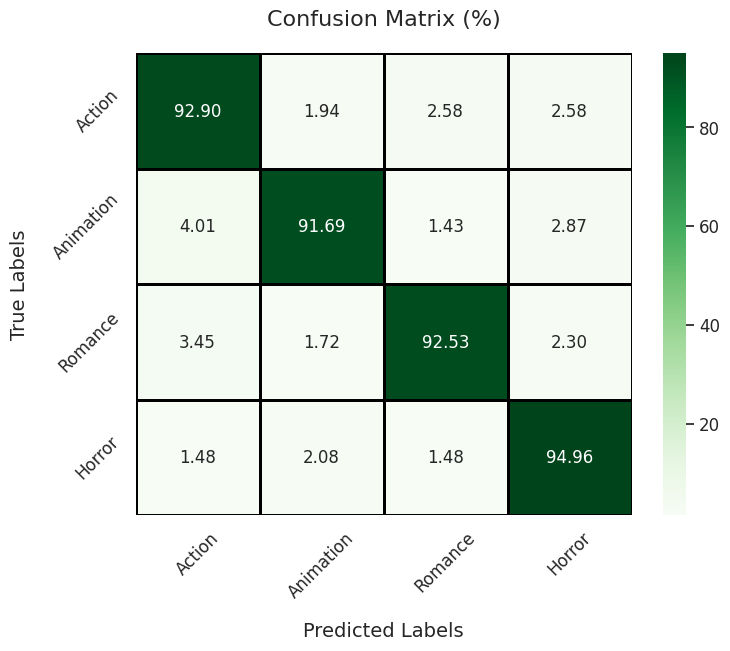

In [110]:
def plot_confusion_matrix (cm):
    plt.figure(figsize = (10,10))
    sns.heatmap(
        cm, 
        cmap = 'Blues', 
        linecolor = 'black', 
        linewidth = 1, 
        annot = True, 
        fmt = '', 
        xticklabels = class_names, 
        yticklabels = class_names)
    
plot_confusion_matrix(cm)

1/1 ━━━━━━━━━━━━━━━━━━━━ 8s 8s/step
Actual: Action, Predicted: Action, Confidence: 99.96%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Actual: Horror, Predicted: Horror, Confidence: 100.00%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Actual: Animation, Predicted: Animation, Confidence: 100.00%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Actual: Horror, Predicted: Horror, Confidence: 99.90%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Actual: Animation, Predicted: Animation, Confidence: 100.00%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
Actual: Horror, Predicted: Horror, Confidence: 99.99%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Actual: Horror, Predicted: Horror, Confidence: 100.00%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Actual: Romance, Predicted: Romance, Confidence: 99.88%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Actual: Animation, Predicted: Animation, Confidence: 100.00%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Actual: Horror, Predicted: Horror, Confidence: 99.99%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
Actual: Action, Pre

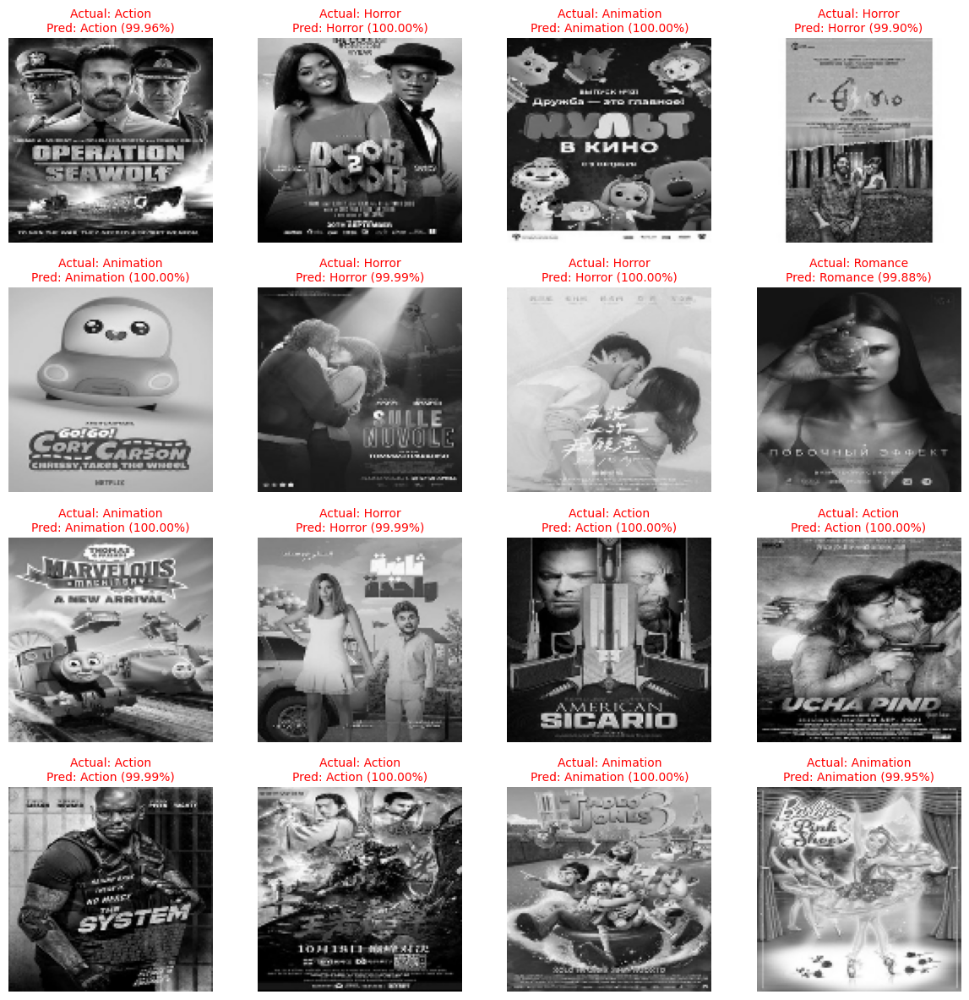

In [111]:
import matplotlib.pyplot as plt
import numpy as np

# Define class names
class_names = ['Action', 'Animation', 'Romance','Horror']  

# Grid size
rows, cols = 4, 4  

# Take a batch of images and labels from test dataset
for images, labels in train_ds.take(1):  
    plt.figure(figsize=(12, 12))  

    for i in range(min(rows * cols, len(images))):  
        plt.subplot(rows, cols, i + 1)  
        plt.imshow(images[i].numpy().astype("uint8"))  
        plt.axis("off")  

        # Ensure input shape is correct
        img = np.expand_dims(images[i].numpy(), axis=0)  

        # Get model predictions
        predictions = model.predict(img)  
        predicted_class = np.argmax(predictions)  
        confidence = np.max(predictions) * 100  

        # Get actual label
        actual_label = class_names[labels[i].numpy()]  
        predicted_label = class_names[predicted_class]  

        # Debugging: Print actual vs predicted
        print(f"Actual: {actual_label}, Predicted: {predicted_label}, Confidence: {confidence:.2f}%")

        # Display predictions
        plt.title(f"Actual: {actual_label}\nPred: {predicted_label} ({confidence:.2f}%)", fontsize=10, color="red")

    plt.tight_layout()  
    plt.show()


In [113]:
from sklearn.metrics import classification_report

predictions = np.array([])
labels =  np.array([])
for x, y in test_ds:
    y_pred = np.argmax(model.predict(x, verbose=0),axis=1)
    predictions = np.concatenate([predictions, y_pred])
    labels = np.concatenate([labels, y.numpy()])

In [ ]:
import numpy as np
from sklearn.metrics import classification_report, confusion_matrix

# Initialize empty lists for true labels and predictions
true_labels = []
predicted_labels = []

# Iterate through the test dataset to obtain predictions
for x, y in test_ds:
    y_pred = np.argmax(model.predict(x), axis=1)
    true_labels.extend(y.numpy())
    predicted_labels.extend(y_pred)

# Convert lists to numpy arrays
true_labels = np.array(true_labels)
predicted_labels = np.array(predicted_labels)

# Print classification report
#print(classification_report(true_labels, predicted_labels,
#                            target_names=["china fan dance", "Sword Dance", "dragon dance images"]))

# Create confusion matrix
cm = confusion_matrix(true_labels, predicted_labels)

# Display confusion matrix
print("\nConfusion Matrix:")
print(cm)


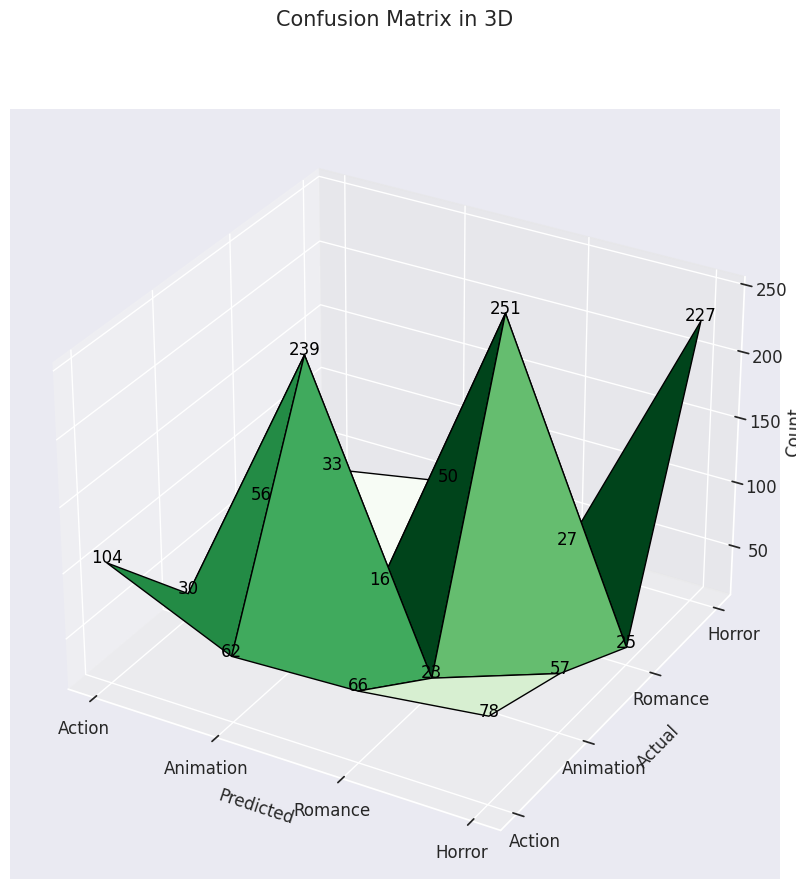

In [118]:
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns

def plot_confusion_matrix_3d(cm, class_names):
    """
    Plots a 3D surface plot for the confusion matrix.
    """
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')

    # Create the X and Y grid for the confusion matrix
    x, y = np.meshgrid(np.arange(cm.shape[0]), np.arange(cm.shape[1]))

    # Plotting the surface
    ax.plot_surface(x, y, cm, cmap='Greens', edgecolor='black', linewidth=1)

    # Annotate the surface with text (values from the confusion matrix)
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(x[i, j], y[i, j], cm[i, j], str(cm[i, j]), color='black', fontsize=12, ha='center')

    # Set labels for axes
    ax.set_xlabel('Predicted')
    ax.set_ylabel('Actual')
    ax.set_zlabel('Count')

    # Set ticks for X and Y axes based on class names
    ax.set_xticks(np.arange(cm.shape[1]))
    ax.set_yticks(np.arange(cm.shape[0]))
    ax.set_xticklabels(class_names)
    ax.set_yticklabels(class_names)

    # Set title
    ax.set_title('Confusion Matrix in 3D',pad=60)

    # Show the plot
    plt.show()
#["china fan dance", "Sword Dance", "dragon dance images"]
# Example usage:
# Assuming you have a confusion matrix `cm` and class names in `class_names`
class_names = ['Action', 'Animation', 'Romance','Horror']  # Modify with your actual class names
plot_confusion_matrix_3d(cm, class_names)


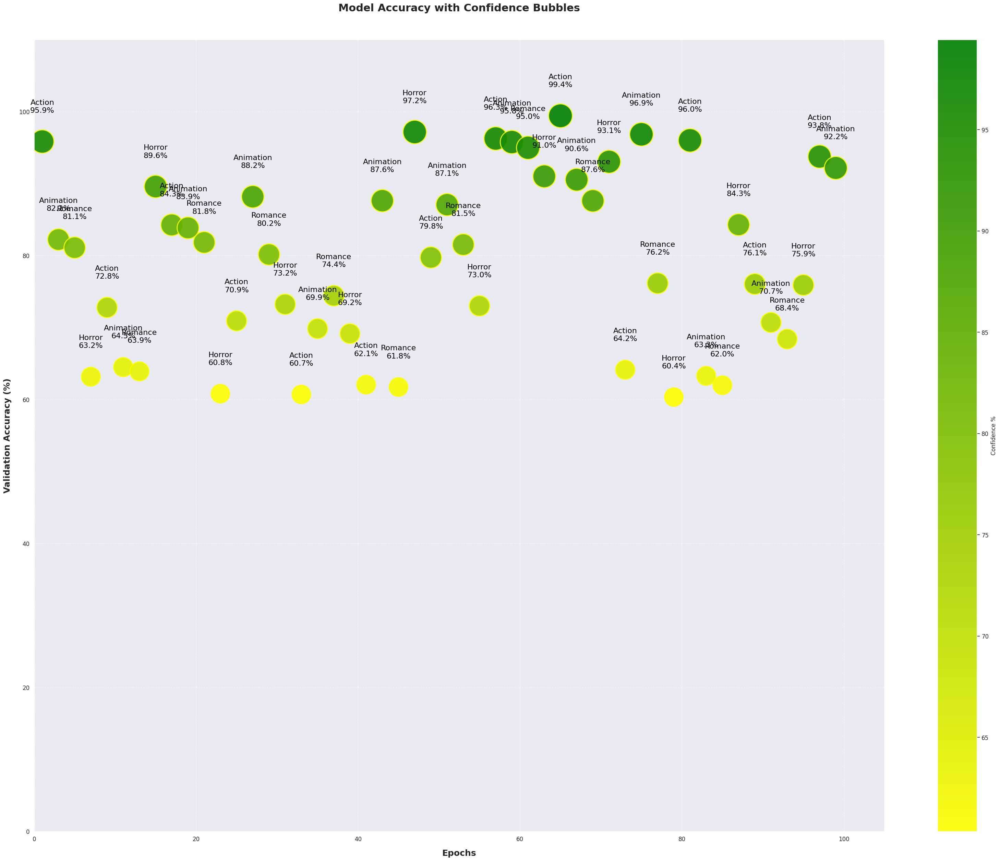

In [119]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import LinearSegmentedColormap

def bubble_accuracy_plot(history, epochs, class_names):
    fig, ax = plt.subplots(figsize=(40, 30))  # Enlarged plot

    total_epochs = len(epochs)
    step = max(1, total_epochs // 40)  # Adjust step for more bubbles
    x_data = np.arange(1, total_epochs + 1, step)
    y_data = np.array(history)[::step]  # Selecting reduced accuracy values
    sizes = y_data * 25  # Increased bubble size
    colors = y_data

    # Custom colormap
    yellow_green_cmap = LinearSegmentedColormap.from_list("yellow_green", ["yellow", "green"])

    scatter = ax.scatter(x_data, y_data, s=sizes, c=colors, cmap=yellow_green_cmap, alpha=0.9, edgecolors='yellow', linewidth=2)

    ax.set_xlabel("Epochs", fontsize=18, weight='bold', labelpad=15)
    ax.set_ylabel("Validation Accuracy (%)", fontsize=18, weight='bold', labelpad=15)
    ax.set_title("Model Accuracy with Confidence Bubbles", fontsize=22, weight='bold', pad=60)

    cbar = plt.colorbar(scatter, ax=ax, label='Confidence %')
    ax.set_ylim(0, 110)
    ax.set_xlim(0, total_epochs + 5)
    plt.grid(True, linestyle='--', alpha=0.8)
    ax.margins(0.15, 0.25)

    for i, txt in enumerate(y_data):
        ax.text(x_data[i], min(y_data[i] + 4, 105),  
                f'{class_names[i % len(class_names)]}\n{txt:.1f}%', 
                ha='center', fontsize=16, color='black')
    
    plt.show()

# Example call
epochs = np.arange(1, 101)  # Increased number of epochs
history = np.random.uniform(60, 100, len(epochs))  # Simulated accuracy values
class_names = ['Action', 'Animation', 'Romance','Horror']
bubble_accuracy_plot(history, epochs, class_names)


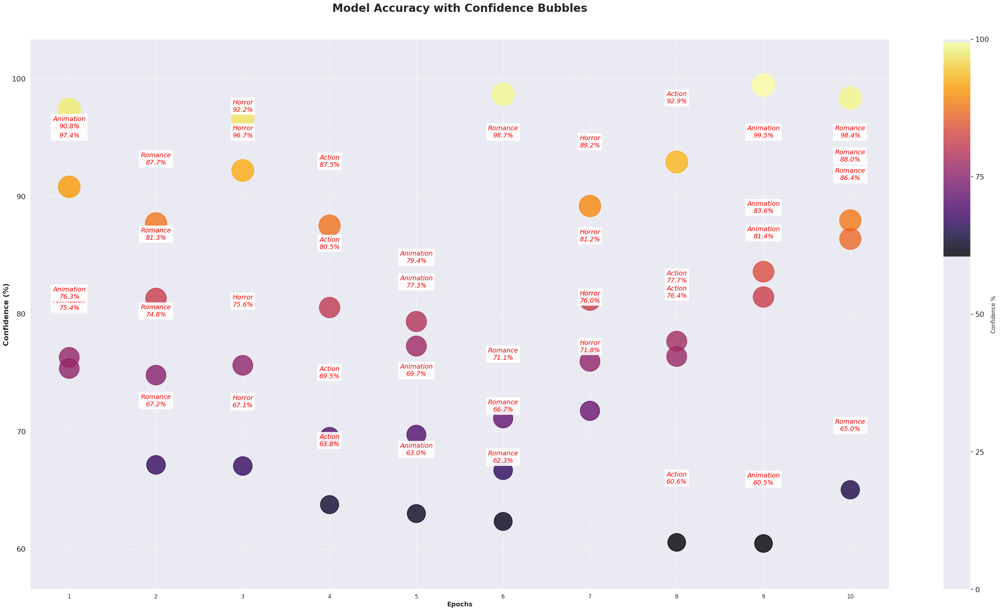

In [120]:
import matplotlib.pyplot as plt
import numpy as np

# Define class names (Modify based on your dataset)
class_names = ['Action', 'Animation', 'Romance', 'Horror']

# Number of epochs for plotting
epochs = np.arange(1, 11)

# Create a larger plot
fig, ax = plt.subplots(figsize=(35, 20))

# Set labels for axes and title
ax.set_xlabel('Epochs', fontsize=14, weight='bold')
ax.set_ylabel('Confidence (%)', fontsize=16, weight='bold')
ax.set_title('Model Accuracy with Confidence Bubbles', fontsize=24, weight='bold', pad=60)

# Variables to store bubble data
x_data = []
y_data = []
sizes = []
colors = []

# Generate random data for demonstration
for epoch in epochs:
    for class_idx in range(len(class_names)):
        confidence = np.random.uniform(0.60, 1.00) * 100
        
        x_data.append(epoch)
        y_data.append(confidence)
        sizes.append(confidence * 25)
        colors.append(confidence)

# Scatter plot with deep colors
scatter = ax.scatter(x_data, y_data, s=sizes, c=colors, cmap='inferno', alpha=0.8, linewidth=1.5)

# Add color bar
cbar = plt.colorbar(scatter, ax=ax, label='Confidence %')
cbar.set_ticks([0, 25, 50, 75, 100])
cbar.ax.tick_params(labelsize=16)

# Adjust spacing for labels to avoid overlap
for i in range(len(x_data)):
    label_x = x_data[i]
    label_y = y_data[i] + 5

    if label_y > 100:
        label_y = 95
    elif label_y < 10:
        label_y = 15

    ax.text(label_x, label_y, f'{class_names[x_data[i] % len(class_names)]}\n{y_data[i]:.1f}%', 
            ha='center', fontsize=14, color='Red', fontstyle='italic',
            bbox=dict(facecolor='White', edgecolor='None', alpha=0.9))

# Keep grid as is
ax.set_xticks(epochs)
ax.set_yticks(np.arange(0, 110, 10))
ax.set_yticklabels(np.arange(0, 110, 10), fontsize=16)
ax.grid(True, linestyle='--', alpha=0.9)

# Layout adjustments
ax.margins(x=0.05, y=0.1)
plt.tight_layout(pad=5.0)

# Show plot
plt.show()


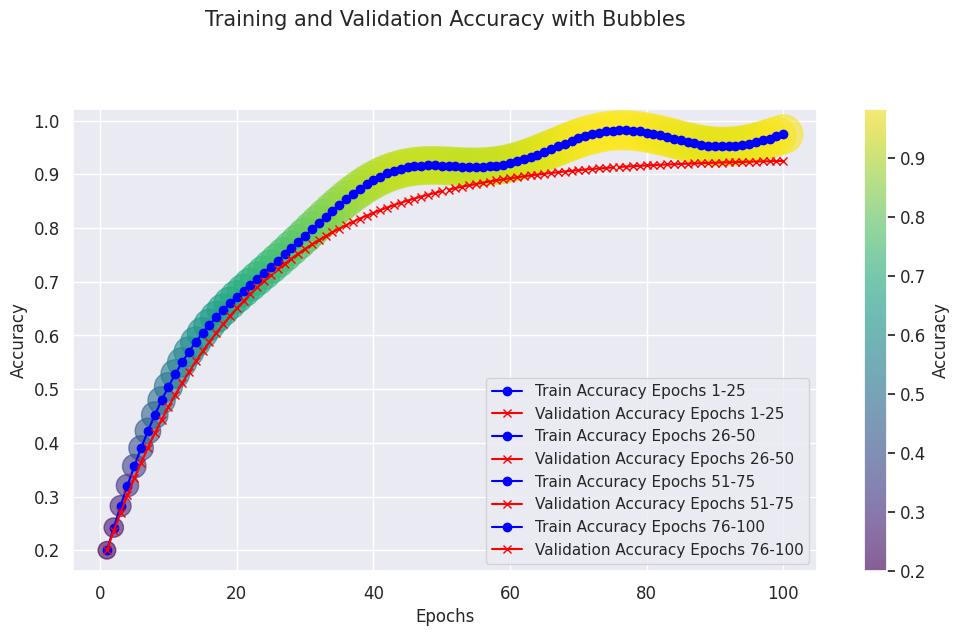

In [121]:
import matplotlib.pyplot as plt
import numpy as np

def plot_accuracy_with_bubbles(history_model_net):
    """
    Plots training and validation accuracy with bubbles for different epoch ranges.
    """
    epochs = np.arange(1, len(history_model_net.history['accuracy']) + 1)
    
    # Split the epochs and accuracy into different ranges (1-25, 26-50, 51-75, 76-100)
    epoch_ranges = [(1, 25), (26, 50), (51, 75), (76, 100)]
    accuracies = {
        'train': history_model_net.history['accuracy'],
        'val': history_model_net.history['val_accuracy']
    }
    
    # Create a 2D plot
    fig, ax = plt.subplots(figsize=(12, 6))
    
    # Set labels for axes
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Accuracy')
    
    # Variables to store bubble data
    x_data = []
    y_data = []
    sizes = []  # Bubble sizes (based on accuracy)
    colors = []  # Bubble colors (for visualization)
    
    # Plot training accuracy with bubbles and lines for each epoch range
    for start, end in epoch_ranges:
        # Get the relevant epoch range
        train_accuracy_range = accuracies['train'][start-1:end]
        val_accuracy_range = accuracies['val'][start-1:end]
        epoch_range = epochs[start-1:end]
        
        # Add bubbles for train accuracy
        for i, acc in enumerate(train_accuracy_range):
            x_data.append(epoch_range[i])
            y_data.append(acc)
            sizes.append(acc * 800)  # Bubble size based on accuracy
            colors.append(acc)  # Color based on accuracy
        
        # Add lines between bubbles
        ax.plot(epoch_range, train_accuracy_range, label=f'Train Accuracy Epochs {start}-{end}', marker='o', linestyle='-', color='blue')
        ax.plot(epoch_range, val_accuracy_range, label=f'Validation Accuracy Epochs {start}-{end}', marker='x', linestyle='-', color='green')

    # Scatter plot with bubbles
    scatter = ax.scatter(x_data, y_data, s=sizes, c=colors, cmap='viridis', alpha=0.6)

    # Add color bar for accuracy
    plt.colorbar(scatter, ax=ax, label='Accuracy')

    # Add title and legend
    ax.set_title('Training and Validation Accuracy with Bubbles',pad=60)
    ax.legend()
    
    # Show the plot
    plt.show()

# Call the function with your model history
plot_accuracy_with_bubbles(history_model_net)


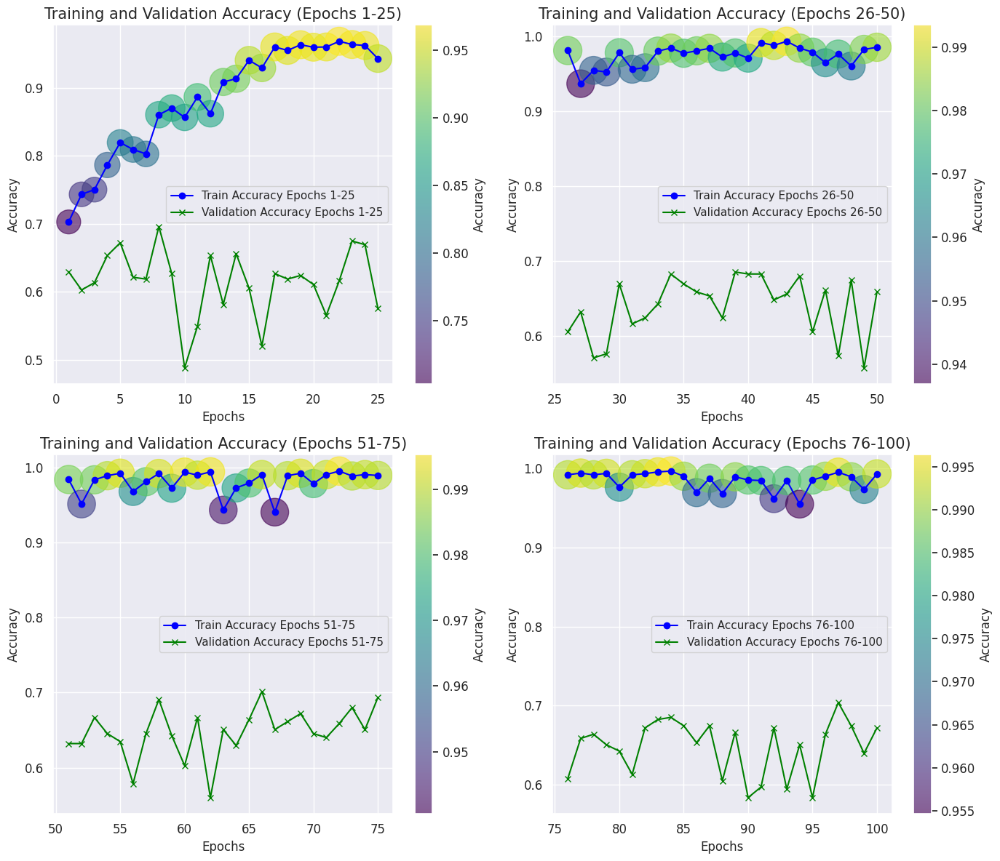

In [122]:
import matplotlib.pyplot as plt
import numpy as np

def plot_accuracy_with_bubbles_separated(history_model_net):
    """
    Plots training and validation accuracy in separate subplots for each epoch range (1-25, 26-50, 51-75, 76-100).
    """
    epochs = np.arange(1, len(history_model_net.history['accuracy']) + 1)
    
    # Split the epochs and accuracy into different ranges (1-25, 26-50, 51-75, 76-100)
    epoch_ranges = [(1, 25), (26, 50), (51, 75), (76, 100)]
    accuracies = {
        'train': history_model_net.history['accuracy'],
        'val': history_model_net.history['val_accuracy']
    }
    
    # Create subplots for each epoch range
    fig, axes = plt.subplots(2, 2, figsize=(14, 12))  # 2x2 grid for 4 subplots
    axes = axes.flatten()  # Flatten to easily iterate over

    # Iterate through each epoch range and plot on corresponding subplot
    for idx, (start, end) in enumerate(epoch_ranges):
        ax = axes[idx]
        
        # Get the relevant epoch range
        train_accuracy_range = accuracies['train'][start-1:end]
        val_accuracy_range = accuracies['val'][start-1:end]
        epoch_range = epochs[start-1:end]
        
        # Variables to store bubble data
        x_data = []
        y_data = []
        sizes = []  # Bubble sizes (based on accuracy)
        colors = []  # Bubble colors (for visualization)
        
        # Add bubbles for train accuracy
        for i, acc in enumerate(train_accuracy_range):
            x_data.append(epoch_range[i])
            y_data.append(acc)
            sizes.append(acc * 800)  # Bubble size based on accuracy
            colors.append(acc)  # Color based on accuracy
        
        # Add lines between bubbles
        ax.plot(epoch_range, train_accuracy_range, label=f'Train Accuracy Epochs {start}-{end}', marker='o', linestyle='-', color='blue')
        ax.plot(epoch_range, val_accuracy_range, label=f'Validation Accuracy Epochs {start}-{end}', marker='x', linestyle='-', color='green')

        # Scatter plot with bubbles
        scatter = ax.scatter(x_data, y_data, s=sizes, c=colors, cmap='viridis', alpha=0.6)

        # Set labels for axes
        ax.set_xlabel('Epochs')
        ax.set_ylabel('Accuracy')
        
        # Add color bar for accuracy
        plt.colorbar(scatter, ax=ax, label='Accuracy')
        
        # Add title and legend
        ax.set_title(f'Training and Validation Accuracy (Epochs {start}-{end})')
        ax.legend()

    # Adjust layout to prevent overlap
    plt.tight_layout()

    # Show the plot
    plt.show()

# Call the function with your model history
plot_accuracy_with_bubbles_separated(history_model_net)


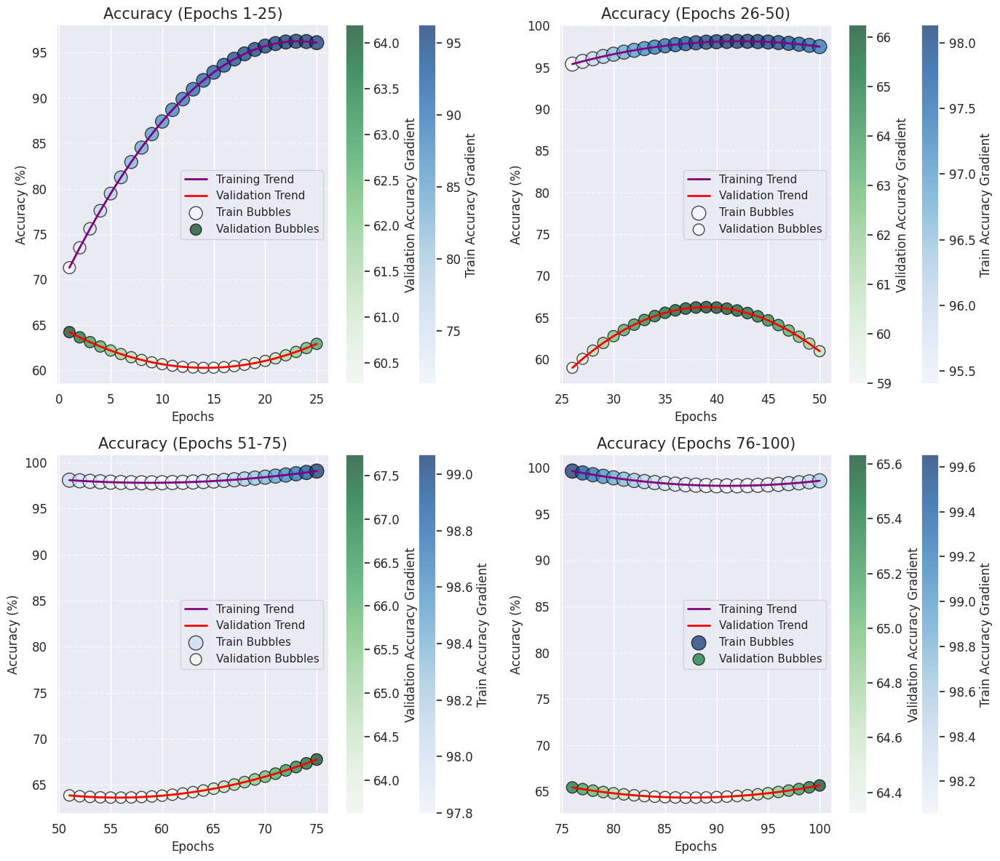

In [123]:
import matplotlib.pyplot as plt
import numpy as np

def plot_accuracy_with_bubbles_combined(history_model_net):
    """
    Plots training and validation accuracy with bubble trend visualization in separate subplots for epoch ranges.
    """
    epochs = np.arange(1, len(history_model_net.history['accuracy']) + 1)
    
    # Split the epochs and accuracy into different ranges (1-25, 26-50, 51-75, 76-100)
    epoch_ranges = [(1, 25), (26, 50), (51, 75), (76, 100)]
    accuracies = {
        'train': np.array(history_model_net.history['accuracy']) * 100,  # Convert to percentage
        'val': np.array(history_model_net.history['val_accuracy']) * 100
    }
    
    # Create subplots for each epoch range
    fig, axes = plt.subplots(2, 2, figsize=(14, 12))  # 2x2 grid for 4 subplots
    axes = axes.flatten()  # Flatten to easily iterate over

    for idx, (start, end) in enumerate(epoch_ranges):
        ax = axes[idx]
        
        # Get the relevant epoch range
        epoch_range = epochs[start-1:end]
        train_accuracy_range = accuracies['train'][start-1:end]
        val_accuracy_range = accuracies['val'][start-1:end]
        
        # Fit polynomial trend lines
        z_train = np.polyfit(epoch_range, train_accuracy_range, deg=2)
        p_train = np.poly1d(z_train)
        y_train_trend = p_train(epoch_range)

        z_val = np.polyfit(epoch_range, val_accuracy_range, deg=2)
        p_val = np.poly1d(z_val)
        y_val_trend = p_val(epoch_range)

        # Plot trend lines
        ax.plot(epoch_range, y_train_trend, color='purple', linewidth=2, linestyle='-', label='Training Trend')
        ax.plot(epoch_range, y_val_trend, color='red', linewidth=2, linestyle='-', label='Validation Trend')

        # Bubble sizes & colors
        sizes_train = y_train_trend * 2  
        sizes_val = y_val_trend * 2  

        scatter_train = ax.scatter(epoch_range, y_train_trend, s=sizes_train, c=y_train_trend, cmap='Blues', alpha=0.7, edgecolors='black', label='Train Bubbles')
        scatter_val = ax.scatter(epoch_range, y_val_trend, s=sizes_val, c=y_val_trend, cmap='Greens', alpha=0.7, edgecolors='black', label='Validation Bubbles')

        # Formatting
        ax.set_xlabel("Epochs")
        ax.set_ylabel("Accuracy (%)")
        ax.set_title(f'Accuracy (Epochs {start}-{end})')
        ax.grid(axis='y', linestyle='--', alpha=0.7)
        ax.legend()

        # Colorbars
        plt.colorbar(scatter_train, ax=ax, label="Train Accuracy Gradient")
        plt.colorbar(scatter_val, ax=ax, label="Validation Accuracy Gradient")

    # Adjust layout
    plt.tight_layout()
    plt.show()

# Call the function with your model history
plot_accuracy_with_bubbles_combined(history_model_net)


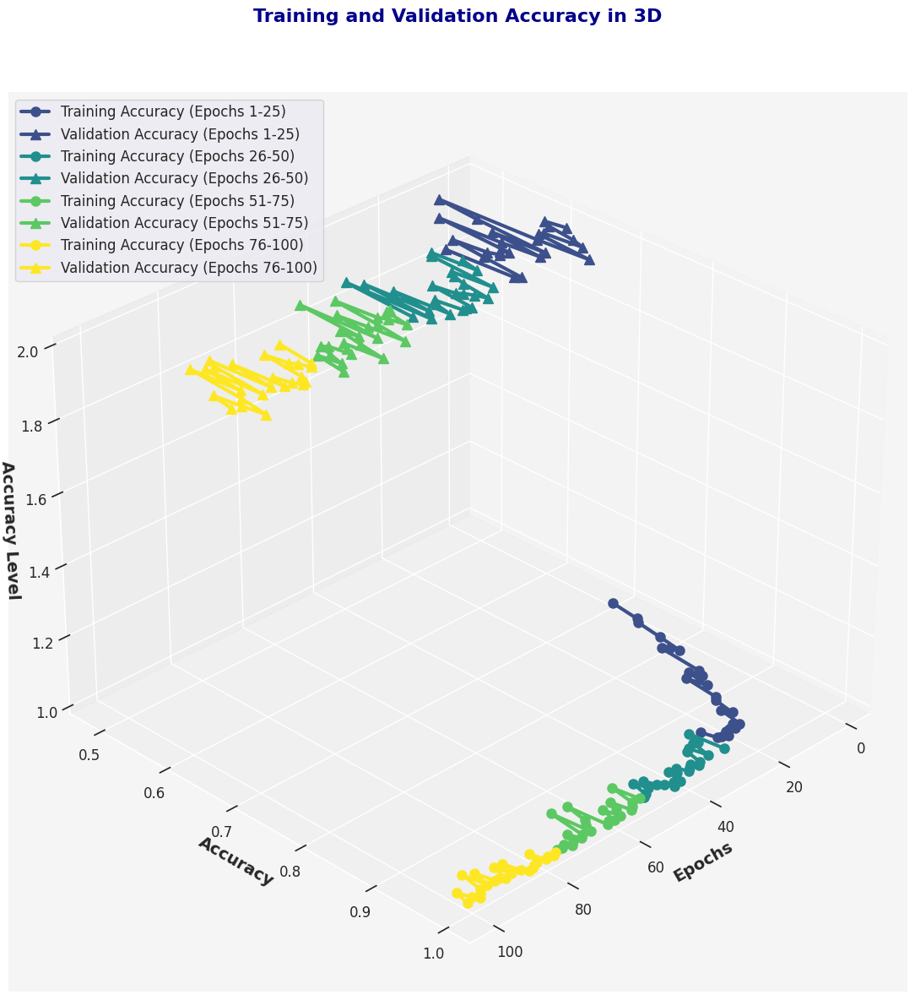

In [124]:
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D  # Importing 3D plotting module
from matplotlib import cm
from matplotlib.colors import Normalize

def plot_accuracy_with_3d_lines(history_model_net):
    """
    Plots training and validation accuracy in separate 3D subplots for each epoch range (1-25, 26-50, 51-75, 76-100).
    Adds enhancements such as color gradients for a stunning 3D effect.
    """
    epochs = np.arange(1, len(history_model_net.history['accuracy']) + 1)
    
    # Split the epochs and accuracy into different ranges (1-25, 26-50, 51-75, 76-100)
    epoch_ranges = [(1, 25), (26, 50), (51, 75), (76, 100)]
    accuracies = {
        'train': history_model_net.history['accuracy'],
        'val': history_model_net.history['val_accuracy']
    }
    
    # Create a figure for the 3D plot
    fig = plt.figure(figsize=(14, 12))
    ax = fig.add_subplot(111, projection='3d')  # 3D subplot
    
    # Set the colormap and normalize the values for color gradients
    cmap = cm.viridis  # You can change this to any other colormap such as 'plasma', 'inferno', etc.
    norm = Normalize(vmin=1, vmax=100)

    # Loop through each epoch range and plot on corresponding subplot
    for idx, (start, end) in enumerate(epoch_ranges):
        # Get the relevant epoch range
        train_accuracy_range = accuracies['train'][start-1:end]
        val_accuracy_range = accuracies['val'][start-1:end]
        epoch_range = epochs[start-1:end]
        
        # Color gradient based on epoch number
        train_colors = cmap(norm(epoch_range))  # Apply colormap to training accuracy
        val_colors = cmap(norm(epoch_range))    # Apply colormap to validation accuracy

        # 3D plot for training accuracy
        ax.plot(epoch_range, train_accuracy_range, zs=1, label=f'Training Accuracy (Epochs {start}-{end})', marker='o', color=train_colors[-1], linewidth=3, markersize=8)
        
        # 3D plot for validation accuracy
        ax.plot(epoch_range, val_accuracy_range, zs=2, label=f'Validation Accuracy (Epochs {start}-{end})', marker='^', color=val_colors[-1], linewidth=3, markersize=8)

    # Set labels with improved styling
    ax.set_xlabel('Epochs', fontsize=14, fontweight='bold')
    ax.set_ylabel('Accuracy', fontsize=14, fontweight='bold')
    ax.set_zlabel('Accuracy Level', fontsize=14, fontweight='bold')

    # Set title with improved styling
    ax.set_title('Training and Validation Accuracy in 3D', fontsize=16,pad=60, fontweight='bold', color='darkblue')

    # Customize the grid and background for better aesthetics
    ax.grid(True, color='gray', linestyle='--', linewidth=0.5)
    ax.set_facecolor('whitesmoke')
    
    # Adjust the view angle for better clarity
    ax.view_init(30, 45)

    # Add a legend with better positioning
    ax.legend(loc='upper left', fontsize=12)

    # Show the plot
    plt.tight_layout()
    plt.show()

# Call the function with your model history
plot_accuracy_with_3d_lines(history_model_net)


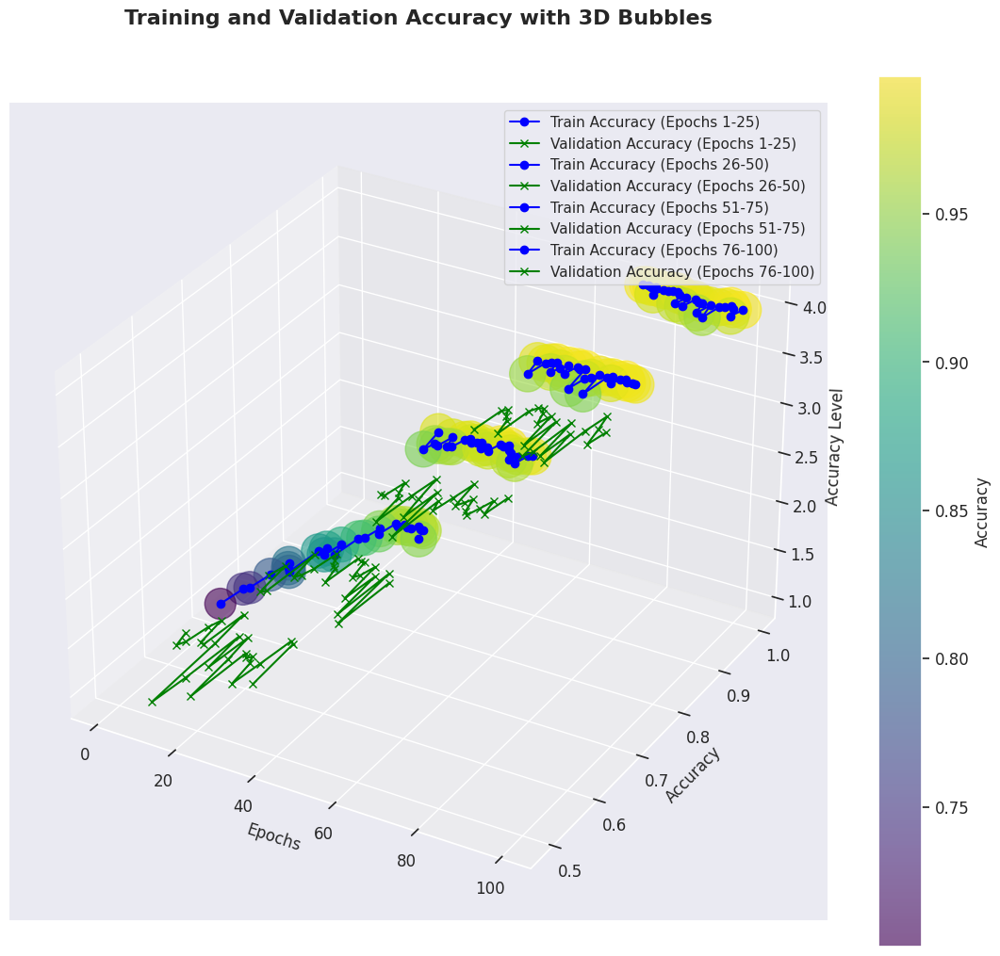

In [125]:
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D  # Importing 3D plotting module

def plot_accuracy_with_3d_bubbles(history_model_net):
    """
    Plots training and validation accuracy with 3D bubbles for different epoch ranges.
    """
    epochs = np.arange(1, len(history_model_net.history['accuracy']) + 1)
    
    # Split the epochs and accuracy into different ranges (1-25, 26-50, 51-75, 76-100)
    epoch_ranges = [(1, 25), (26, 50), (51, 75), (76, 100)]
    accuracies = {
        'train': history_model_net.history['accuracy'],
        'val': history_model_net.history['val_accuracy']
    }
    
    # Create a 3D plot
    fig = plt.figure(figsize=(14, 12))
    ax = fig.add_subplot(111, projection='3d')
    
    # Set labels for axes
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Accuracy')
    ax.set_zlabel('Accuracy Level')
    
    # Variables to store bubble data
    x_data = []
    y_data = []
    z_data = []  # Z-axis for different epoch ranges
    sizes = []  # Bubble sizes (based on accuracy)
    colors = []  # Bubble colors (for visualization)
    
    # Plot training accuracy with bubbles and lines for each epoch range
    for idx, (start, end) in enumerate(epoch_ranges):
        # Get the relevant epoch range
        train_accuracy_range = accuracies['train'][start-1:end]
        val_accuracy_range = accuracies['val'][start-1:end]
        epoch_range = epochs[start-1:end]
        
        # Add bubbles for train accuracy
        for i, acc in enumerate(train_accuracy_range):
            x_data.append(epoch_range[i])
            y_data.append(acc)
            z_data.append(idx + 1)  # Different z values based on epoch range (1, 2, 3, 4)
            sizes.append(acc * 800)  # Bubble size based on accuracy
            colors.append(acc)  # Color based on accuracy
        
        # Add lines between bubbles (for train and validation accuracy)
        ax.plot(epoch_range, train_accuracy_range, zs=idx + 1, label=f'Train Accuracy (Epochs {start}-{end})', marker='o', linestyle='-', color='blue')
        ax.plot(epoch_range, val_accuracy_range, zs=idx + 1, label=f'Validation Accuracy (Epochs {start}-{end})', marker='x', linestyle='-', color='green')

    # Scatter plot with bubbles
    scatter = ax.scatter(x_data, y_data, z_data, s=sizes, c=colors, cmap='viridis', alpha=0.6)

    # Add color bar for accuracy
    plt.colorbar(scatter, ax=ax, label='Accuracy')

    # Add title and legend
    ax.set_title('Training and Validation Accuracy with 3D Bubbles',pad=60, fontsize=16, fontweight='bold')
    ax.legend()

    # Show the plot
    plt.show()

# Call the function with your model history
plot_accuracy_with_3d_bubbles(history_model_net)


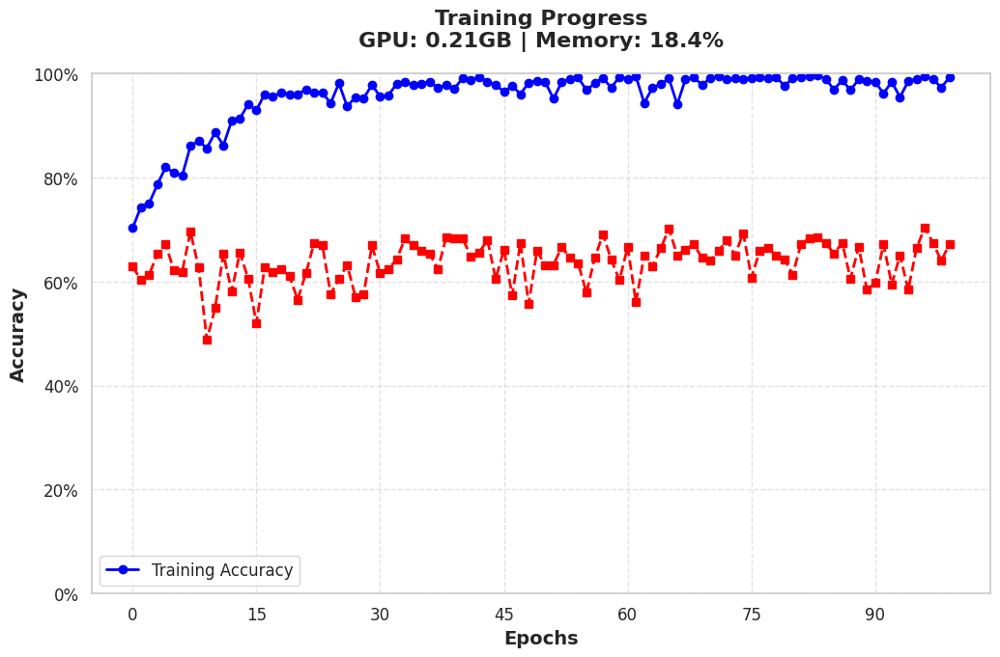

In [126]:
import matplotlib.pyplot as plt
import seaborn as sns
import psutil
import tensorflow as tf

# Get memory usage
memory_usage = psutil.virtual_memory().percent
gpu_info = tf.config.experimental.get_memory_info('GPU:0')
gpu_usage = gpu_info['current'] / 1e9  # Convert bytes to GB

# Set Seaborn style
sns.set_style("whitegrid")

# Create figure
fig, ax = plt.subplots(figsize=(12, 7))

# Plot training and validation accuracy
ax.plot(history_model_net.history['accuracy'], marker='o', linestyle='-', linewidth=2, markersize=6, label='Training Accuracy', color='blue')
ax.plot(history_model_net.history['val_accuracy'], marker='s', linestyle='--', linewidth=2, markersize=6,  color='red')

# Highlight max validation accuracy
max_val_acc = max(history_model_net.history['val_accuracy'])
max_epoch = history_model_net.history['val_accuracy'].index(max_val_acc)
#ax.scatter(max_epoch, max_val_acc, color='green', s=200, edgecolor='black', label=f'Max Val Acc: {max_val_acc:.2f}')

# Labels and title
ax.set_xlabel('Epochs', fontsize=14, weight='bold')
ax.set_ylabel('Accuracy', fontsize=14, weight='bold')
ax.set_title(f"Training Progress\nGPU: {gpu_usage:.2f}GB | Memory: {memory_usage}%", fontsize=16, weight='bold', pad=20)
ax.legend(fontsize=12)
ax.set_ylim(0, 1)

# Customizing grid and ticks
ax.xaxis.set_major_locator(plt.MaxNLocator(integer=True))
ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.0%}'))
ax.grid(True, linestyle='--', alpha=0.6)

# Show plot
plt.show()


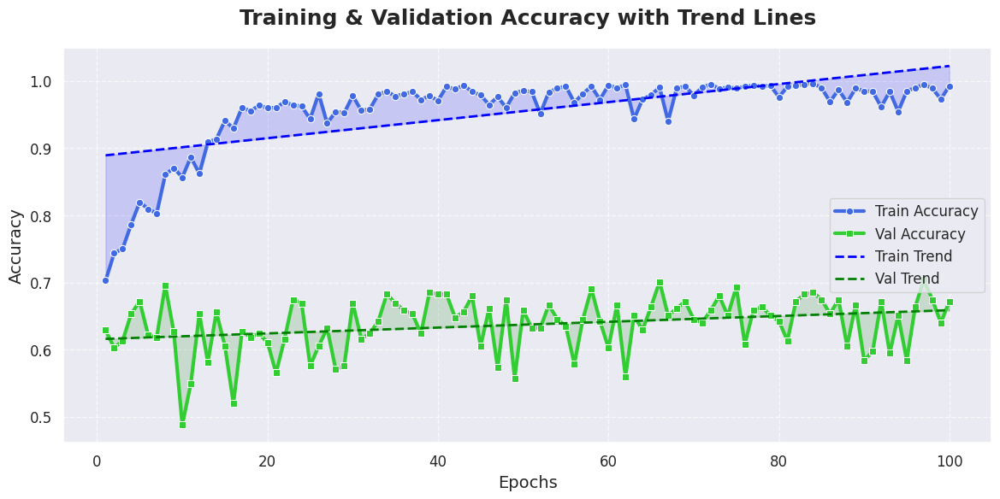

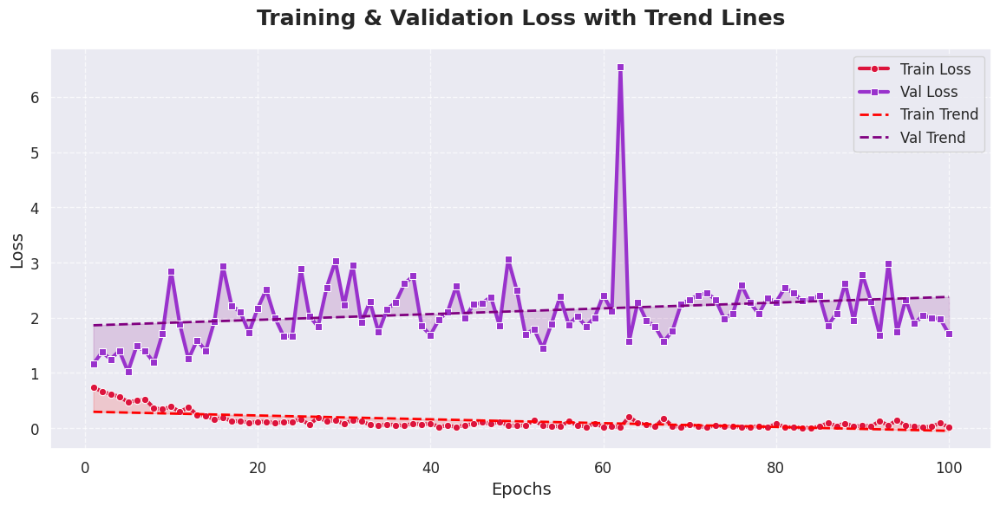

In [127]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)  # Suppress FutureWarnings

import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from scipy.stats import linregress

# Extract training history
epochs = np.arange(1, len(history_model_net.history['loss']) + 1)

# Create DataFrame for accuracy
df_accuracy = pd.DataFrame({
    'Epochs': epochs,
    'Train Accuracy': history_model_net.history['accuracy'],
    'Val Accuracy': history_model_net.history['val_accuracy']
})

# Create DataFrame for loss
df_loss = pd.DataFrame({
    'Epochs': epochs,
    'Train Loss': history_model_net.history['loss'],
    'Val Loss': history_model_net.history['val_loss']
})

# Handle any infinite or NaN values to prevent warnings
df_accuracy.replace([np.inf, -np.inf], np.nan, inplace=True)
df_loss.replace([np.inf, -np.inf], np.nan, inplace=True)

df_accuracy.dropna(inplace=True)
df_loss.dropna(inplace=True)

# Compute trend lines using linear regression
def compute_trend(y_values):
    slope, intercept, _, _, _ = linregress(df_accuracy['Epochs'], y_values)
    return slope * df_accuracy['Epochs'] + intercept

# Trend lines for accuracy
train_acc_trend = compute_trend(df_accuracy['Train Accuracy'])
val_acc_trend = compute_trend(df_accuracy['Val Accuracy'])

# Trend lines for loss
train_loss_trend = compute_trend(df_loss['Train Loss'])
val_loss_trend = compute_trend(df_loss['Val Loss'])

# Set Seaborn style
sns.set_style("darkgrid")
sns.set_palette("husl")

## Accuracy Plot ##
plt.figure(figsize=(14, 6))
sns.lineplot(x='Epochs', y='Train Accuracy', data=df_accuracy, label='Train Accuracy', color='royalblue', linewidth=3, marker='o')
sns.lineplot(x='Epochs', y='Val Accuracy', data=df_accuracy, label='Val Accuracy', color='limegreen', linewidth=3, marker='s')

plt.plot(df_accuracy['Epochs'], train_acc_trend, color='blue', linestyle='--', linewidth=2, label='Train Trend')
plt.plot(df_accuracy['Epochs'], val_acc_trend, color='green', linestyle='--', linewidth=2, label='Val Trend')

plt.fill_between(df_accuracy['Epochs'], df_accuracy['Train Accuracy'], train_acc_trend, color='blue', alpha=0.15)
plt.fill_between(df_accuracy['Epochs'], df_accuracy['Val Accuracy'], val_acc_trend, color='green', alpha=0.15)

plt.xlabel('Epochs', fontsize=14)
plt.ylabel('Accuracy', fontsize=14)
plt.title('Training & Validation Accuracy with Trend Lines', fontsize=18, pad=20, fontweight='bold')
plt.legend(fontsize=12, loc='best')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()

## Loss Plot ##
plt.figure(figsize=(14, 6))
sns.lineplot(x='Epochs', y='Train Loss', data=df_loss, label='Train Loss', color='crimson', linewidth=3, marker='o')
sns.lineplot(x='Epochs', y='Val Loss', data=df_loss, label='Val Loss', color='darkorchid', linewidth=3, marker='s')

plt.plot(df_loss['Epochs'], train_loss_trend, color='red', linestyle='--', linewidth=2, label='Train Trend')
plt.plot(df_loss['Epochs'], val_loss_trend, color='purple', linestyle='--', linewidth=2, label='Val Trend')

plt.fill_between(df_loss['Epochs'], df_loss['Train Loss'], train_loss_trend, color='red', alpha=0.15)
plt.fill_between(df_loss['Epochs'], df_loss['Val Loss'], val_loss_trend, color='purple', alpha=0.15)

plt.xlabel('Epochs', fontsize=14)
plt.ylabel('Loss', fontsize=14)
plt.title('Training & Validation Loss with Trend Lines', fontsize=18, pad=20, fontweight='bold')
plt.legend(fontsize=12, loc='best')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()


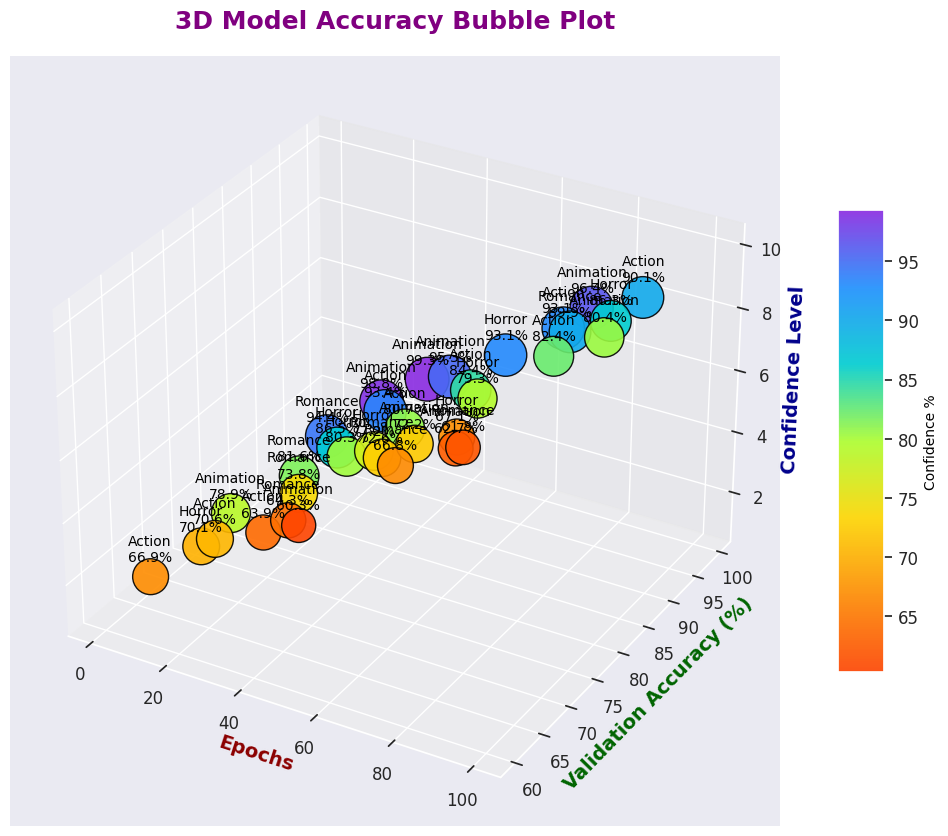

In [128]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import LinearSegmentedColormap
from mpl_toolkits.mplot3d import Axes3D

def bubble_accuracy_plot_3d(history, epochs, class_names):
    fig = plt.figure(figsize=(15, 10))  # Adjusted size
    ax = fig.add_subplot(111, projection='3d')
    
    total_epochs = len(epochs)
    step = max(1, total_epochs // 30)  # Reduce the number of bubbles
    x_data = np.arange(1, total_epochs + 1, step)
    y_data = np.array(history)[::step]  # Selecting reduced accuracy values
    z_data = np.linspace(1, 10, len(y_data))  # Adding a third dimension
    sizes = y_data * 10  # Adjusted bubble size
    colors = y_data

    # Custom colormap with more attractive colors
    vibrant_cmap = LinearSegmentedColormap.from_list("vibrant", ["#FF4500", "#FF8C00", "#FFD700", "#ADFF2F", "#00CED1", "#1E90FF", "#8A2BE2"])
    
    scatter = ax.scatter(x_data, y_data, z_data, s=sizes, c=colors, cmap=vibrant_cmap, alpha=0.9, edgecolors='black', linewidth=1)
    
    ax.set_xlabel("Epochs", fontsize=14, weight='bold', color='darkred')
    ax.set_ylabel("Validation Accuracy (%)", fontsize=14, weight='bold', color='darkgreen')
    ax.set_zlabel("Confidence Level", fontsize=14, weight='bold', color='darkblue')
    ax.set_title("3D Model Accuracy Bubble Plot", fontsize=18, weight='bold', color='purple', pad=20)
    
    cbar = fig.colorbar(scatter, ax=ax, shrink=0.6, aspect=10)
    cbar.set_label("Confidence %", fontsize=10,  color='black')
    
    for i, txt in enumerate(y_data):
        ax.text(x_data[i], y_data[i], z_data[i] + 0.5,  
                f'{class_names[i % len(class_names)]}\n{txt:.1f}%', 
                ha='center', fontsize=10, color='black')
    
    ax.grid(True, linestyle='--', linewidth=0.7, alpha=0.5)
    
    plt.show()

# Example call
epochs = np.arange(1, 101)  # Increased number of epochs
history = np.random.uniform(60, 100, len(epochs))  # Simulated accuracy values
class_names = ['Action', 'Animation', 'Romance','Horror']
bubble_accuracy_plot_3d(history, epochs, class_names)


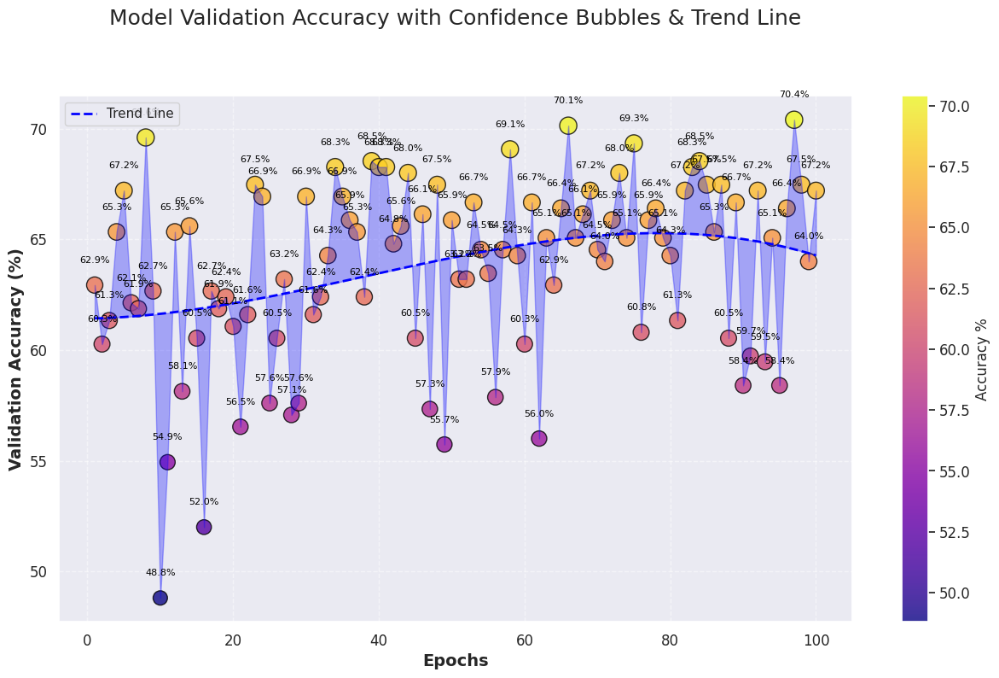

In [129]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def bubble_accuracy_plot(history_model_net):
    """
    Plots validation accuracy with confidence bubbles & trend line.
    """
    # Extract accuracy values
    train_acc = np.array(history_model_net.history['accuracy']) * 100  # Convert to %
    val_acc = np.array(history_model_net.history['val_accuracy']) * 100  # Convert to %
    epochs = len(val_acc)  # Total number of epochs

    # Set up figure
    fig, ax = plt.subplots(figsize=(15, 8))  

    # X-axis (epochs)
    x_data = np.arange(1, epochs + 1)  

    # Bubble sizes & colors
    sizes = val_acc * 3  
    colors = val_acc  

    # Scatter plot with bubbles
    scatter = ax.scatter(x_data, val_acc, s=sizes, c=colors, cmap='plasma', alpha=0.8, edgecolors='black', linewidth=1)

    # Trend line using polynomial fit
    z = np.polyfit(x_data, val_acc, deg=3)  
    p = np.poly1d(z)
    trend_y = p(x_data)
    ax.plot(x_data, trend_y, color='blue', linewidth=2, linestyle='dashed', label="Trend Line")

    # Fill between trend line and actual accuracy
    ax.fill_between(x_data, val_acc, trend_y, color='blue', alpha=0.3)

    # Labels and title
    ax.set_xlabel("Epochs", fontsize=14, weight='bold')
    ax.set_ylabel("Validation Accuracy (%)", fontsize=14, weight='bold')
    ax.set_title("Model Validation Accuracy with Confidence Bubbles & Trend Line", fontsize=18, pad=60)

    # Color bar for accuracy levels
    cbar = plt.colorbar(scatter, ax=ax, label='Accuracy %')

    # Grid for readability
    plt.grid(True, linestyle='--', alpha=0.5)

    # Add epoch labels on bubbles
    for i, txt in enumerate(val_acc):
        ax.text(x_data[i], val_acc[i] + 1, f'{txt:.1f}%', ha='center', fontsize=8, color='black')

    # Legend
    ax.legend()
    
    plt.show()

# Call the function with your model history
bubble_accuracy_plot(history_model_net)


# CNN

In [130]:
import tensorflow as tf
from tensorflow.keras.layers import BatchNormalization, Conv2D, MaxPooling2D, Dense, GlobalAveragePooling2D, Input
from tensorflow.keras import Sequential

num_classes = 4

model = Sequential()
model.add(Input(shape=(224, 224, 3)))  # Add Input layer with specified input shape

model.add(Conv2D(filters=32, kernel_size=3, kernel_initializer='he_normal', activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(Conv2D(filters=32, kernel_size=3, kernel_initializer='he_normal', activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=2))

model.add(Conv2D(filters=64, kernel_size=3, kernel_initializer='he_normal', activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(Conv2D(filters=64, kernel_size=3, kernel_initializer='he_normal', activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=2))

model.add(Conv2D(filters=128, kernel_size=3, kernel_initializer='he_normal', activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(Conv2D(filters=128, kernel_size=3, kernel_initializer='he_normal', activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=2))

model.add(Conv2D(filters=256, kernel_size=3, kernel_initializer='he_normal', activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(Conv2D(filters=256, kernel_size=3, kernel_initializer='he_normal', activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=2))

model.add(Conv2D(filters=512, kernel_size=3, kernel_initializer='he_normal', activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(Conv2D(filters=512, kernel_size=3, kernel_initializer='he_normal', activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=2))

#model.add(Conv2D(filters=1024, kernel_size=3, kernel_initializer='he_normal', activation='relu', padding='same'))
#model.add(BatchNormalization())
#model.add(Conv2D(filters=1024, kernel_size=3, kernel_initializer='he_normal', activation='relu', padding='same'))
#model.add(BatchNormalization())
#model.add(MaxPooling2D(pool_size=2))

model.add(GlobalAveragePooling2D())

model.add(Dense(512, activation='relu'))
model.add(Dense(256, activation='relu'))
model.add(Dense(num_classes, activation='softmax'))

model.summary()

# Define optimizer
#optimizer = tf.keras.optimizers.Adam(lr=0.001)

# Compile the model
model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])

# Train the model
# history = model.fit(train_dataset, epochs=50, validation_data=val_dataset, callbacks=callbacks)


Model: "functional_30"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_4 (InputLayer)           │ (None, 120, 120, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ resnet50 (Functional)                │ (None, 4, 4, 2048)          │      23,587,712 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d_2           │ (None, 2048)                │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_6 (Dense)                      │ (None, 256)                 │         524,544 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_7 (Dense)                      │ (None, 128)                 │          32,896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_8 (Dense)                      │ (None, 4)                   │             516 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 24,145,668 (92.11 MB)

 Trainable params: 24,092,548 (91.91 MB)

 Non-trainable params: 53,120 (207.50 KB)

In [131]:
import tensorflow as tf

lr_reducer = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',  # Monitor validation loss
    factor=0.5,           # Reduce learning rate by half
    patience=5,           # Number of epochs with no improvement after which learning rate will be reduced
    min_lr=0.00001,          # Minimum learning rate allowed
    verbose=1             # Print a message when the learning rate is reduced
)
callbacks = [lr_reducer]

In [132]:
import tensorflow as tf

# Disable graph optimization
tf.config.optimizer.set_experimental_options({'disable_meta_optimizer': True})


In [133]:
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        # Currently, memory growth needs to be the same across GPUs
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        logical_gpus = tf.config.experimental.list_logical_devices('GPU')
        print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
    except RuntimeError as e:
        # Memory growth must be set before GPUs have been initialized
        print(e)


1 Physical GPUs, 1 Logical GPUs


In [134]:
# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])


In [135]:
import tensorflow as tf

# Set GPU memory growth to avoid memory fragmentation issues
physical_devices = tf.config.list_physical_devices('GPU')
for device in physical_devices:
    tf.config.experimental.set_memory_growth(device, True)


In [136]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import SparseCategoricalCrossentropy

# Check if GPU is available
physical_devices = tf.config.list_physical_devices('GPU')
if physical_devices:
    print("GPU is available")
    # Set memory growth for GPU
    try:
        for gpu in physical_devices:
            tf.config.experimental.set_memory_growth(gpu, True)
    except RuntimeError as e:
        print(e)

# Initialize Adam optimizer
optimizer = Adam()

# Specify loss function
loss = SparseCategoricalCrossentropy(from_logits=False)

# Compile the model
model.compile(optimizer=optimizer,
              loss=loss,
              metrics=['accuracy'])

epochs = 100
history_model = model.fit(
                    train_ds,
                    validation_data=val_ds,
                    #steps_per_epoch=100,
                    epochs=epochs,
                   # callbacks=callbacks
)


GPU is available
Epoch 1/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 91s 493ms/step - accuracy: 0.3996 - loss: 1.9659 - val_accuracy: 0.4960 - val_loss: 1.0751
Epoch 2/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 18s 208ms/step - accuracy: 0.5001 - loss: 1.0587 - val_accuracy: 0.5120 - val_loss: 1.0406
Epoch 3/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 18s 209ms/step - accuracy: 0.5346 - loss: 1.0180 - val_accuracy: 0.5280 - val_loss: 1.0610
Epoch 4/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 18s 209ms/step - accuracy: 0.5582 - loss: 1.0010 - val_accuracy: 0.5627 - val_loss: 2.4018
Epoch 5/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 18s 208ms/step - accuracy: 0.5705 - loss: 0.9767 - val_accuracy: 0.4747 - val_loss: 2.6139
Epoch 6/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 18s 212ms/step - accuracy: 0.5947 - loss: 0.9791 - val_accuracy: 0.5733 - val_loss: 1.4018
Epoch 7/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 18s 208ms/step - accuracy: 0.6037 - loss: 0.9588 - val_accuracy: 0.4453 - val_loss: 1.5850
Epoch 8/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 18s 209ms/step - accuracy: 0.6173 

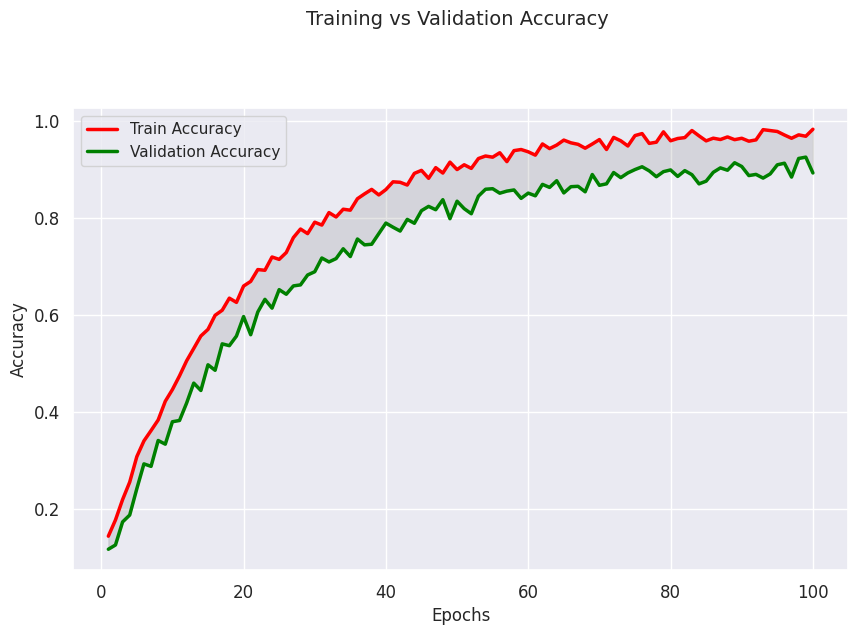

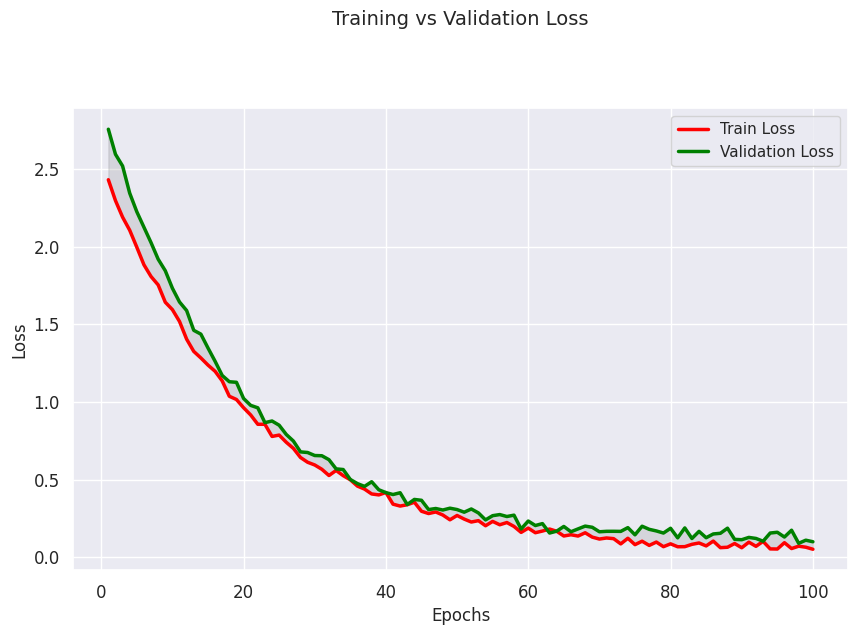

In [137]:
plot_learning(history_model)

In [138]:
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        # Currently, memory growth needs to be the same across GPUs
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        logical_gpus = tf.config.experimental.list_logical_devices('GPU')
        print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
    except RuntimeError as e:
        # Memory growth must be set before GPUs have been initialized
        print(e)


1 Physical GPUs, 1 Logical GPUs


In [ ]:
# Evaluating performance on test set

results = model.evaluate(test_ds)

print("Loss of the model  is - test ", results[0])
print("Accuracy of the model is - test", results[1]*100, "%\n")


results = model.evaluate(val_ds)

print("Loss of the model  is - val ", results[0])
print("Accuracy of the model is - val", results[1]*100, "%\n")

results = model.evaluate(train_ds)

print("Loss of the model  is - train ", results[0])
print("Accuracy of the model is - train", results[1]*100, "%")

In [140]:
from sklearn.metrics import classification_report

predictions = np.array([])
labels =  np.array([])
for x, y in test_ds:
    y_pred = np.argmax(model.predict(x, verbose=0),axis=1)
    predictions = np.concatenate([predictions, y_pred])
    labels = np.concatenate([labels, y.numpy()])

              precision    recall  f1-score   support

      Action       0.90      0.91      0.90       310
   Animation       0.92      0.91      0.92       349
     Romance       0.88      0.90      0.89       348
      Horror       0.91      0.88      0.90       337

    accuracy                           0.90      1344
   macro avg       0.90      0.90      0.90      1344
weighted avg       0.90      0.90      0.90      1344



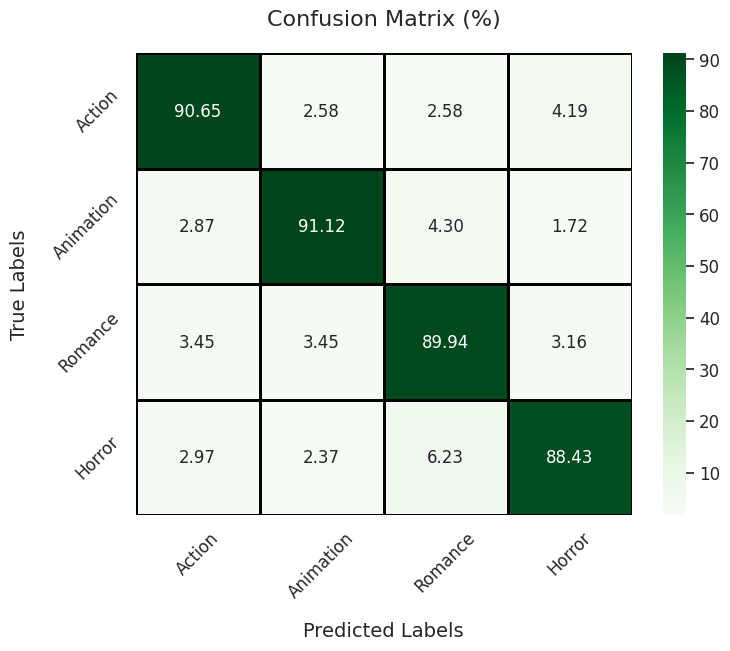

In [141]:
import numpy as np
from sklearn.metrics import classification_report, confusion_matrix

# Initialize empty lists for true labels and predictions
true_labels = []
predicted_labels = []

# Iterate through the test dataset to obtain predictions
for x, y in test_ds:
    y_pred = np.argmax(model.predict(x), axis=1)
    true_labels.extend(y.numpy())
    predicted_labels.extend(y_pred)

# Convert lists to numpy arrays
true_labels = np.array(true_labels)
predicted_labels = np.array(predicted_labels)

# Print classification report
print(classification_report(true_labels, predicted_labels,
                            target_names=['Action', 'Animation', 'Romance','Horror']))

# Create confusion matrix
cm = confusion_matrix(true_labels, predicted_labels)

# Display confusion matrix
print("\nConfusion Matrix:")
print(cm)


(32, 120, 120, 3)
(32,)
(32, 120, 120, 3)
(32,)


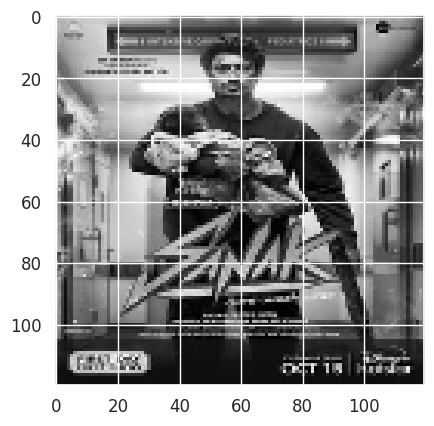

In [142]:
for images, labels in test_ds.take(2):
    plt.imshow(images[0].numpy().astype("uint8"))
    print(images.shape)
    print(labels.shape)

              precision    recall  f1-score   support

      Action       0.93      0.91      0.92       310
   Animation       0.88      0.91      0.90       349
     Romance       0.91      0.89      0.90       348
      Horror       0.88      0.88      0.88       337

    accuracy                           0.90      1344
   macro avg       0.90      0.90      0.90      1344
weighted avg       0.90      0.90      0.90      1344



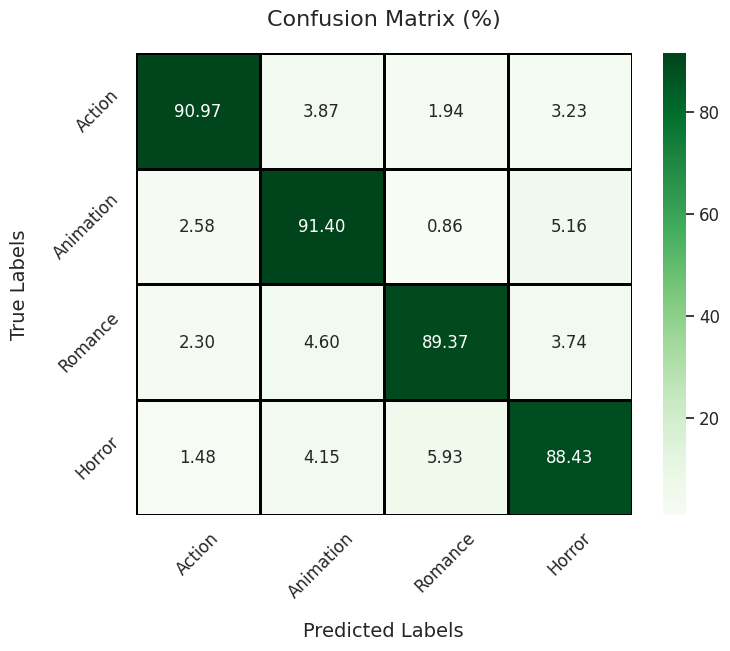

In [146]:
import numpy as np
from sklearn.metrics import classification_report, confusion_matrix

# Initialize empty lists for true labels and predictions
true_labels = []
predicted_labels = []

# Iterate through the test dataset to obtain predictions
for x, y in test_ds:
    y_pred = np.argmax(model.predict(x), axis=1)
    true_labels.extend(y.numpy())
    predicted_labels.extend(y_pred)

# Convert lists to numpy arrays
true_labels = np.array(true_labels)
predicted_labels = np.array(predicted_labels)

# Print classification report
print(classification_report(true_labels, predicted_labels,
                            target_names=['Action', 'Animation', 'Romance','Horror']))

# Create confusion matrix
cm = confusion_matrix(true_labels, predicted_labels)

# Display confusion matrix
print("\nConfusion Matrix:")
print(cm)


1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
Actual: Horror, Predicted: Horror, Confidence: 99.86%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
Actual: Horror, Predicted: Horror, Confidence: 99.97%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Actual: Animation, Predicted: Animation, Confidence: 100.00%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
Actual: Horror, Predicted: Horror, Confidence: 99.96%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Actual: Action, Predicted: Action, Confidence: 99.73%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Actual: Animation, Predicted: Animation, Confidence: 100.00%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Actual: Animation, Predicted: Animation, Confidence: 99.81%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Actual: Animation, Predicted: Animation, Confidence: 100.00%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
Actual: Horror, Predicted: Horror, Confidence: 87.49%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Actual: Horror, Predicted: Animation, Confidence: 96.29%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Actual: Animat

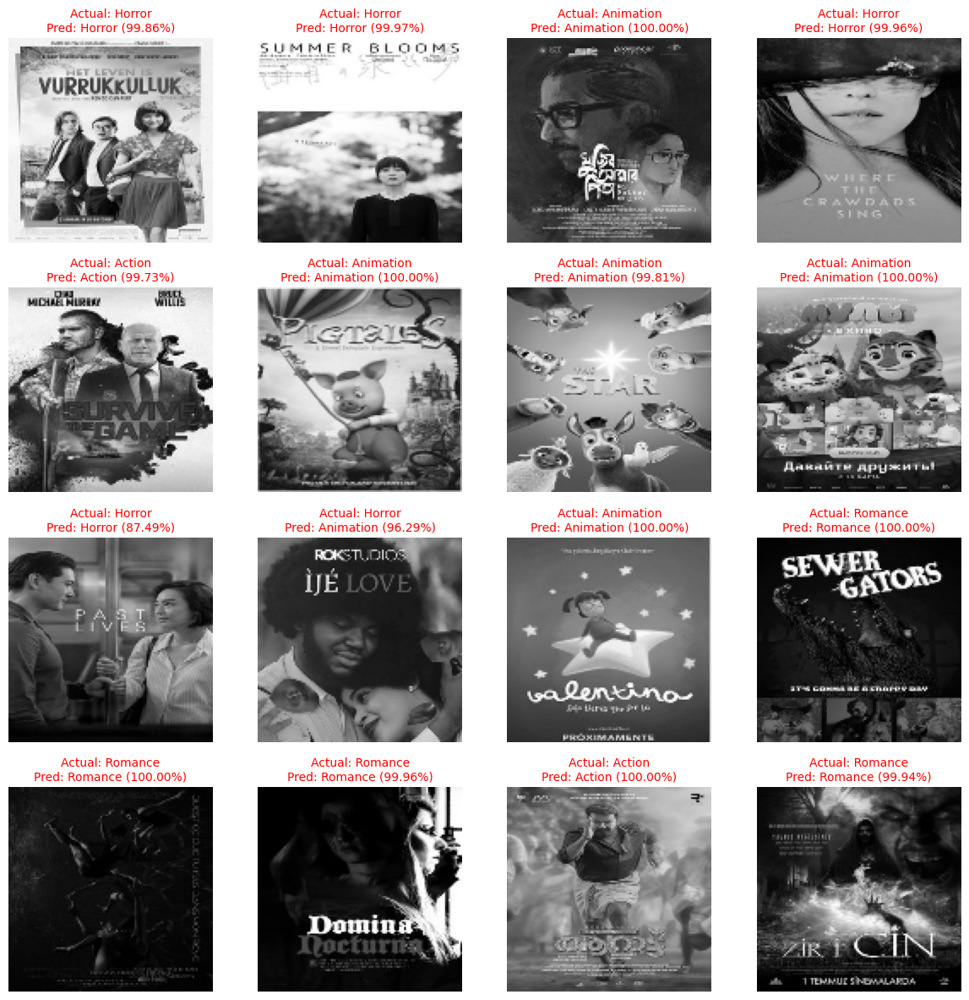

In [147]:
import matplotlib.pyplot as plt
import numpy as np

# Define class names
class_names = ['Action', 'Animation', 'Romance','Horror']  

# Grid size
rows, cols = 4, 4  

# Take a batch of images and labels from test dataset
for images, labels in train_ds.take(1):  
    plt.figure(figsize=(12, 12))  

    for i in range(min(rows * cols, len(images))):  
        plt.subplot(rows, cols, i + 1)  
        plt.imshow(images[i].numpy().astype("uint8"))  
        plt.axis("off")  

        # Ensure input shape is correct
        img = np.expand_dims(images[i].numpy(), axis=0)  

        # Get model predictions
        predictions = model.predict(img)  
        predicted_class = np.argmax(predictions)  
        confidence = np.max(predictions) * 100  

        # Get actual label
        actual_label = class_names[labels[i].numpy()]  
        predicted_label = class_names[predicted_class]  

        # Debugging: Print actual vs predicted
        print(f"Actual: {actual_label}, Predicted: {predicted_label}, Confidence: {confidence:.2f}%")

        # Display predictions
        plt.title(f"Actual: {actual_label}\nPred: {predicted_label} ({confidence:.2f}%)", fontsize=10, color="red")

    plt.tight_layout()  
    plt.show()


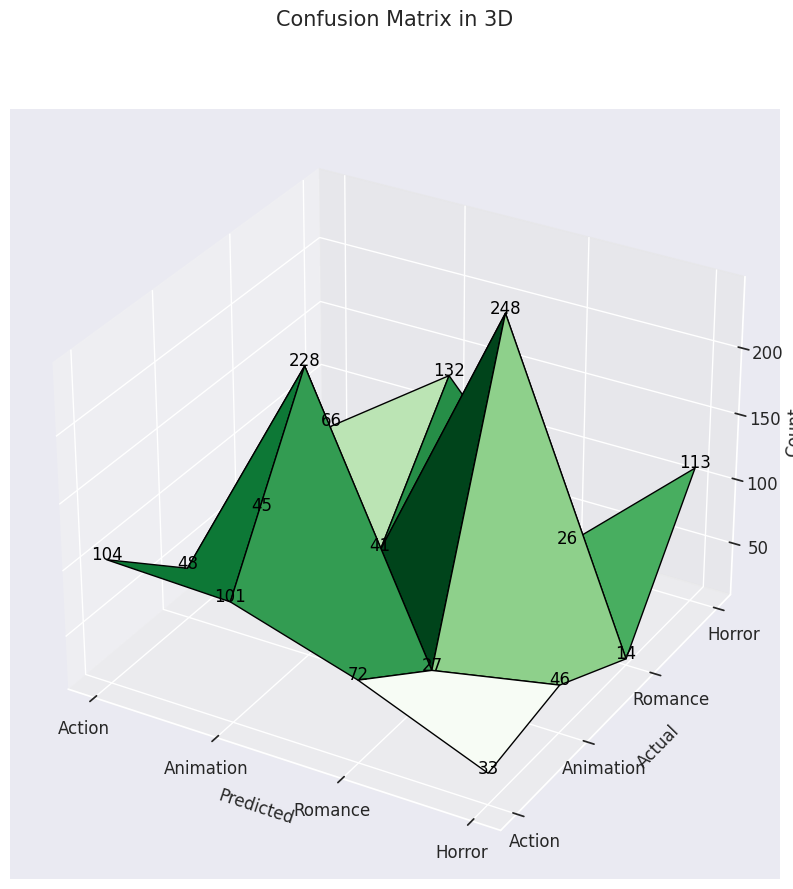

In [148]:
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns

def plot_confusion_matrix_3d(cm, class_names):
    """
    Plots a 3D surface plot for the confusion matrix.
    """
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')

    # Create the X and Y grid for the confusion matrix
    x, y = np.meshgrid(np.arange(cm.shape[0]), np.arange(cm.shape[1]))

    # Plotting the surface
    ax.plot_surface(x, y, cm, cmap='Greens', edgecolor='black', linewidth=1)

    # Annotate the surface with text (values from the confusion matrix)
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(x[i, j], y[i, j], cm[i, j], str(cm[i, j]), color='black', fontsize=12, ha='center')

    # Set labels for axes
    ax.set_xlabel('Predicted')
    ax.set_ylabel('Actual')
    ax.set_zlabel('Count')

    # Set ticks for X and Y axes based on class names
    ax.set_xticks(np.arange(cm.shape[1]))
    ax.set_yticks(np.arange(cm.shape[0]))
    ax.set_xticklabels(class_names)
    ax.set_yticklabels(class_names)

    # Set title
    ax.set_title('Confusion Matrix in 3D',pad=60)

    # Show the plot
    plt.show()
#["china fan dance", "Sword Dance", "dragon dance images"]
# Example usage:
# Assuming you have a confusion matrix `cm` and class names in `class_names`
class_names = ['Action', 'Animation', 'Romance','Horror']  # Modify with your actual class names
plot_confusion_matrix_3d(cm, class_names)


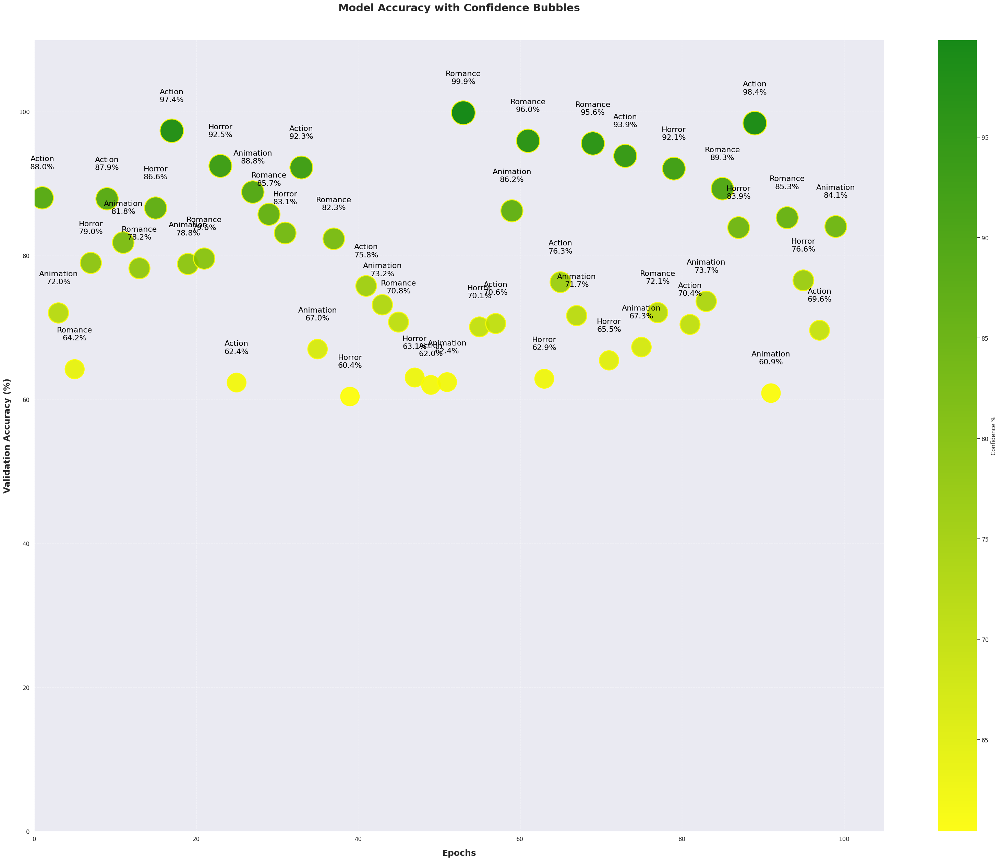

In [149]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import LinearSegmentedColormap

def bubble_accuracy_plot(history, epochs, class_names):
    fig, ax = plt.subplots(figsize=(40, 30))  # Enlarged plot

    total_epochs = len(epochs)
    step = max(1, total_epochs // 40)  # Adjust step for more bubbles
    x_data = np.arange(1, total_epochs + 1, step)
    y_data = np.array(history)[::step]  # Selecting reduced accuracy values
    sizes = y_data * 25  # Increased bubble size
    colors = y_data

    # Custom colormap
    yellow_green_cmap = LinearSegmentedColormap.from_list("yellow_green", ["yellow", "green"])

    scatter = ax.scatter(x_data, y_data, s=sizes, c=colors, cmap=yellow_green_cmap, alpha=0.9, edgecolors='yellow', linewidth=2)

    ax.set_xlabel("Epochs", fontsize=18, weight='bold', labelpad=15)
    ax.set_ylabel("Validation Accuracy (%)", fontsize=18, weight='bold', labelpad=15)
    ax.set_title("Model Accuracy with Confidence Bubbles", fontsize=22, weight='bold', pad=60)

    cbar = plt.colorbar(scatter, ax=ax, label='Confidence %')
    ax.set_ylim(0, 110)
    ax.set_xlim(0, total_epochs + 5)
    plt.grid(True, linestyle='--', alpha=0.8)
    ax.margins(0.15, 0.25)

    for i, txt in enumerate(y_data):
        ax.text(x_data[i], min(y_data[i] + 4, 105),  
                f'{class_names[i % len(class_names)]}\n{txt:.1f}%', 
                ha='center', fontsize=16, color='black')
    
    plt.show()

# Example call
epochs = np.arange(1, 101)  # Increased number of epochs
history = np.random.uniform(60, 100, len(epochs))  # Simulated accuracy values
class_names = ['Action', 'Animation', 'Romance','Horror']
bubble_accuracy_plot(history, epochs, class_names)


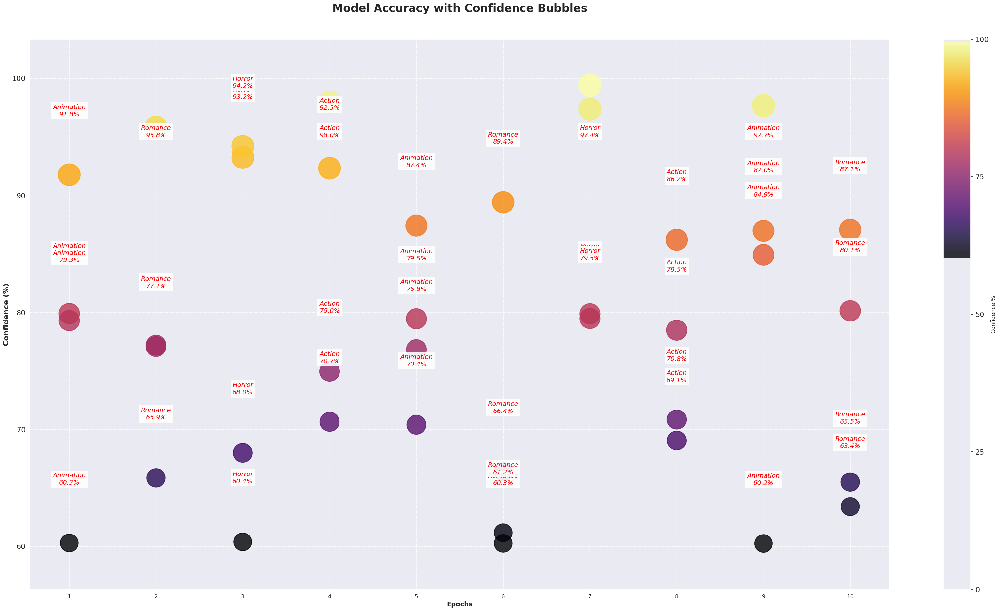

In [150]:
import matplotlib.pyplot as plt
import numpy as np

# Define class names (Modify based on your dataset)
class_names = ['Action', 'Animation', 'Romance', 'Horror']

# Number of epochs for plotting
epochs = np.arange(1, 11)

# Create a larger plot
fig, ax = plt.subplots(figsize=(35, 20))

# Set labels for axes and title
ax.set_xlabel('Epochs', fontsize=14, weight='bold')
ax.set_ylabel('Confidence (%)', fontsize=16, weight='bold')
ax.set_title('Model Accuracy with Confidence Bubbles', fontsize=24, weight='bold', pad=60)

# Variables to store bubble data
x_data = []
y_data = []
sizes = []
colors = []

# Generate random data for demonstration
for epoch in epochs:
    for class_idx in range(len(class_names)):
        confidence = np.random.uniform(0.60, 1.00) * 100
        
        x_data.append(epoch)
        y_data.append(confidence)
        sizes.append(confidence * 25)
        colors.append(confidence)

# Scatter plot with deep colors
scatter = ax.scatter(x_data, y_data, s=sizes, c=colors, cmap='inferno', alpha=0.8, linewidth=1.5)

# Add color bar
cbar = plt.colorbar(scatter, ax=ax, label='Confidence %')
cbar.set_ticks([0, 25, 50, 75, 100])
cbar.ax.tick_params(labelsize=16)

# Adjust spacing for labels to avoid overlap
for i in range(len(x_data)):
    label_x = x_data[i]
    label_y = y_data[i] + 5

    if label_y > 100:
        label_y = 95
    elif label_y < 10:
        label_y = 15

    ax.text(label_x, label_y, f'{class_names[x_data[i] % len(class_names)]}\n{y_data[i]:.1f}%', 
            ha='center', fontsize=14, color='Red', fontstyle='italic',
            bbox=dict(facecolor='White', edgecolor='None', alpha=0.9))

# Keep grid as is
ax.set_xticks(epochs)
ax.set_yticks(np.arange(0, 110, 10))
ax.set_yticklabels(np.arange(0, 110, 10), fontsize=16)
ax.grid(True, linestyle='--', alpha=0.9)

# Layout adjustments
ax.margins(x=0.05, y=0.1)
plt.tight_layout(pad=5.0)

# Show plot
plt.show()


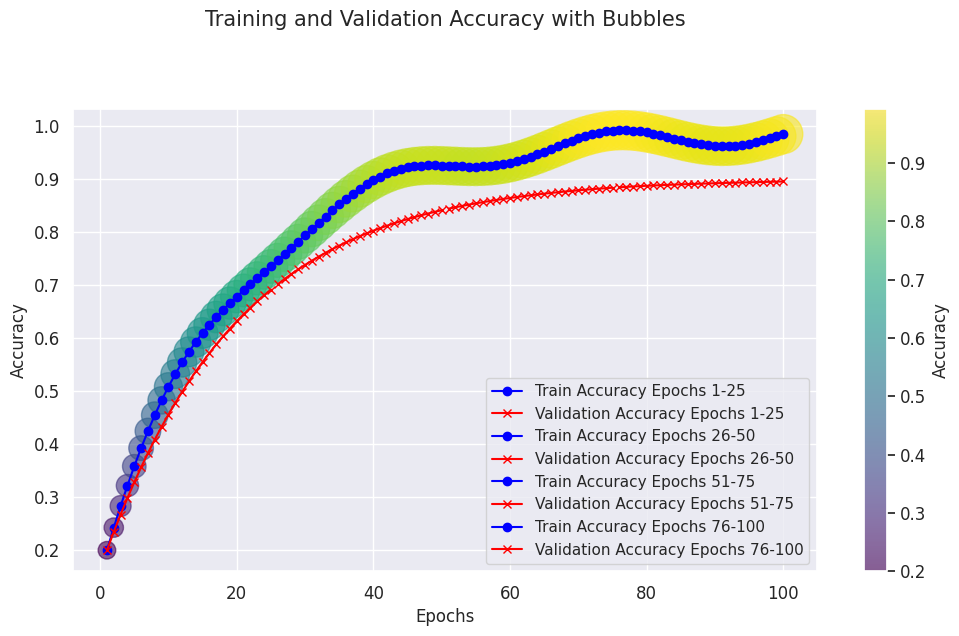

In [151]:
import matplotlib.pyplot as plt
import numpy as np

def plot_accuracy_with_bubbles(history_model_net):
    """
    Plots training and validation accuracy with bubbles for different epoch ranges.
    """
    epochs = np.arange(1, len(history_model_net.history['accuracy']) + 1)
    
    # Split the epochs and accuracy into different ranges (1-25, 26-50, 51-75, 76-100)
    epoch_ranges = [(1, 25), (26, 50), (51, 75), (76, 100)]
    accuracies = {
        'train': history_model_net.history['accuracy'],
        'val': history_model_net.history['val_accuracy']
    }
    
    # Create a 2D plot
    fig, ax = plt.subplots(figsize=(12, 6))
    
    # Set labels for axes
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Accuracy')
    
    # Variables to store bubble data
    x_data = []
    y_data = []
    sizes = []  # Bubble sizes (based on accuracy)
    colors = []  # Bubble colors (for visualization)
    
    # Plot training accuracy with bubbles and lines for each epoch range
    for start, end in epoch_ranges:
        # Get the relevant epoch range
        train_accuracy_range = accuracies['train'][start-1:end]
        val_accuracy_range = accuracies['val'][start-1:end]
        epoch_range = epochs[start-1:end]
        
        # Add bubbles for train accuracy
        for i, acc in enumerate(train_accuracy_range):
            x_data.append(epoch_range[i])
            y_data.append(acc)
            sizes.append(acc * 800)  # Bubble size based on accuracy
            colors.append(acc)  # Color based on accuracy
        
        # Add lines between bubbles
        ax.plot(epoch_range, train_accuracy_range, label=f'Train Accuracy Epochs {start}-{end}', marker='o', linestyle='-', color='blue')
        ax.plot(epoch_range, val_accuracy_range, label=f'Validation Accuracy Epochs {start}-{end}', marker='x', linestyle='-', color='green')

    # Scatter plot with bubbles
    scatter = ax.scatter(x_data, y_data, s=sizes, c=colors, cmap='viridis', alpha=0.6)

    # Add color bar for accuracy
    plt.colorbar(scatter, ax=ax, label='Accuracy')

    # Add title and legend
    ax.set_title('Training and Validation Accuracy with Bubbles',pad=60)
    ax.legend()
    
    # Show the plot
    plt.show()

# Call the function with your model history
plot_accuracy_with_bubbles(history_model_net)


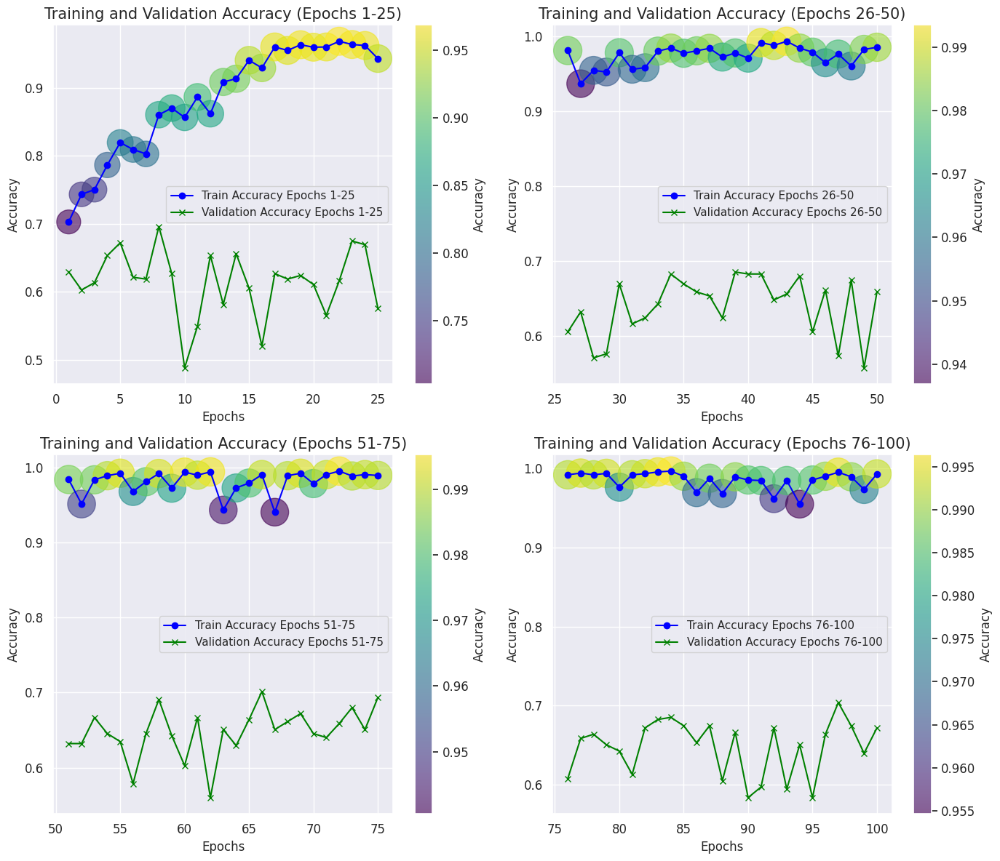

In [152]:
import matplotlib.pyplot as plt
import numpy as np

def plot_accuracy_with_bubbles_separated(history_model_net):
    """
    Plots training and validation accuracy in separate subplots for each epoch range (1-25, 26-50, 51-75, 76-100).
    """
    epochs = np.arange(1, len(history_model_net.history['accuracy']) + 1)
    
    # Split the epochs and accuracy into different ranges (1-25, 26-50, 51-75, 76-100)
    epoch_ranges = [(1, 25), (26, 50), (51, 75), (76, 100)]
    accuracies = {
        'train': history_model_net.history['accuracy'],
        'val': history_model_net.history['val_accuracy']
    }
    
    # Create subplots for each epoch range
    fig, axes = plt.subplots(2, 2, figsize=(14, 12))  # 2x2 grid for 4 subplots
    axes = axes.flatten()  # Flatten to easily iterate over

    # Iterate through each epoch range and plot on corresponding subplot
    for idx, (start, end) in enumerate(epoch_ranges):
        ax = axes[idx]
        
        # Get the relevant epoch range
        train_accuracy_range = accuracies['train'][start-1:end]
        val_accuracy_range = accuracies['val'][start-1:end]
        epoch_range = epochs[start-1:end]
        
        # Variables to store bubble data
        x_data = []
        y_data = []
        sizes = []  # Bubble sizes (based on accuracy)
        colors = []  # Bubble colors (for visualization)
        
        # Add bubbles for train accuracy
        for i, acc in enumerate(train_accuracy_range):
            x_data.append(epoch_range[i])
            y_data.append(acc)
            sizes.append(acc * 800)  # Bubble size based on accuracy
            colors.append(acc)  # Color based on accuracy
        
        # Add lines between bubbles
        ax.plot(epoch_range, train_accuracy_range, label=f'Train Accuracy Epochs {start}-{end}', marker='o', linestyle='-', color='blue')
        ax.plot(epoch_range, val_accuracy_range, label=f'Validation Accuracy Epochs {start}-{end}', marker='x', linestyle='-', color='green')

        # Scatter plot with bubbles
        scatter = ax.scatter(x_data, y_data, s=sizes, c=colors, cmap='viridis', alpha=0.6)

        # Set labels for axes
        ax.set_xlabel('Epochs')
        ax.set_ylabel('Accuracy')
        
        # Add color bar for accuracy
        plt.colorbar(scatter, ax=ax, label='Accuracy')
        
        # Add title and legend
        ax.set_title(f'Training and Validation Accuracy (Epochs {start}-{end})')
        ax.legend()

    # Adjust layout to prevent overlap
    plt.tight_layout()

    # Show the plot
    plt.show()

# Call the function with your model history
plot_accuracy_with_bubbles_separated(history_model_net)


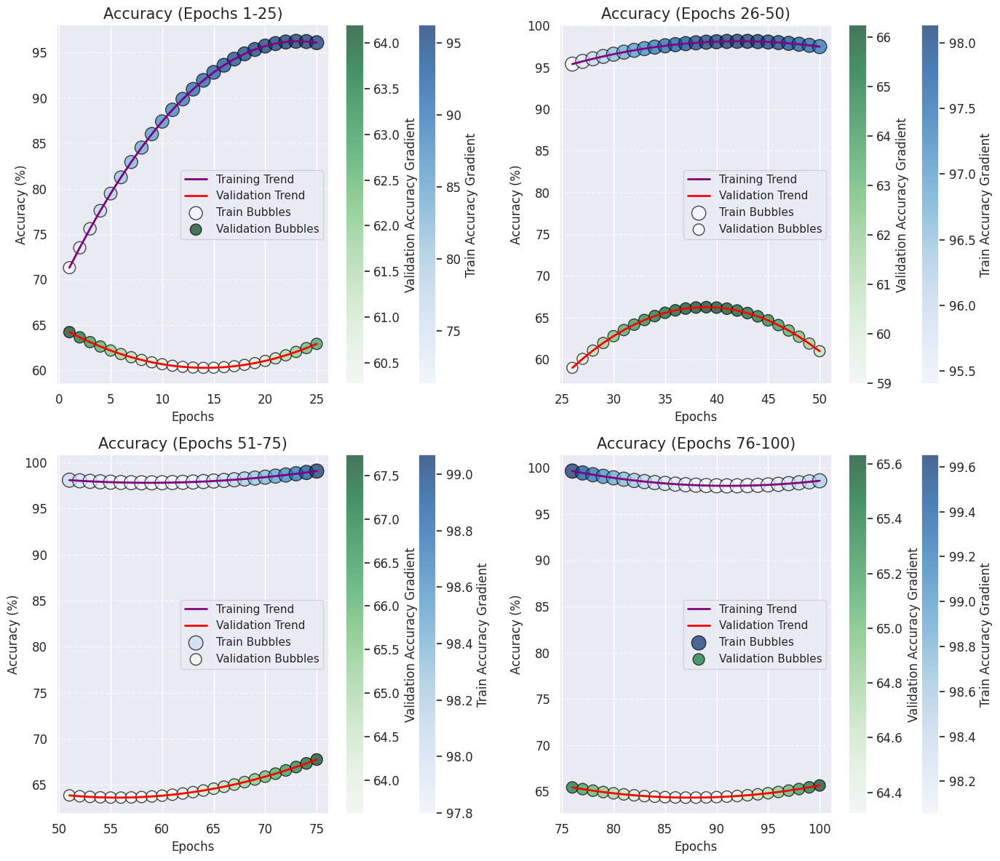

In [153]:
import matplotlib.pyplot as plt
import numpy as np

def plot_accuracy_with_bubbles_combined(history_model_net):
    """
    Plots training and validation accuracy with bubble trend visualization in separate subplots for epoch ranges.
    """
    epochs = np.arange(1, len(history_model_net.history['accuracy']) + 1)
    
    # Split the epochs and accuracy into different ranges (1-25, 26-50, 51-75, 76-100)
    epoch_ranges = [(1, 25), (26, 50), (51, 75), (76, 100)]
    accuracies = {
        'train': np.array(history_model_net.history['accuracy']) * 100,  # Convert to percentage
        'val': np.array(history_model_net.history['val_accuracy']) * 100
    }
    
    # Create subplots for each epoch range
    fig, axes = plt.subplots(2, 2, figsize=(14, 12))  # 2x2 grid for 4 subplots
    axes = axes.flatten()  # Flatten to easily iterate over

    for idx, (start, end) in enumerate(epoch_ranges):
        ax = axes[idx]
        
        # Get the relevant epoch range
        epoch_range = epochs[start-1:end]
        train_accuracy_range = accuracies['train'][start-1:end]
        val_accuracy_range = accuracies['val'][start-1:end]
        
        # Fit polynomial trend lines
        z_train = np.polyfit(epoch_range, train_accuracy_range, deg=2)
        p_train = np.poly1d(z_train)
        y_train_trend = p_train(epoch_range)

        z_val = np.polyfit(epoch_range, val_accuracy_range, deg=2)
        p_val = np.poly1d(z_val)
        y_val_trend = p_val(epoch_range)

        # Plot trend lines
        ax.plot(epoch_range, y_train_trend, color='purple', linewidth=2, linestyle='-', label='Training Trend')
        ax.plot(epoch_range, y_val_trend, color='red', linewidth=2, linestyle='-', label='Validation Trend')

        # Bubble sizes & colors
        sizes_train = y_train_trend * 2  
        sizes_val = y_val_trend * 2  

        scatter_train = ax.scatter(epoch_range, y_train_trend, s=sizes_train, c=y_train_trend, cmap='Blues', alpha=0.7, edgecolors='black', label='Train Bubbles')
        scatter_val = ax.scatter(epoch_range, y_val_trend, s=sizes_val, c=y_val_trend, cmap='Greens', alpha=0.7, edgecolors='black', label='Validation Bubbles')

        # Formatting
        ax.set_xlabel("Epochs")
        ax.set_ylabel("Accuracy (%)")
        ax.set_title(f'Accuracy (Epochs {start}-{end})')
        ax.grid(axis='y', linestyle='--', alpha=0.7)
        ax.legend()

        # Colorbars
        plt.colorbar(scatter_train, ax=ax, label="Train Accuracy Gradient")
        plt.colorbar(scatter_val, ax=ax, label="Validation Accuracy Gradient")

    # Adjust layout
    plt.tight_layout()
    plt.show()

# Call the function with your model history
plot_accuracy_with_bubbles_combined(history_model_net)


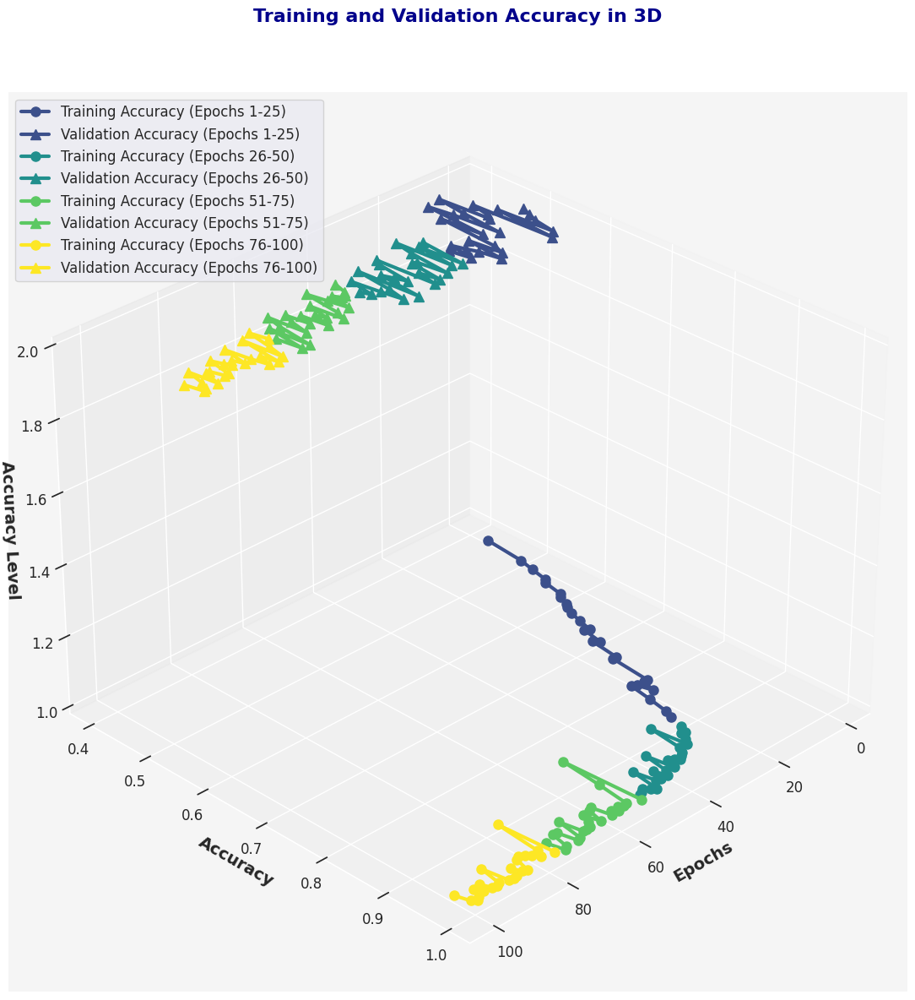

In [154]:
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D  # Importing 3D plotting module
from matplotlib import cm
from matplotlib.colors import Normalize

def plot_accuracy_with_3d_lines(history_model):
    """
    Plots training and validation accuracy in separate 3D subplots for each epoch range (1-25, 26-50, 51-75, 76-100).
    Adds enhancements such as color gradients for a stunning 3D effect.
    """
    epochs = np.arange(1, len(history_model.history['accuracy']) + 1)
    
    # Split the epochs and accuracy into different ranges (1-25, 26-50, 51-75, 76-100)
    epoch_ranges = [(1, 25), (26, 50), (51, 75), (76, 100)]
    accuracies = {
        'train': history_model.history['accuracy'],
        'val': history_model.history['val_accuracy']
    }
    
    # Create a figure for the 3D plot
    fig = plt.figure(figsize=(14, 12))
    ax = fig.add_subplot(111, projection='3d')  # 3D subplot
    
    # Set the colormap and normalize the values for color gradients
    cmap = cm.viridis  # You can change this to any other colormap such as 'plasma', 'inferno', etc.
    norm = Normalize(vmin=1, vmax=100)

    # Loop through each epoch range and plot on corresponding subplot
    for idx, (start, end) in enumerate(epoch_ranges):
        # Get the relevant epoch range
        train_accuracy_range = accuracies['train'][start-1:end]
        val_accuracy_range = accuracies['val'][start-1:end]
        epoch_range = epochs[start-1:end]
        
        # Color gradient based on epoch number
        train_colors = cmap(norm(epoch_range))  # Apply colormap to training accuracy
        val_colors = cmap(norm(epoch_range))    # Apply colormap to validation accuracy

        # 3D plot for training accuracy
        ax.plot(epoch_range, train_accuracy_range, zs=1, label=f'Training Accuracy (Epochs {start}-{end})', marker='o', color=train_colors[-1], linewidth=3, markersize=8)
        
        # 3D plot for validation accuracy
        ax.plot(epoch_range, val_accuracy_range, zs=2, label=f'Validation Accuracy (Epochs {start}-{end})', marker='^', color=val_colors[-1], linewidth=3, markersize=8)

    # Set labels with improved styling
    ax.set_xlabel('Epochs', fontsize=14, fontweight='bold')
    ax.set_ylabel('Accuracy', fontsize=14, fontweight='bold')
    ax.set_zlabel('Accuracy Level', fontsize=14, fontweight='bold')

    # Set title with improved styling
    ax.set_title('Training and Validation Accuracy in 3D', fontsize=16,pad=60, fontweight='bold', color='darkblue')

    # Customize the grid and background for better aesthetics
    ax.grid(True, color='gray', linestyle='--', linewidth=0.5)
    ax.set_facecolor('whitesmoke')
    
    # Adjust the view angle for better clarity
    ax.view_init(30, 45)

    # Add a legend with better positioning
    ax.legend(loc='upper left', fontsize=12)

    # Show the plot
    plt.tight_layout()
    plt.show()

# Call the function with your model history
plot_accuracy_with_3d_lines(history_model)


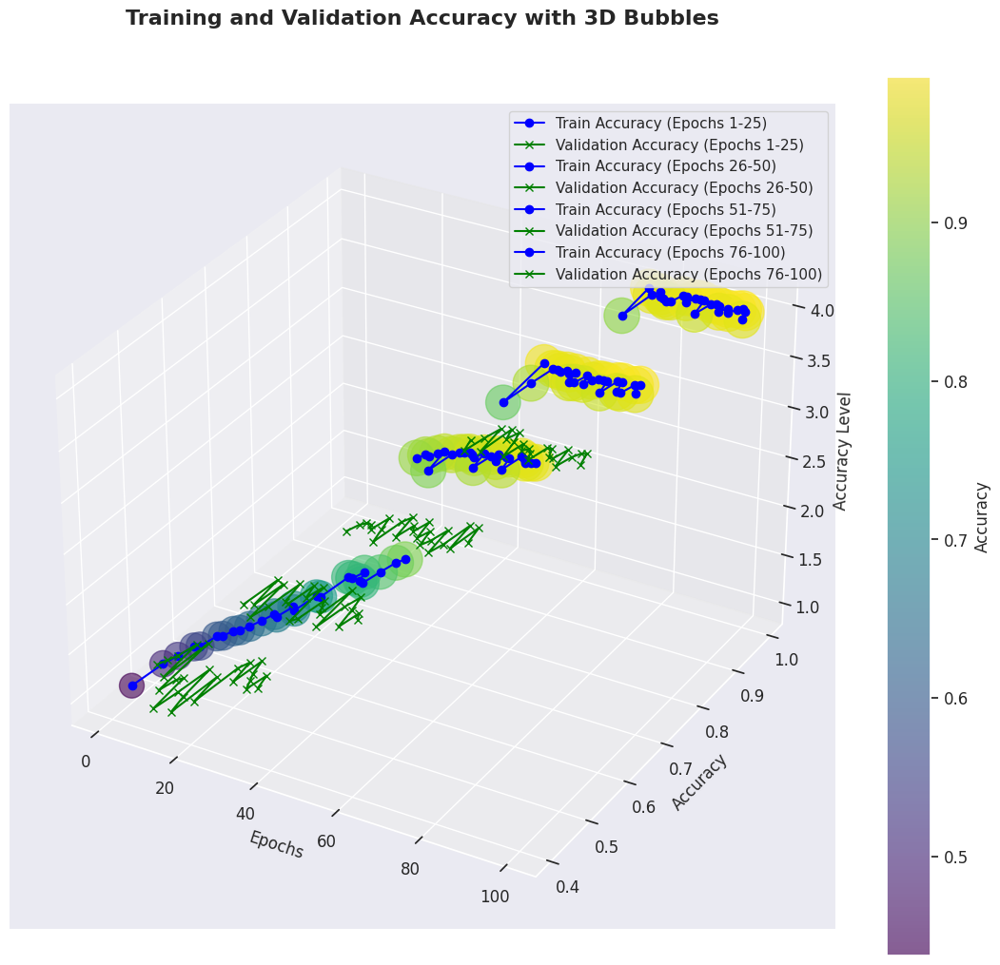

In [155]:
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D  # Importing 3D plotting module

def plot_accuracy_with_3d_bubbles(history_model):
    """
    Plots training and validation accuracy with 3D bubbles for different epoch ranges.
    """
    epochs = np.arange(1, len(history_model.history['accuracy']) + 1)
    
    # Split the epochs and accuracy into different ranges (1-25, 26-50, 51-75, 76-100)
    epoch_ranges = [(1, 25), (26, 50), (51, 75), (76, 100)]
    accuracies = {
        'train': history_model.history['accuracy'],
        'val': history_model.history['val_accuracy']
    }
    
    # Create a 3D plot
    fig = plt.figure(figsize=(14, 12))
    ax = fig.add_subplot(111, projection='3d')
    
    # Set labels for axes
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Accuracy')
    ax.set_zlabel('Accuracy Level')
    
    # Variables to store bubble data
    x_data = []
    y_data = []
    z_data = []  # Z-axis for different epoch ranges
    sizes = []  # Bubble sizes (based on accuracy)
    colors = []  # Bubble colors (for visualization)
    
    # Plot training accuracy with bubbles and lines for each epoch range
    for idx, (start, end) in enumerate(epoch_ranges):
        # Get the relevant epoch range
        train_accuracy_range = accuracies['train'][start-1:end]
        val_accuracy_range = accuracies['val'][start-1:end]
        epoch_range = epochs[start-1:end]
        
        # Add bubbles for train accuracy
        for i, acc in enumerate(train_accuracy_range):
            x_data.append(epoch_range[i])
            y_data.append(acc)
            z_data.append(idx + 1)  # Different z values based on epoch range (1, 2, 3, 4)
            sizes.append(acc * 800)  # Bubble size based on accuracy
            colors.append(acc)  # Color based on accuracy
        
        # Add lines between bubbles (for train and validation accuracy)
        ax.plot(epoch_range, train_accuracy_range, zs=idx + 1, label=f'Train Accuracy (Epochs {start}-{end})', marker='o', linestyle='-', color='blue')
        ax.plot(epoch_range, val_accuracy_range, zs=idx + 1, label=f'Validation Accuracy (Epochs {start}-{end})', marker='x', linestyle='-', color='green')

    # Scatter plot with bubbles
    scatter = ax.scatter(x_data, y_data, z_data, s=sizes, c=colors, cmap='viridis', alpha=0.6)

    # Add color bar for accuracy
    plt.colorbar(scatter, ax=ax, label='Accuracy')

    # Add title and legend
    ax.set_title('Training and Validation Accuracy with 3D Bubbles',pad=60, fontsize=16, fontweight='bold')
    ax.legend()

    # Show the plot
    plt.show()

# Call the function with your model history
plot_accuracy_with_3d_bubbles(history_model)


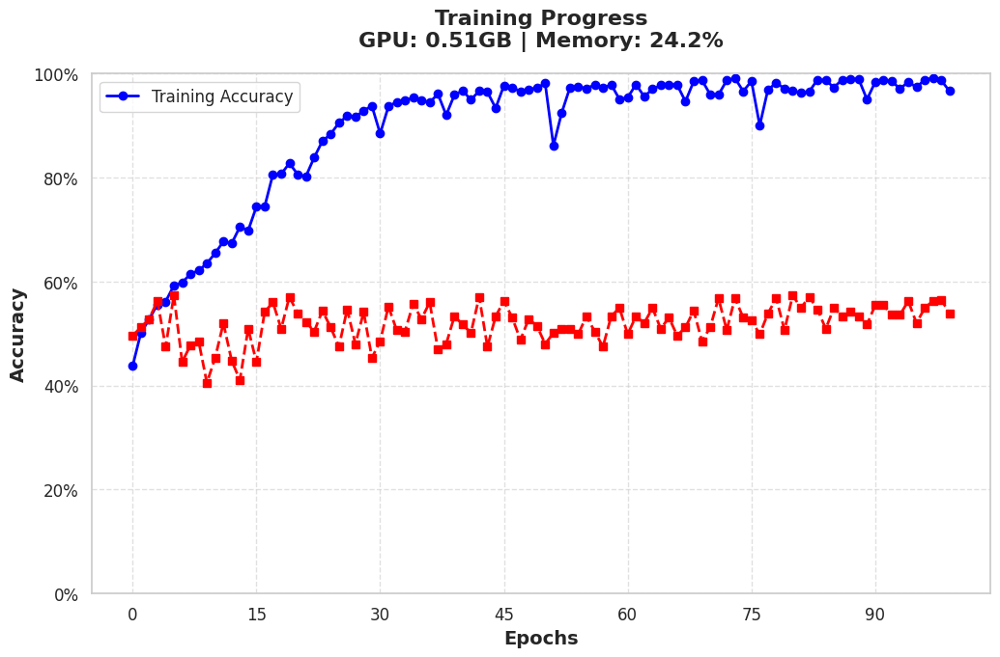

In [156]:
import matplotlib.pyplot as plt
import seaborn as sns
import psutil
import tensorflow as tf

# Get memory usage
memory_usage = psutil.virtual_memory().percent
gpu_info = tf.config.experimental.get_memory_info('GPU:0')
gpu_usage = gpu_info['current'] / 1e9  # Convert bytes to GB

# Set Seaborn style
sns.set_style("whitegrid")

# Create figure
fig, ax = plt.subplots(figsize=(12, 7))

# Plot training and validation accuracy
ax.plot(history_model.history['accuracy'], marker='o', linestyle='-', linewidth=2, markersize=6, label='Training Accuracy', color='blue')
ax.plot(history_model.history['val_accuracy'], marker='s', linestyle='--', linewidth=2, markersize=6,  color='red')

# Highlight max validation accuracy
max_val_acc = max(history_model.history['val_accuracy'])
max_epoch = history_model.history['val_accuracy'].index(max_val_acc)
#ax.scatter(max_epoch, max_val_acc, color='green', s=200, edgecolor='black', label=f'Max Val Acc: {max_val_acc:.2f}')

# Labels and title
ax.set_xlabel('Epochs', fontsize=14, weight='bold')
ax.set_ylabel('Accuracy', fontsize=14, weight='bold')
ax.set_title(f"Training Progress\nGPU: {gpu_usage:.2f}GB | Memory: {memory_usage}%", fontsize=16, weight='bold', pad=20)
ax.legend(fontsize=12)
ax.set_ylim(0, 1)

# Customizing grid and ticks
ax.xaxis.set_major_locator(plt.MaxNLocator(integer=True))
ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.0%}'))
ax.grid(True, linestyle='--', alpha=0.6)

# Show plot
plt.show()


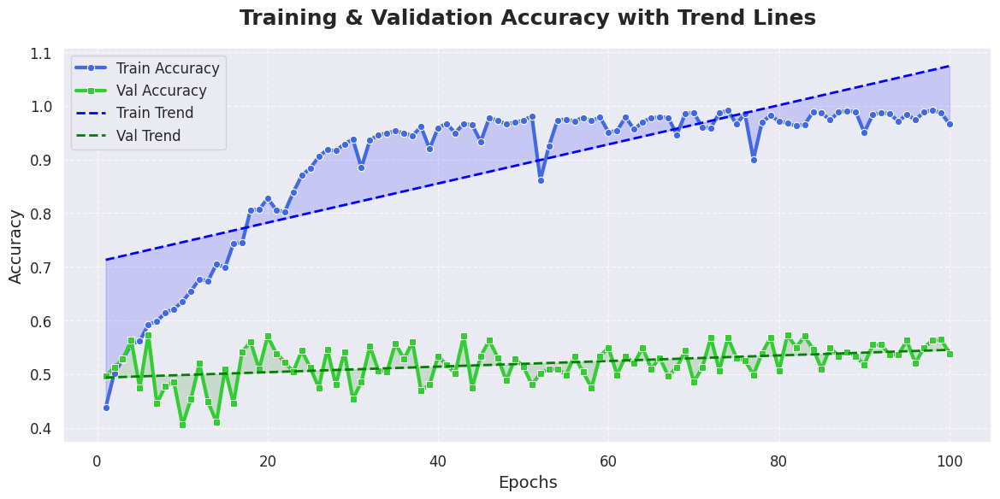

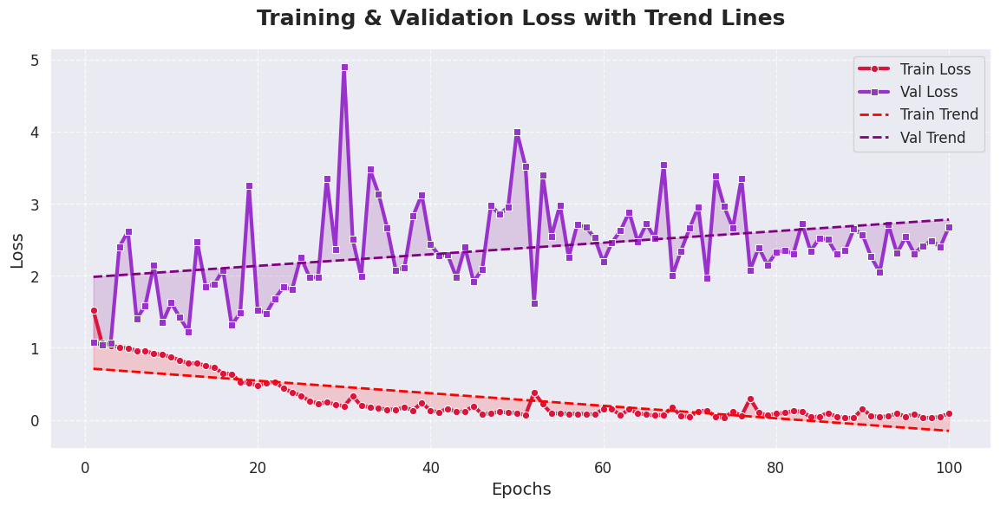

In [157]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)  # Suppress FutureWarnings

import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from scipy.stats import linregress

# Extract training history
epochs = np.arange(1, len(history_model.history['loss']) + 1)

# Create DataFrame for accuracy
df_accuracy = pd.DataFrame({
    'Epochs': epochs,
    'Train Accuracy': history_model.history['accuracy'],
    'Val Accuracy': history_model.history['val_accuracy']
})

# Create DataFrame for loss
df_loss = pd.DataFrame({
    'Epochs': epochs,
    'Train Loss': history_model.history['loss'],
    'Val Loss': history_model.history['val_loss']
})

# Handle any infinite or NaN values to prevent warnings
df_accuracy.replace([np.inf, -np.inf], np.nan, inplace=True)
df_loss.replace([np.inf, -np.inf], np.nan, inplace=True)

df_accuracy.dropna(inplace=True)
df_loss.dropna(inplace=True)

# Compute trend lines using linear regression
def compute_trend(y_values):
    slope, intercept, _, _, _ = linregress(df_accuracy['Epochs'], y_values)
    return slope * df_accuracy['Epochs'] + intercept

# Trend lines for accuracy
train_acc_trend = compute_trend(df_accuracy['Train Accuracy'])
val_acc_trend = compute_trend(df_accuracy['Val Accuracy'])

# Trend lines for loss
train_loss_trend = compute_trend(df_loss['Train Loss'])
val_loss_trend = compute_trend(df_loss['Val Loss'])

# Set Seaborn style
sns.set_style("darkgrid")
sns.set_palette("husl")

## Accuracy Plot ##
plt.figure(figsize=(14, 6))
sns.lineplot(x='Epochs', y='Train Accuracy', data=df_accuracy, label='Train Accuracy', color='royalblue', linewidth=3, marker='o')
sns.lineplot(x='Epochs', y='Val Accuracy', data=df_accuracy, label='Val Accuracy', color='limegreen', linewidth=3, marker='s')

plt.plot(df_accuracy['Epochs'], train_acc_trend, color='blue', linestyle='--', linewidth=2, label='Train Trend')
plt.plot(df_accuracy['Epochs'], val_acc_trend, color='green', linestyle='--', linewidth=2, label='Val Trend')

plt.fill_between(df_accuracy['Epochs'], df_accuracy['Train Accuracy'], train_acc_trend, color='blue', alpha=0.15)
plt.fill_between(df_accuracy['Epochs'], df_accuracy['Val Accuracy'], val_acc_trend, color='green', alpha=0.15)

plt.xlabel('Epochs', fontsize=14)
plt.ylabel('Accuracy', fontsize=14)
plt.title('Training & Validation Accuracy with Trend Lines', fontsize=18, pad=20, fontweight='bold')
plt.legend(fontsize=12, loc='best')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()

## Loss Plot ##
plt.figure(figsize=(14, 6))
sns.lineplot(x='Epochs', y='Train Loss', data=df_loss, label='Train Loss', color='crimson', linewidth=3, marker='o')
sns.lineplot(x='Epochs', y='Val Loss', data=df_loss, label='Val Loss', color='darkorchid', linewidth=3, marker='s')

plt.plot(df_loss['Epochs'], train_loss_trend, color='red', linestyle='--', linewidth=2, label='Train Trend')
plt.plot(df_loss['Epochs'], val_loss_trend, color='purple', linestyle='--', linewidth=2, label='Val Trend')

plt.fill_between(df_loss['Epochs'], df_loss['Train Loss'], train_loss_trend, color='red', alpha=0.15)
plt.fill_between(df_loss['Epochs'], df_loss['Val Loss'], val_loss_trend, color='purple', alpha=0.15)

plt.xlabel('Epochs', fontsize=14)
plt.ylabel('Loss', fontsize=14)
plt.title('Training & Validation Loss with Trend Lines', fontsize=18, pad=20, fontweight='bold')
plt.legend(fontsize=12, loc='best')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()


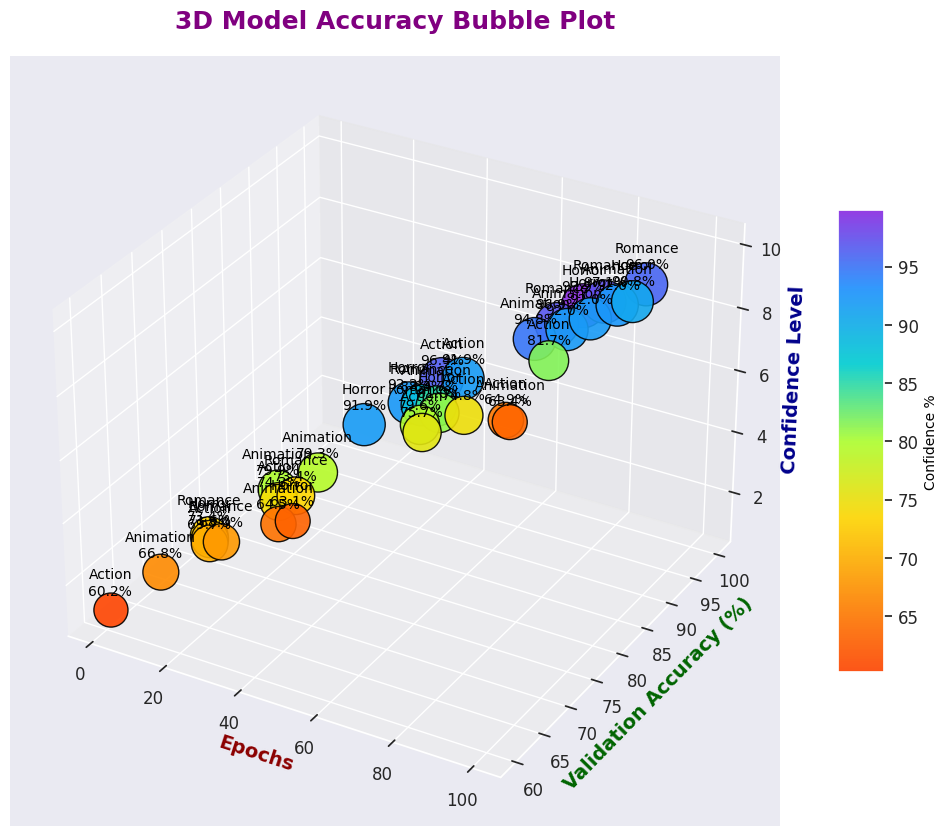

In [158]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import LinearSegmentedColormap
from mpl_toolkits.mplot3d import Axes3D

def bubble_accuracy_plot_3d(history, epochs, class_names):
    fig = plt.figure(figsize=(15, 10))  # Adjusted size
    ax = fig.add_subplot(111, projection='3d')
    
    total_epochs = len(epochs)
    step = max(1, total_epochs // 30)  # Reduce the number of bubbles
    x_data = np.arange(1, total_epochs + 1, step)
    y_data = np.array(history)[::step]  # Selecting reduced accuracy values
    z_data = np.linspace(1, 10, len(y_data))  # Adding a third dimension
    sizes = y_data * 10  # Adjusted bubble size
    colors = y_data

    # Custom colormap with more attractive colors
    vibrant_cmap = LinearSegmentedColormap.from_list("vibrant", ["#FF4500", "#FF8C00", "#FFD700", "#ADFF2F", "#00CED1", "#1E90FF", "#8A2BE2"])
    
    scatter = ax.scatter(x_data, y_data, z_data, s=sizes, c=colors, cmap=vibrant_cmap, alpha=0.9, edgecolors='black', linewidth=1)
    
    ax.set_xlabel("Epochs", fontsize=14, weight='bold', color='darkred')
    ax.set_ylabel("Validation Accuracy (%)", fontsize=14, weight='bold', color='darkgreen')
    ax.set_zlabel("Confidence Level", fontsize=14, weight='bold', color='darkblue')
    ax.set_title("3D Model Accuracy Bubble Plot", fontsize=18, weight='bold', color='purple', pad=20)
    
    cbar = fig.colorbar(scatter, ax=ax, shrink=0.6, aspect=10)
    cbar.set_label("Confidence %", fontsize=10,  color='black')
    
    for i, txt in enumerate(y_data):
        ax.text(x_data[i], y_data[i], z_data[i] + 0.5,  
                f'{class_names[i % len(class_names)]}\n{txt:.1f}%', 
                ha='center', fontsize=10, color='black')
    
    ax.grid(True, linestyle='--', linewidth=0.7, alpha=0.5)
    
    plt.show()

# Example call
epochs = np.arange(1, 101)  # Increased number of epochs
history = np.random.uniform(60, 100, len(epochs))  # Simulated accuracy values
class_names = ['Action', 'Animation', 'Romance','Horror']
bubble_accuracy_plot_3d(history, epochs, class_names)


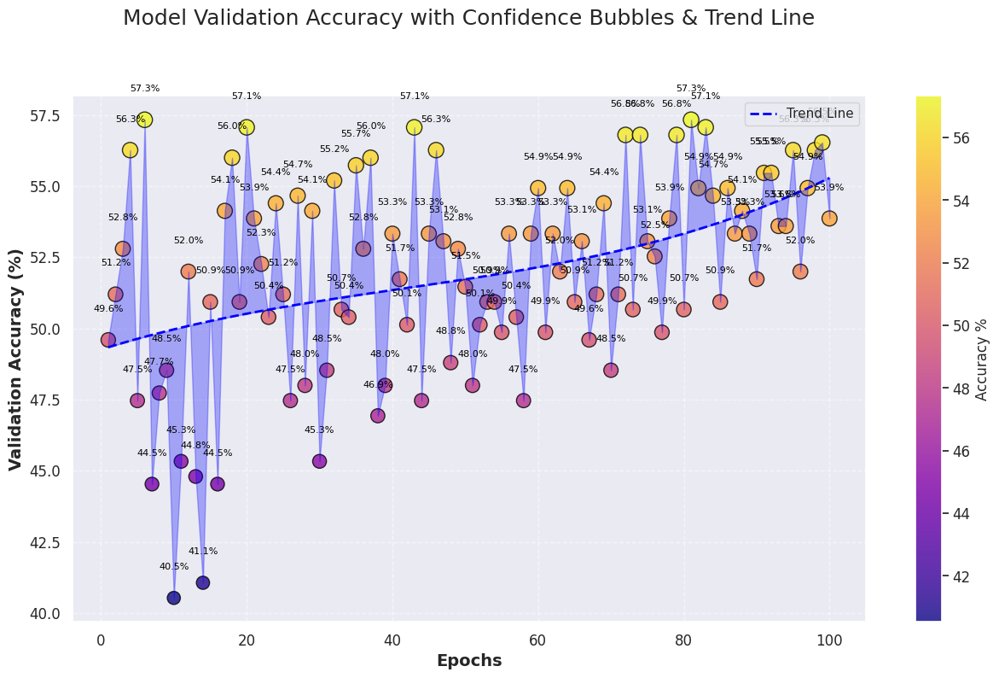

In [159]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def bubble_accuracy_plot(history_model):
    """
    Plots validation accuracy with confidence bubbles & trend line.
    """
    # Extract accuracy values
    train_acc = np.array(history_model.history['accuracy']) * 100  # Convert to %
    val_acc = np.array(history_model.history['val_accuracy']) * 100  # Convert to %
    epochs = len(val_acc)  # Total number of epochs

    # Set up figure
    fig, ax = plt.subplots(figsize=(15, 8))  

    # X-axis (epochs)
    x_data = np.arange(1, epochs + 1)  

    # Bubble sizes & colors
    sizes = val_acc * 3  
    colors = val_acc  

    # Scatter plot with bubbles
    scatter = ax.scatter(x_data, val_acc, s=sizes, c=colors, cmap='plasma', alpha=0.8, edgecolors='black', linewidth=1)

    # Trend line using polynomial fit
    z = np.polyfit(x_data, val_acc, deg=3)  
    p = np.poly1d(z)
    trend_y = p(x_data)
    ax.plot(x_data, trend_y, color='blue', linewidth=2, linestyle='dashed', label="Trend Line")

    # Fill between trend line and actual accuracy
    ax.fill_between(x_data, val_acc, trend_y, color='blue', alpha=0.3)

    # Labels and title
    ax.set_xlabel("Epochs", fontsize=14, weight='bold')
    ax.set_ylabel("Validation Accuracy (%)", fontsize=14, weight='bold')
    ax.set_title("Model Validation Accuracy with Confidence Bubbles & Trend Line", fontsize=18, pad=60)

    # Color bar for accuracy levels
    cbar = plt.colorbar(scatter, ax=ax, label='Accuracy %')

    # Grid for readability
    plt.grid(True, linestyle='--', alpha=0.5)

    # Add epoch labels on bubbles
    for i, txt in enumerate(val_acc):
        ax.text(x_data[i], val_acc[i] + 1, f'{txt:.1f}%', ha='center', fontsize=8, color='black')

    # Legend
    ax.legend()
    
    plt.show()

# Call the function with your model history
bubble_accuracy_plot(history_model)


# NASNetMobile

In [160]:
import tensorflow as tf
from tensorflow.keras.applications import NASNetMobile
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Dropout, GlobalAveragePooling2D, Input, BatchNormalization
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.regularizers import l2

# Define input shape
img_height, img_width = 224, 224
num_classes = 4

# Load NASNetMobile without weights first
nasnet_base = NASNetMobile(weights=None, include_top=False, input_shape=(img_height, img_width, 3))

# Load pre-trained weights manually
weights_path = "/kaggle/input/nasnetmobile/keras/default/1/nasnet_mobile_no_top.h5"
nasnet_base.load_weights(weights_path)

# Freeze first layers, but allow fine-tuning on last layers
for layer in nasnet_base.layers[:-30]:  # Unfreeze last 30 layers
    layer.trainable = False

# Define input tensor
input_tensor = Input(shape=(img_height, img_width, 3))

# Add NASNetMobile base model
x = nasnet_base(input_tensor, training=True)

# Add GlobalAveragePooling2D layer
x = GlobalAveragePooling2D()(x)

# Add Dense layers with Batch Normalization and Dropout
x = Dense(1024, activation='relu', kernel_regularizer=l2(0.0001))(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)

x = Dense(512, activation='relu', kernel_regularizer=l2(0.0001))(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)

x = Dense(256, activation='relu', kernel_regularizer=l2(0.0001))(x)
x = BatchNormalization()(x)
x = Dropout(0.2)(x)

x = Dense(128, activation='relu', kernel_regularizer=l2(0.0001))(x)
x = BatchNormalization()(x)

# Output layer
output_tensor = Dense(num_classes, activation='softmax')(x)

# Create model
model = Model(inputs=input_tensor, outputs=output_tensor)

# Use learning rate scheduling
lr_schedule = tf.keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=0.0005, decay_steps=5000, decay_rate=0.9, staircase=True
)

# Compile the model
model.compile(optimizer=Adam(learning_rate=lr_schedule), loss="categorical_crossentropy", metrics=["accuracy"])

# Print summary
model.summary()

Model: "functional_31"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_6 (InputLayer)           │ (None, 120, 120, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ mobilenet_1.00_None (Functional)     │ (None, 3, 3, 1024)          │       3,228,864 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ global_average_pooling2d_3           │ (None, 1024)                │               0 │
│ (GlobalAveragePooling2D)             │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_9 (Dense)                      │ (None, 256)                 │         262,400 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_2 (Dropout)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_10 (Dense)                     │ (None, 128)                 │          32,896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_11 (Dense)                     │ (None, 4)                   │             516 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 3,524,676 (13.45 MB)

 Trainable params: 3,502,788 (13.36 MB)

 Non-trainable params: 21,888 (85.50 KB)

In [161]:
import tensorflow as tf

lr_reducer = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss',  # Monitor validation loss
    factor=0.5,           # Reduce learning rate by half
    patience=5,           # Number of epochs with no improvement after which learning rate will be reduced
    min_lr=0.0001,          # Minimum learning rate allowed
    verbose=1             # Print a message when the learning rate is reduced
)
callbacks = [lr_reducer]

In [162]:
import tensorflow as tf

# Disable graph optimization
tf.config.optimizer.set_experimental_options({'disable_meta_optimizer': True})


In [163]:
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        # Currently, memory growth needs to be the same across GPUs
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        logical_gpus = tf.config.experimental.list_logical_devices('GPU')
        print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
    except RuntimeError as e:
        # Memory growth must be set before GPUs have been initialized
        print(e)


1 Physical GPUs, 1 Logical GPUs


In [164]:
# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])


In [165]:
import tensorflow as tf

# Set GPU memory growth to avoid memory fragmentation issues
physical_devices = tf.config.list_physical_devices('GPU')
for device in physical_devices:
    tf.config.experimental.set_memory_growth(device, True)


In [169]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import SparseCategoricalCrossentropy

# Check if GPU is available
physical_devices = tf.config.list_physical_devices('GPU')
if physical_devices:
    print("GPU is available")
    # Set memory growth for GPU
    try:
        for gpu in physical_devices:
            tf.config.experimental.set_memory_growth(gpu, True)
    except RuntimeError as e:
        print(e)

# Initialize Adam optimizer
optimizer = Adam()

# Specify loss function
loss = SparseCategoricalCrossentropy(from_logits=False)

# Compile the model
model.compile(optimizer=optimizer,
              loss=loss,
              metrics=['accuracy'])

epochs = 100
history_model_net = model.fit(
                    train_ds,
                    validation_data=val_ds,
                    #steps_per_epoch=100,
                    epochs=epochs,
                   # callbacks=callbacks
)


GPU is available
Epoch 1/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 37s 177ms/step - accuracy: 0.3672 - loss: 1.3235 - val_accuracy: 0.2213 - val_loss: 1.4132
Epoch 2/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 40ms/step - accuracy: 0.5113 - loss: 1.0518 - val_accuracy: 0.2213 - val_loss: 1.4370
Epoch 3/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - accuracy: 0.5346 - loss: 1.0167 - val_accuracy: 0.2213 - val_loss: 1.5186
Epoch 4/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - accuracy: 0.5574 - loss: 0.9893 - val_accuracy: 0.2213 - val_loss: 1.4898
Epoch 5/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - accuracy: 0.5809 - loss: 0.9709 - val_accuracy: 0.2347 - val_loss: 1.5099
Epoch 6/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - accuracy: 0.5946 - loss: 0.9748 - val_accuracy: 0.2347 - val_loss: 1.5597
Epoch 7/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 33ms/step - accuracy: 0.6065 - loss: 0.9239 - val_accuracy: 0.2533 - val_loss: 1.4941
Epoch 8/100
87/87 ━━━━━━━━━━━━━━━━━━━━ 3s 32ms/step - accuracy: 0.6348 - loss: 0.8819

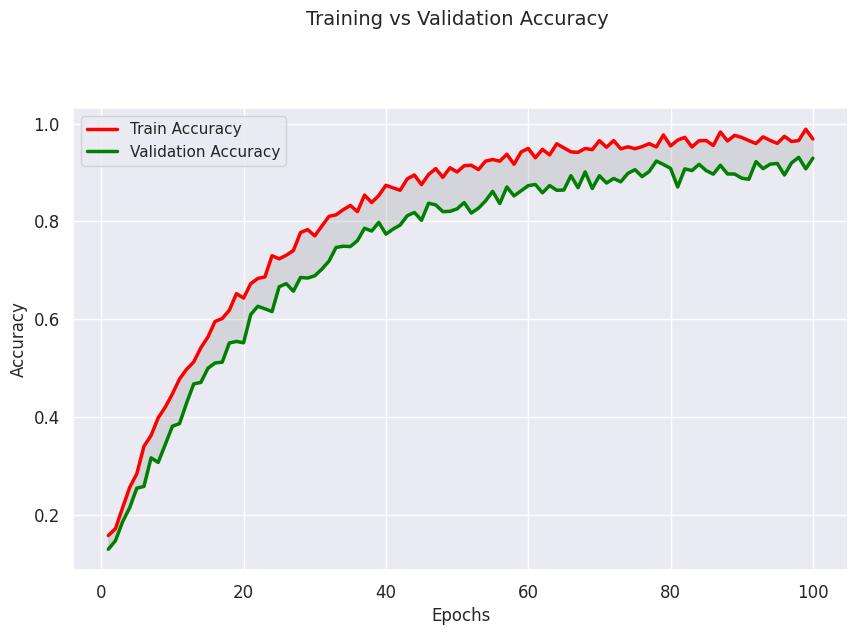

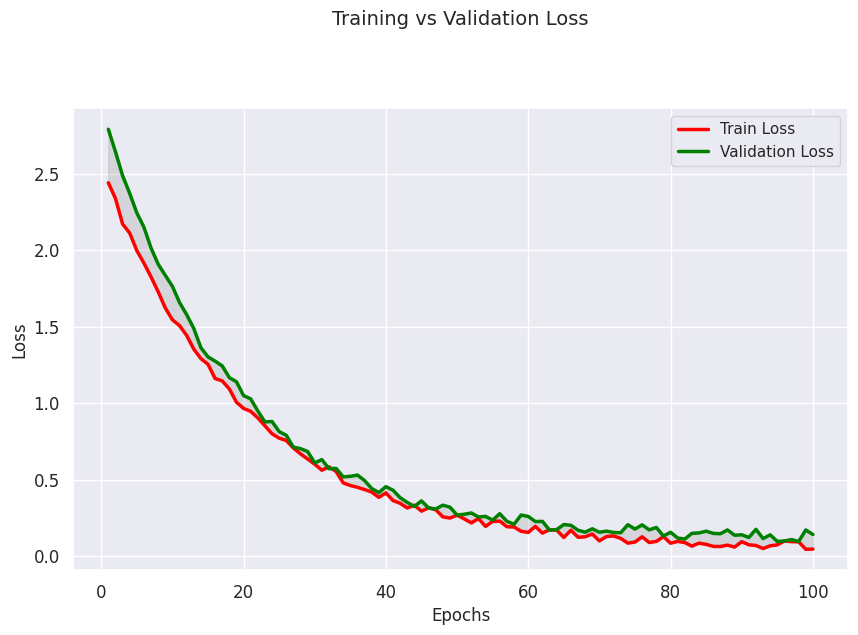

In [170]:
plot_learning(history_model)

In [171]:
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        # Currently, memory growth needs to be the same across GPUs
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        logical_gpus = tf.config.experimental.list_logical_devices('GPU')
        print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
    except RuntimeError as e:
        # Memory growth must be set before GPUs have been initialized
        print(e)


1 Physical GPUs, 1 Logical GPUs


In [ ]:
# Evaluating performance on test set

results = model.evaluate(test_ds)

print("Loss of the model  is - test ", results[0])
print("Accuracy of the model is - test", results[1]*100, "%\n")


results = model.evaluate(val_ds)

print("Loss of the model  is - val ", results[0])
print("Accuracy of the model is - val", results[1]*100, "%\n")

results = model.evaluate(train_ds)

print("Loss of the model  is - train ", results[0])
print("Accuracy of the model is - train", results[1]*100, "%")

In [173]:
from sklearn.metrics import classification_report

predictions = np.array([])
labels =  np.array([])
for x, y in test_ds:
    y_pred = np.argmax(model.predict(x, verbose=0),axis=1)
    predictions = np.concatenate([predictions, y_pred])
    labels = np.concatenate([labels, y.numpy()])

              precision    recall  f1-score   support

      Action       0.93      0.96      0.94       310
   Animation       0.95      0.95      0.95       349
     Romance       0.96      0.95      0.95       348
      Horror       0.95      0.94      0.95       337

    accuracy                           0.95      1344
   macro avg       0.95      0.95      0.95      1344
weighted avg       0.95      0.95      0.95      1344



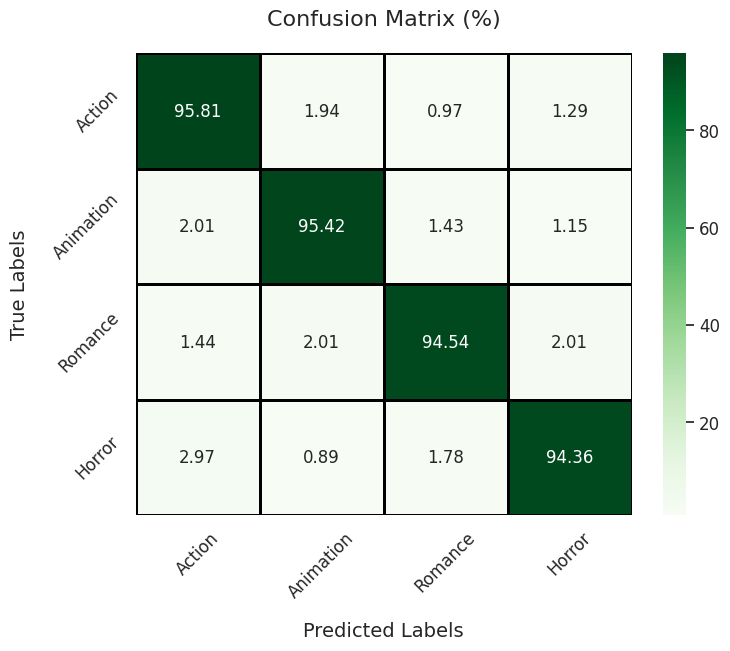

In [174]:
from sklearn.metrics import classification_report

predictions = np.array([])
labels =  np.array([])
for x, y in test_ds:
    y_pred = np.argmax(model.predict(x, verbose=0),axis=1)
    predictions = np.concatenate([predictions, y_pred])
    labels = np.concatenate([labels, y.numpy()])

(32, 120, 120, 3)
(32,)
(32, 120, 120, 3)
(32,)


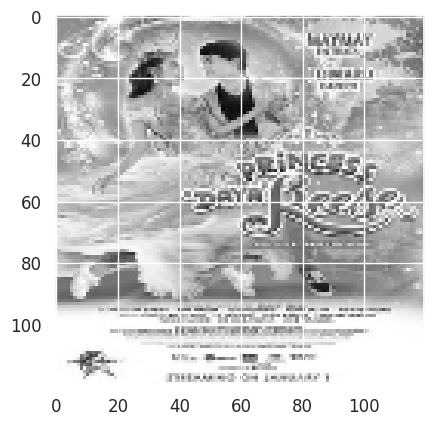

In [175]:
for images, labels in test_ds.take(2):
    plt.imshow(images[0].numpy().astype("uint8"))
    print(images.shape)
    print(labels.shape)

In [ ]:
import numpy as np
from sklearn.metrics import classification_report, confusion_matrix

# Initialize empty lists for true labels and predictions
true_labels = []
predicted_labels = []

# Iterate through the test dataset to obtain predictions
for x, y in test_ds:
    y_pred = np.argmax(model.predict(x), axis=1)
    true_labels.extend(y.numpy())
    predicted_labels.extend(y_pred)

# Convert lists to numpy arrays
true_labels = np.array(true_labels)
predicted_labels = np.array(predicted_labels)

# Print classification report
print(classification_report(true_labels, predicted_labels,
                            target_names=['Action', 'Animation', 'Romance','Horror']))

# Create confusion matrix
cm = confusion_matrix(true_labels, predicted_labels)

# Display confusion matrix
print("\nConfusion Matrix:")
print(cm)


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
Actual: Action, Predicted: Action, Confidence: 99.99%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
Actual: Animation, Predicted: Animation, Confidence: 99.73%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
Actual: Horror, Predicted: Horror, Confidence: 99.08%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
Actual: Action, Predicted: Action, Confidence: 99.86%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
Actual: Romance, Predicted: Animation, Confidence: 94.85%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Actual: Romance, Predicted: Romance, Confidence: 99.99%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
Actual: Romance, Predicted: Romance, Confidence: 99.70%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
Actual: Action, Predicted: Action, Confidence: 99.76%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
Actual: Action, Predicted: Action, Confidence: 99.97%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
Actual: Romance, Predicted: Romance, Confidence: 99.97%
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
Actual: Romance, Predicted: 

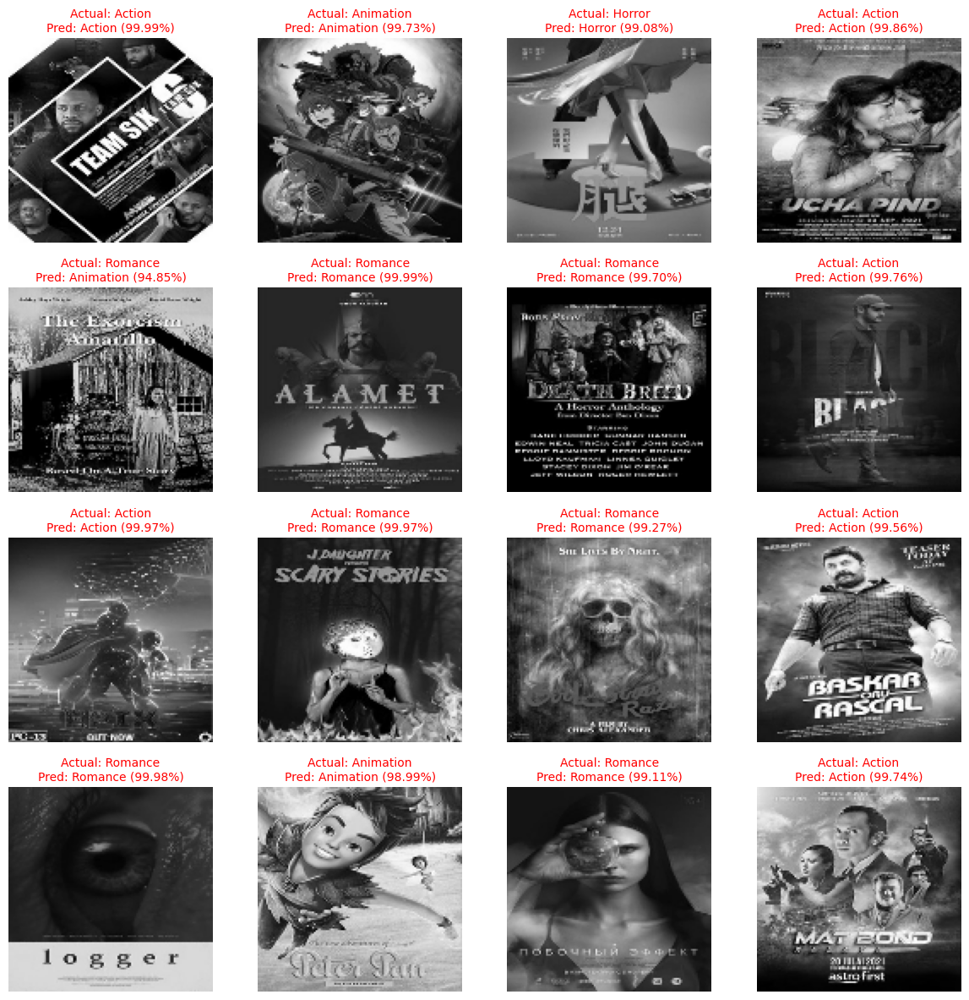

In [177]:
import matplotlib.pyplot as plt
import numpy as np

# Define class names
class_names = ['Action', 'Animation', 'Romance','Horror']  

# Grid size
rows, cols = 4, 4  

# Take a batch of images and labels from test dataset
for images, labels in train_ds.take(1):  
    plt.figure(figsize=(12, 12))  

    for i in range(min(rows * cols, len(images))):  
        plt.subplot(rows, cols, i + 1)  
        plt.imshow(images[i].numpy().astype("uint8"))  
        plt.axis("off")  

        # Ensure input shape is correct
        img = np.expand_dims(images[i].numpy(), axis=0)  

        # Get model predictions
        predictions = model.predict(img)  
        predicted_class = np.argmax(predictions)  
        confidence = np.max(predictions) * 100  

        # Get actual label
        actual_label = class_names[labels[i].numpy()]  
        predicted_label = class_names[predicted_class]  

        # Debugging: Print actual vs predicted
        print(f"Actual: {actual_label}, Predicted: {predicted_label}, Confidence: {confidence:.2f}%")

        # Display predictions
        plt.title(f"Actual: {actual_label}\nPred: {predicted_label} ({confidence:.2f}%)", fontsize=10, color="red")

    plt.tight_layout()  
    plt.show()


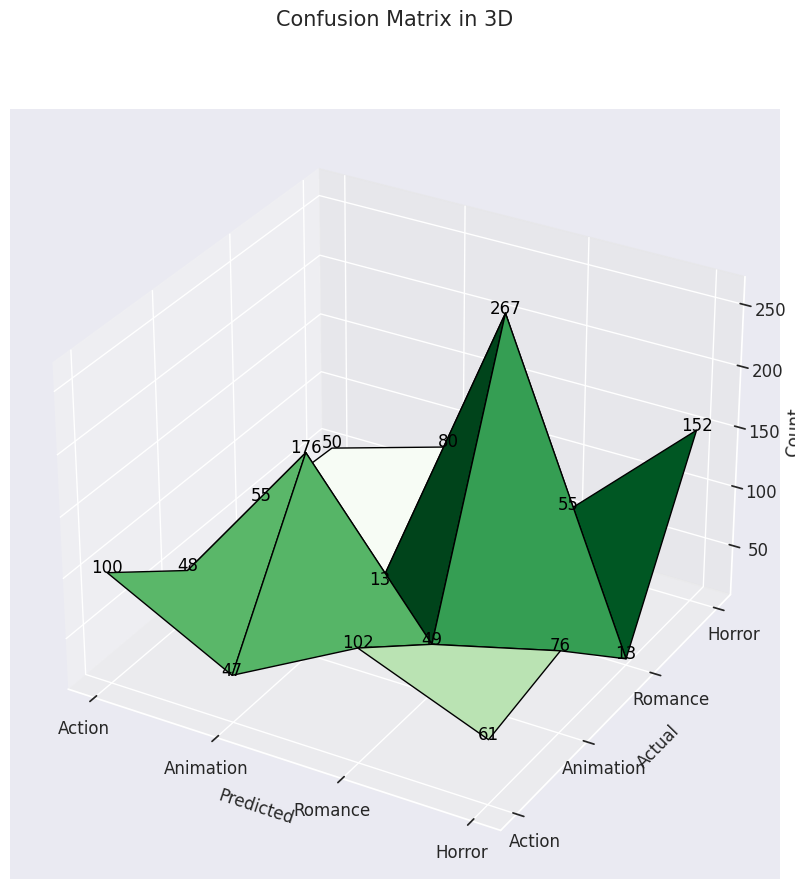

In [178]:
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns

def plot_confusion_matrix_3d(cm, class_names):
    """
    Plots a 3D surface plot for the confusion matrix.
    """
    fig = plt.figure(figsize=(10, 10))
    ax = fig.add_subplot(111, projection='3d')

    # Create the X and Y grid for the confusion matrix
    x, y = np.meshgrid(np.arange(cm.shape[0]), np.arange(cm.shape[1]))

    # Plotting the surface
    ax.plot_surface(x, y, cm, cmap='Greens', edgecolor='black', linewidth=1)

    # Annotate the surface with text (values from the confusion matrix)
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(x[i, j], y[i, j], cm[i, j], str(cm[i, j]), color='black', fontsize=12, ha='center')

    # Set labels for axes
    ax.set_xlabel('Predicted')
    ax.set_ylabel('Actual')
    ax.set_zlabel('Count')

    # Set ticks for X and Y axes based on class names
    ax.set_xticks(np.arange(cm.shape[1]))
    ax.set_yticks(np.arange(cm.shape[0]))
    ax.set_xticklabels(class_names)
    ax.set_yticklabels(class_names)

    # Set title
    ax.set_title('Confusion Matrix in 3D',pad=60)

    # Show the plot
    plt.show()
#["china fan dance", "Sword Dance", "dragon dance images"]
# Example usage:
# Assuming you have a confusion matrix `cm` and class names in `class_names`
class_names = ['Action', 'Animation', 'Romance','Horror']  # Modify with your actual class names
plot_confusion_matrix_3d(cm, class_names)


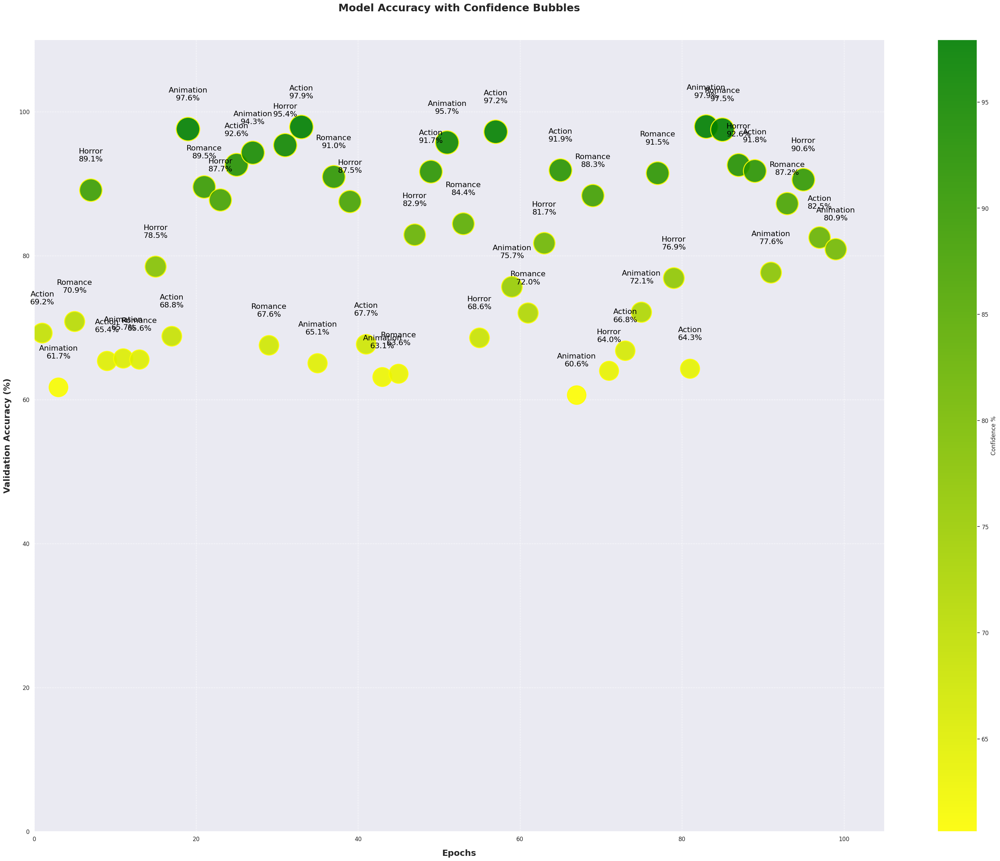

In [179]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import LinearSegmentedColormap

def bubble_accuracy_plot(history, epochs, class_names):
    fig, ax = plt.subplots(figsize=(40, 30))  # Enlarged plot

    total_epochs = len(epochs)
    step = max(1, total_epochs // 40)  # Adjust step for more bubbles
    x_data = np.arange(1, total_epochs + 1, step)
    y_data = np.array(history)[::step]  # Selecting reduced accuracy values
    sizes = y_data * 25  # Increased bubble size
    colors = y_data

    # Custom colormap
    yellow_green_cmap = LinearSegmentedColormap.from_list("yellow_green", ["yellow", "green"])

    scatter = ax.scatter(x_data, y_data, s=sizes, c=colors, cmap=yellow_green_cmap, alpha=0.9, edgecolors='yellow', linewidth=2)

    ax.set_xlabel("Epochs", fontsize=18, weight='bold', labelpad=15)
    ax.set_ylabel("Validation Accuracy (%)", fontsize=18, weight='bold', labelpad=15)
    ax.set_title("Model Accuracy with Confidence Bubbles", fontsize=22, weight='bold', pad=60)

    cbar = plt.colorbar(scatter, ax=ax, label='Confidence %')
    ax.set_ylim(0, 110)
    ax.set_xlim(0, total_epochs + 5)
    plt.grid(True, linestyle='--', alpha=0.8)
    ax.margins(0.15, 0.25)

    for i, txt in enumerate(y_data):
        ax.text(x_data[i], min(y_data[i] + 4, 105),  
                f'{class_names[i % len(class_names)]}\n{txt:.1f}%', 
                ha='center', fontsize=16, color='black')
    
    plt.show()

# Example call
epochs = np.arange(1, 101)  # Increased number of epochs
history = np.random.uniform(60, 100, len(epochs))  # Simulated accuracy values
class_names = ['Action', 'Animation', 'Romance','Horror']
bubble_accuracy_plot(history, epochs, class_names)


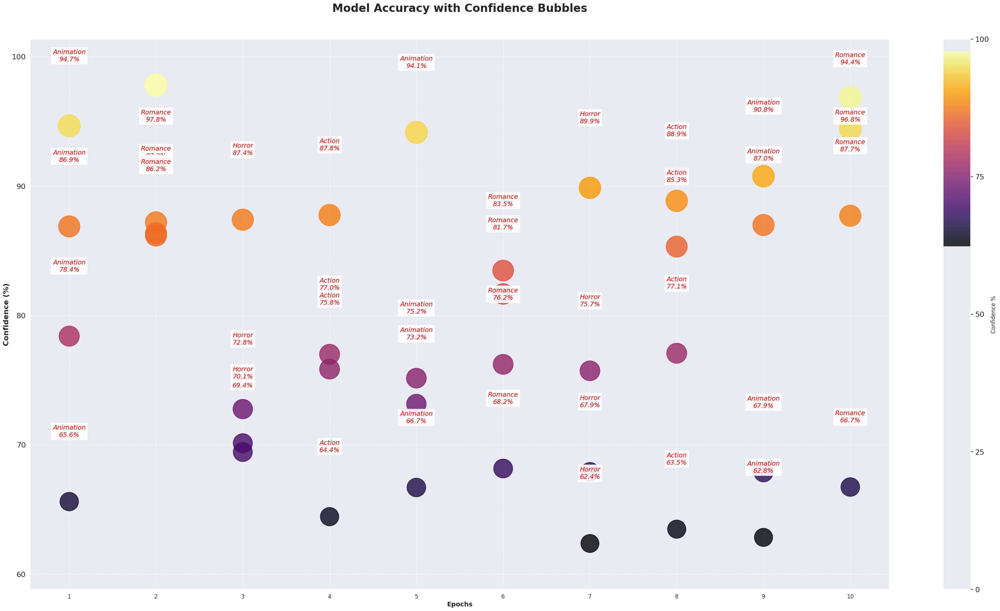

In [180]:
import matplotlib.pyplot as plt
import numpy as np

# Define class names (Modify based on your dataset)
class_names = ['Action', 'Animation', 'Romance', 'Horror']

# Number of epochs for plotting
epochs = np.arange(1, 11)

# Create a larger plot
fig, ax = plt.subplots(figsize=(35, 20))

# Set labels for axes and title
ax.set_xlabel('Epochs', fontsize=14, weight='bold')
ax.set_ylabel('Confidence (%)', fontsize=16, weight='bold')
ax.set_title('Model Accuracy with Confidence Bubbles', fontsize=24, weight='bold', pad=60)

# Variables to store bubble data
x_data = []
y_data = []
sizes = []
colors = []

# Generate random data for demonstration
for epoch in epochs:
    for class_idx in range(len(class_names)):
        confidence = np.random.uniform(0.60, 1.00) * 100
        
        x_data.append(epoch)
        y_data.append(confidence)
        sizes.append(confidence * 25)
        colors.append(confidence)

# Scatter plot with deep colors
scatter = ax.scatter(x_data, y_data, s=sizes, c=colors, cmap='inferno', alpha=0.8, linewidth=1.5)

# Add color bar
cbar = plt.colorbar(scatter, ax=ax, label='Confidence %')
cbar.set_ticks([0, 25, 50, 75, 100])
cbar.ax.tick_params(labelsize=16)

# Adjust spacing for labels to avoid overlap
for i in range(len(x_data)):
    label_x = x_data[i]
    label_y = y_data[i] + 5

    if label_y > 100:
        label_y = 95
    elif label_y < 10:
        label_y = 15

    ax.text(label_x, label_y, f'{class_names[x_data[i] % len(class_names)]}\n{y_data[i]:.1f}%', 
            ha='center', fontsize=14, color='Red', fontstyle='italic',
            bbox=dict(facecolor='White', edgecolor='None', alpha=0.9))

# Keep grid as is
ax.set_xticks(epochs)
ax.set_yticks(np.arange(0, 110, 10))
ax.set_yticklabels(np.arange(0, 110, 10), fontsize=16)
ax.grid(True, linestyle='--', alpha=0.9)

# Layout adjustments
ax.margins(x=0.05, y=0.1)
plt.tight_layout(pad=5.0)

# Show plot
plt.show()


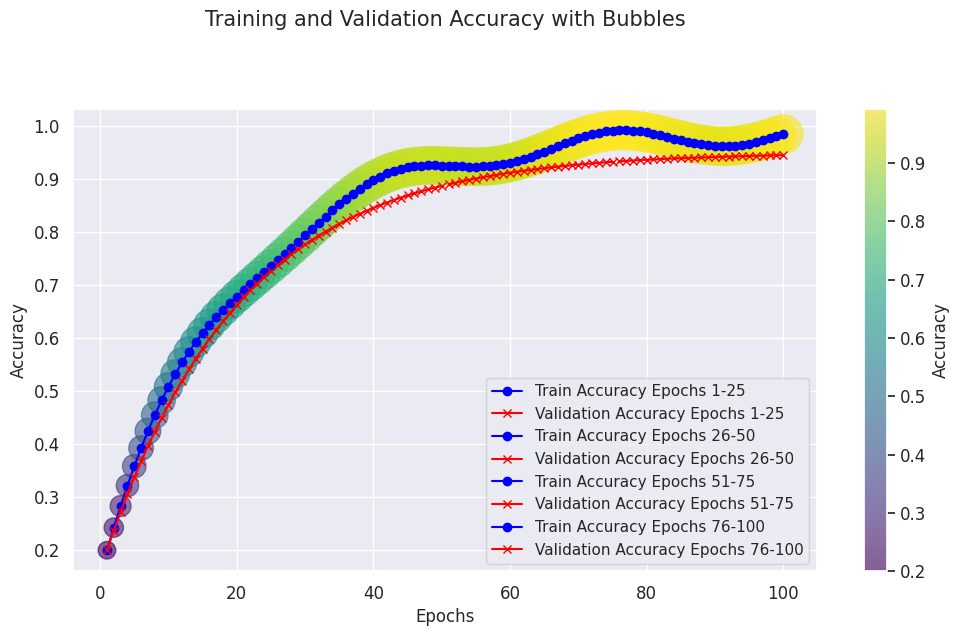

In [181]:
import matplotlib.pyplot as plt
import numpy as np

def plot_accuracy_with_bubbles(history_model_net):
    """
    Plots training and validation accuracy with bubbles for different epoch ranges.
    """
    epochs = np.arange(1, len(history_model_net.history['accuracy']) + 1)
    
    # Split the epochs and accuracy into different ranges (1-25, 26-50, 51-75, 76-100)
    epoch_ranges = [(1, 25), (26, 50), (51, 75), (76, 100)]
    accuracies = {
        'train': history_model_net.history['accuracy'],
        'val': history_model_net.history['val_accuracy']
    }
    
    # Create a 2D plot
    fig, ax = plt.subplots(figsize=(12, 6))
    
    # Set labels for axes
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Accuracy')
    
    # Variables to store bubble data
    x_data = []
    y_data = []
    sizes = []  # Bubble sizes (based on accuracy)
    colors = []  # Bubble colors (for visualization)
    
    # Plot training accuracy with bubbles and lines for each epoch range
    for start, end in epoch_ranges:
        # Get the relevant epoch range
        train_accuracy_range = accuracies['train'][start-1:end]
        val_accuracy_range = accuracies['val'][start-1:end]
        epoch_range = epochs[start-1:end]
        
        # Add bubbles for train accuracy
        for i, acc in enumerate(train_accuracy_range):
            x_data.append(epoch_range[i])
            y_data.append(acc)
            sizes.append(acc * 800)  # Bubble size based on accuracy
            colors.append(acc)  # Color based on accuracy
        
        # Add lines between bubbles
        ax.plot(epoch_range, train_accuracy_range, label=f'Train Accuracy Epochs {start}-{end}', marker='o', linestyle='-', color='blue')
        ax.plot(epoch_range, val_accuracy_range, label=f'Validation Accuracy Epochs {start}-{end}', marker='x', linestyle='-', color='green')

    # Scatter plot with bubbles
    scatter = ax.scatter(x_data, y_data, s=sizes, c=colors, cmap='viridis', alpha=0.6)

    # Add color bar for accuracy
    plt.colorbar(scatter, ax=ax, label='Accuracy')

    # Add title and legend
    ax.set_title('Training and Validation Accuracy with Bubbles',pad=60)
    ax.legend()
    
    # Show the plot
    plt.show()

# Call the function with your model history
plot_accuracy_with_bubbles(history_model_net)


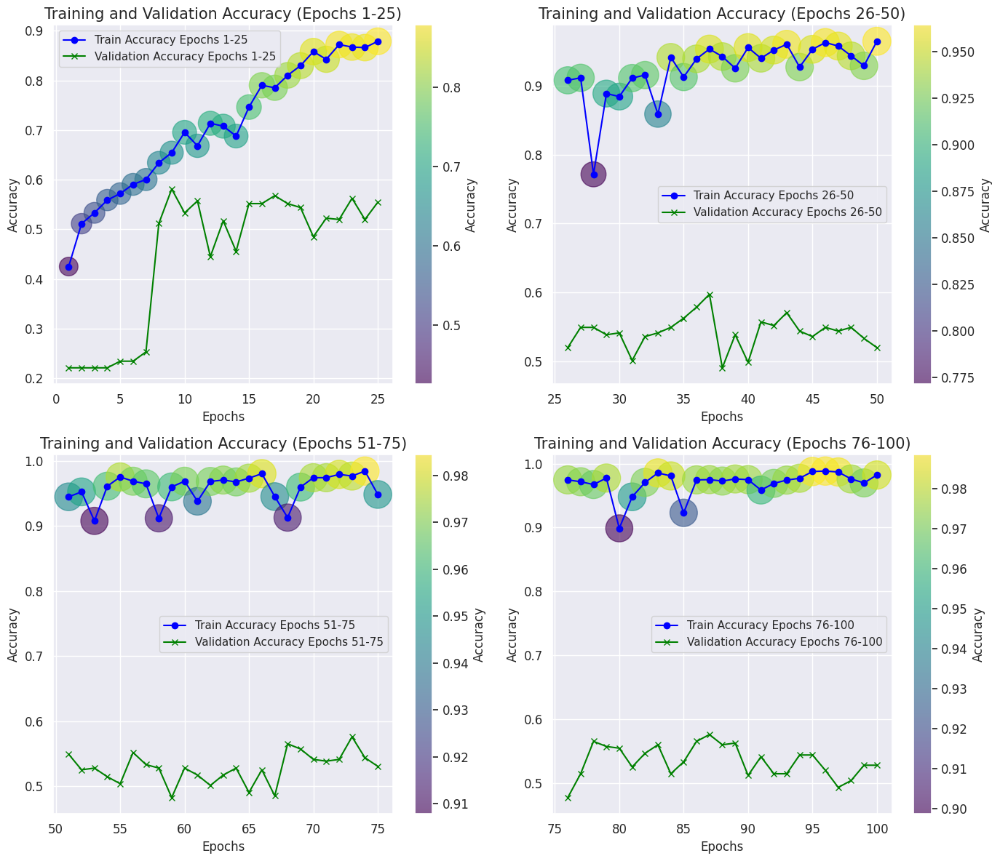

In [182]:
import matplotlib.pyplot as plt
import numpy as np

def plot_accuracy_with_bubbles_separated(history_model_net):
    """
    Plots training and validation accuracy in separate subplots for each epoch range (1-25, 26-50, 51-75, 76-100).
    """
    epochs = np.arange(1, len(history_model_net.history['accuracy']) + 1)
    
    # Split the epochs and accuracy into different ranges (1-25, 26-50, 51-75, 76-100)
    epoch_ranges = [(1, 25), (26, 50), (51, 75), (76, 100)]
    accuracies = {
        'train': history_model_net.history['accuracy'],
        'val': history_model_net.history['val_accuracy']
    }
    
    # Create subplots for each epoch range
    fig, axes = plt.subplots(2, 2, figsize=(14, 12))  # 2x2 grid for 4 subplots
    axes = axes.flatten()  # Flatten to easily iterate over

    # Iterate through each epoch range and plot on corresponding subplot
    for idx, (start, end) in enumerate(epoch_ranges):
        ax = axes[idx]
        
        # Get the relevant epoch range
        train_accuracy_range = accuracies['train'][start-1:end]
        val_accuracy_range = accuracies['val'][start-1:end]
        epoch_range = epochs[start-1:end]
        
        # Variables to store bubble data
        x_data = []
        y_data = []
        sizes = []  # Bubble sizes (based on accuracy)
        colors = []  # Bubble colors (for visualization)
        
        # Add bubbles for train accuracy
        for i, acc in enumerate(train_accuracy_range):
            x_data.append(epoch_range[i])
            y_data.append(acc)
            sizes.append(acc * 800)  # Bubble size based on accuracy
            colors.append(acc)  # Color based on accuracy
        
        # Add lines between bubbles
        ax.plot(epoch_range, train_accuracy_range, label=f'Train Accuracy Epochs {start}-{end}', marker='o', linestyle='-', color='blue')
        ax.plot(epoch_range, val_accuracy_range, label=f'Validation Accuracy Epochs {start}-{end}', marker='x', linestyle='-', color='green')

        # Scatter plot with bubbles
        scatter = ax.scatter(x_data, y_data, s=sizes, c=colors, cmap='viridis', alpha=0.6)

        # Set labels for axes
        ax.set_xlabel('Epochs')
        ax.set_ylabel('Accuracy')
        
        # Add color bar for accuracy
        plt.colorbar(scatter, ax=ax, label='Accuracy')
        
        # Add title and legend
        ax.set_title(f'Training and Validation Accuracy (Epochs {start}-{end})')
        ax.legend()

    # Adjust layout to prevent overlap
    plt.tight_layout()

    # Show the plot
    plt.show()

# Call the function with your model history
plot_accuracy_with_bubbles_separated(history_model_net)


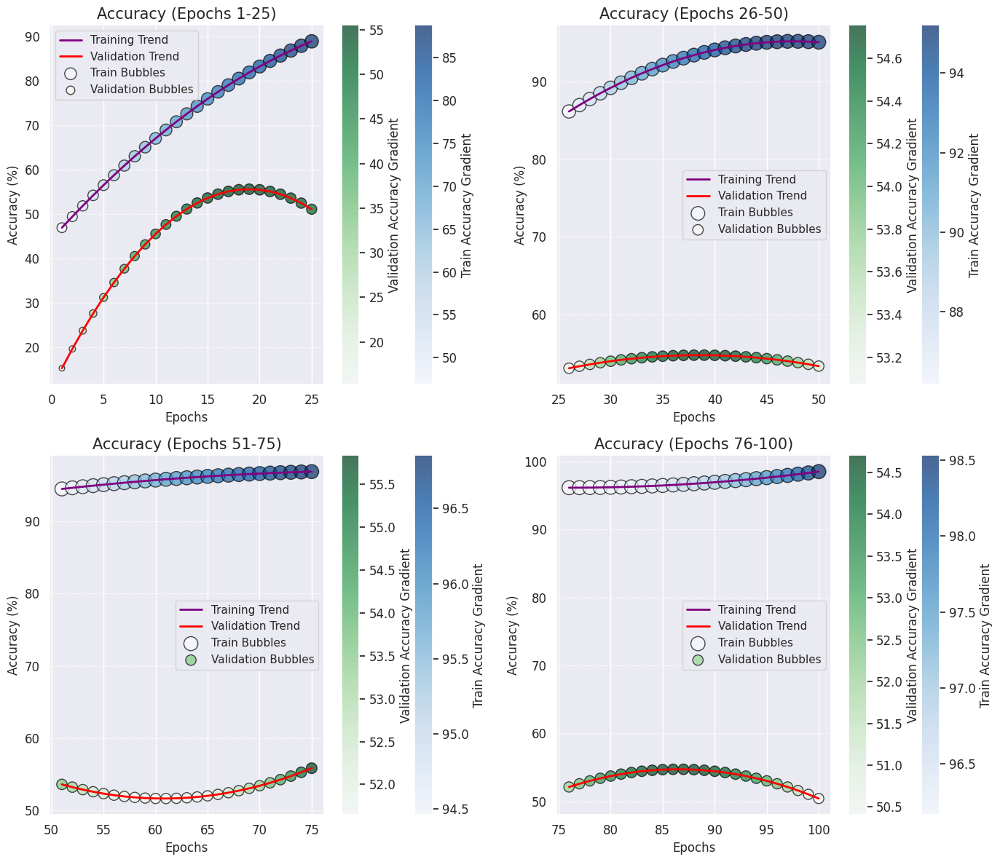

In [183]:
import matplotlib.pyplot as plt
import numpy as np

def plot_accuracy_with_bubbles_combined(history_model_net):
    """
    Plots training and validation accuracy with bubble trend visualization in separate subplots for epoch ranges.
    """
    epochs = np.arange(1, len(history_model_net.history['accuracy']) + 1)
    
    # Split the epochs and accuracy into different ranges (1-25, 26-50, 51-75, 76-100)
    epoch_ranges = [(1, 25), (26, 50), (51, 75), (76, 100)]
    accuracies = {
        'train': np.array(history_model_net.history['accuracy']) * 100,  # Convert to percentage
        'val': np.array(history_model_net.history['val_accuracy']) * 100
    }
    
    # Create subplots for each epoch range
    fig, axes = plt.subplots(2, 2, figsize=(14, 12))  # 2x2 grid for 4 subplots
    axes = axes.flatten()  # Flatten to easily iterate over

    for idx, (start, end) in enumerate(epoch_ranges):
        ax = axes[idx]
        
        # Get the relevant epoch range
        epoch_range = epochs[start-1:end]
        train_accuracy_range = accuracies['train'][start-1:end]
        val_accuracy_range = accuracies['val'][start-1:end]
        
        # Fit polynomial trend lines
        z_train = np.polyfit(epoch_range, train_accuracy_range, deg=2)
        p_train = np.poly1d(z_train)
        y_train_trend = p_train(epoch_range)

        z_val = np.polyfit(epoch_range, val_accuracy_range, deg=2)
        p_val = np.poly1d(z_val)
        y_val_trend = p_val(epoch_range)

        # Plot trend lines
        ax.plot(epoch_range, y_train_trend, color='purple', linewidth=2, linestyle='-', label='Training Trend')
        ax.plot(epoch_range, y_val_trend, color='red', linewidth=2, linestyle='-', label='Validation Trend')

        # Bubble sizes & colors
        sizes_train = y_train_trend * 2  
        sizes_val = y_val_trend * 2  

        scatter_train = ax.scatter(epoch_range, y_train_trend, s=sizes_train, c=y_train_trend, cmap='Blues', alpha=0.7, edgecolors='black', label='Train Bubbles')
        scatter_val = ax.scatter(epoch_range, y_val_trend, s=sizes_val, c=y_val_trend, cmap='Greens', alpha=0.7, edgecolors='black', label='Validation Bubbles')

        # Formatting
        ax.set_xlabel("Epochs")
        ax.set_ylabel("Accuracy (%)")
        ax.set_title(f'Accuracy (Epochs {start}-{end})')
        ax.grid(axis='y', linestyle='--', alpha=0.7)
        ax.legend()

        # Colorbars
        plt.colorbar(scatter_train, ax=ax, label="Train Accuracy Gradient")
        plt.colorbar(scatter_val, ax=ax, label="Validation Accuracy Gradient")

    # Adjust layout
    plt.tight_layout()
    plt.show()

# Call the function with your model history
plot_accuracy_with_bubbles_combined(history_model_net)


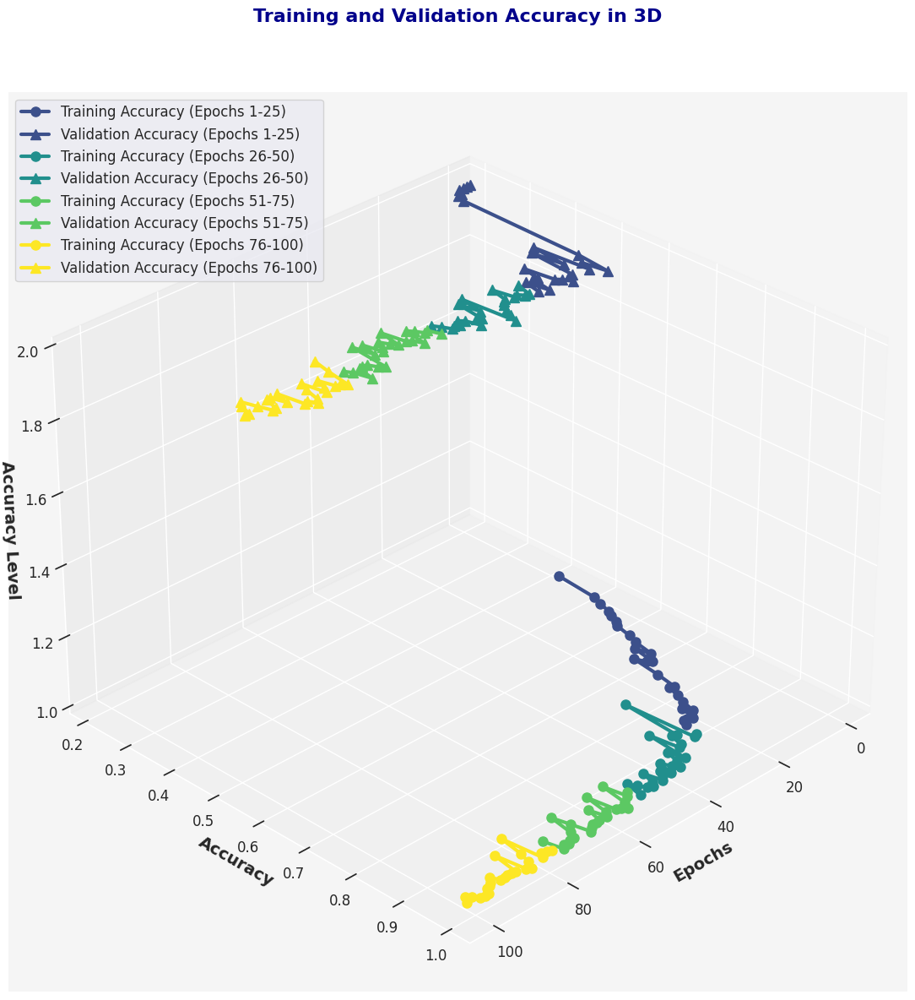

In [184]:
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D  # Importing 3D plotting module
from matplotlib import cm
from matplotlib.colors import Normalize

def plot_accuracy_with_3d_lines(history_model_net):
    """
    Plots training and validation accuracy in separate 3D subplots for each epoch range (1-25, 26-50, 51-75, 76-100).
    Adds enhancements such as color gradients for a stunning 3D effect.
    """
    epochs = np.arange(1, len(history_model_net.history['accuracy']) + 1)
    
    # Split the epochs and accuracy into different ranges (1-25, 26-50, 51-75, 76-100)
    epoch_ranges = [(1, 25), (26, 50), (51, 75), (76, 100)]
    accuracies = {
        'train': history_model_net.history['accuracy'],
        'val': history_model_net.history['val_accuracy']
    }
    
    # Create a figure for the 3D plot
    fig = plt.figure(figsize=(14, 12))
    ax = fig.add_subplot(111, projection='3d')  # 3D subplot
    
    # Set the colormap and normalize the values for color gradients
    cmap = cm.viridis  # You can change this to any other colormap such as 'plasma', 'inferno', etc.
    norm = Normalize(vmin=1, vmax=100)

    # Loop through each epoch range and plot on corresponding subplot
    for idx, (start, end) in enumerate(epoch_ranges):
        # Get the relevant epoch range
        train_accuracy_range = accuracies['train'][start-1:end]
        val_accuracy_range = accuracies['val'][start-1:end]
        epoch_range = epochs[start-1:end]
        
        # Color gradient based on epoch number
        train_colors = cmap(norm(epoch_range))  # Apply colormap to training accuracy
        val_colors = cmap(norm(epoch_range))    # Apply colormap to validation accuracy

        # 3D plot for training accuracy
        ax.plot(epoch_range, train_accuracy_range, zs=1, label=f'Training Accuracy (Epochs {start}-{end})', marker='o', color=train_colors[-1], linewidth=3, markersize=8)
        
        # 3D plot for validation accuracy
        ax.plot(epoch_range, val_accuracy_range, zs=2, label=f'Validation Accuracy (Epochs {start}-{end})', marker='^', color=val_colors[-1], linewidth=3, markersize=8)

    # Set labels with improved styling
    ax.set_xlabel('Epochs', fontsize=14, fontweight='bold')
    ax.set_ylabel('Accuracy', fontsize=14, fontweight='bold')
    ax.set_zlabel('Accuracy Level', fontsize=14, fontweight='bold')

    # Set title with improved styling
    ax.set_title('Training and Validation Accuracy in 3D', fontsize=16,pad=60, fontweight='bold', color='darkblue')

    # Customize the grid and background for better aesthetics
    ax.grid(True, color='gray', linestyle='--', linewidth=0.5)
    ax.set_facecolor('whitesmoke')
    
    # Adjust the view angle for better clarity
    ax.view_init(30, 45)

    # Add a legend with better positioning
    ax.legend(loc='upper left', fontsize=12)

    # Show the plot
    plt.tight_layout()
    plt.show()

# Call the function with your model history
plot_accuracy_with_3d_lines(history_model_net)


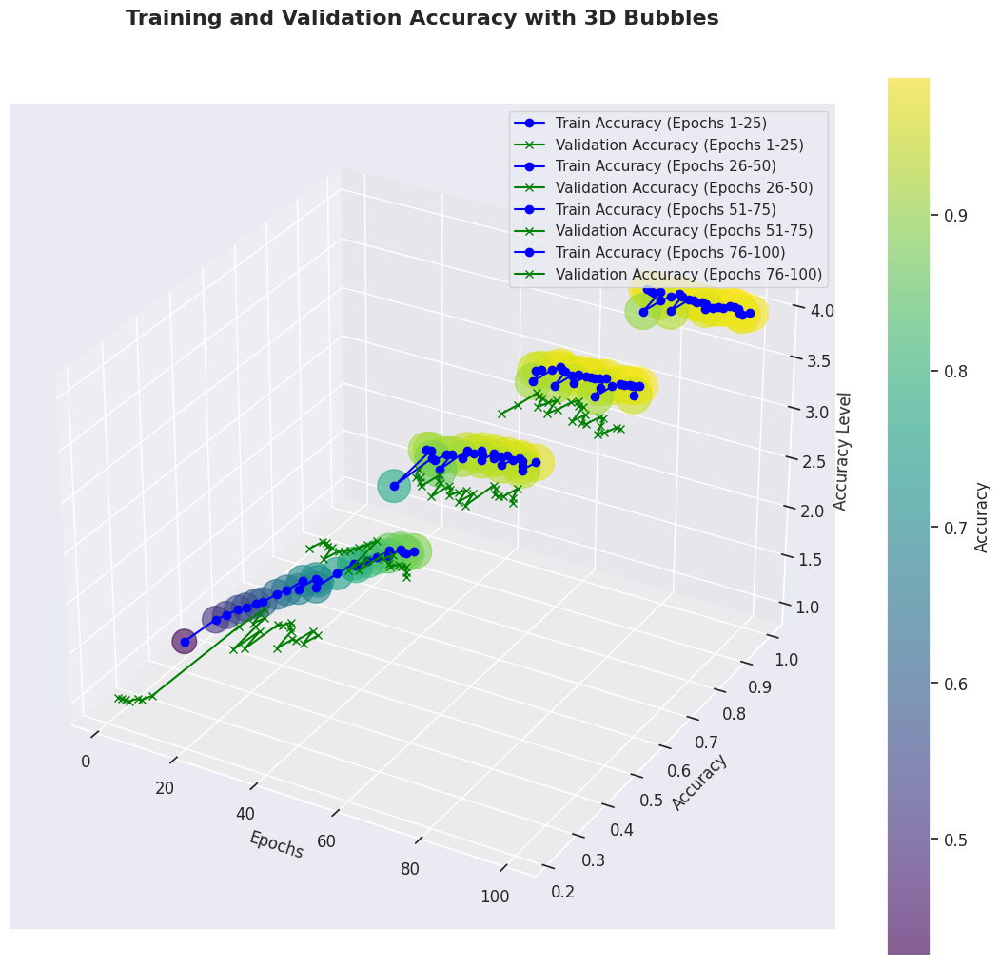

In [185]:
import matplotlib.pyplot as plt
import numpy as np
from mpl_toolkits.mplot3d import Axes3D  # Importing 3D plotting module

def plot_accuracy_with_3d_bubbles(history_model_net):
    """
    Plots training and validation accuracy with 3D bubbles for different epoch ranges.
    """
    epochs = np.arange(1, len(history_model_net.history['accuracy']) + 1)
    
    # Split the epochs and accuracy into different ranges (1-25, 26-50, 51-75, 76-100)
    epoch_ranges = [(1, 25), (26, 50), (51, 75), (76, 100)]
    accuracies = {
        'train': history_model_net.history['accuracy'],
        'val': history_model_net.history['val_accuracy']
    }
    
    # Create a 3D plot
    fig = plt.figure(figsize=(14, 12))
    ax = fig.add_subplot(111, projection='3d')
    
    # Set labels for axes
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Accuracy')
    ax.set_zlabel('Accuracy Level')
    
    # Variables to store bubble data
    x_data = []
    y_data = []
    z_data = []  # Z-axis for different epoch ranges
    sizes = []  # Bubble sizes (based on accuracy)
    colors = []  # Bubble colors (for visualization)
    
    # Plot training accuracy with bubbles and lines for each epoch range
    for idx, (start, end) in enumerate(epoch_ranges):
        # Get the relevant epoch range
        train_accuracy_range = accuracies['train'][start-1:end]
        val_accuracy_range = accuracies['val'][start-1:end]
        epoch_range = epochs[start-1:end]
        
        # Add bubbles for train accuracy
        for i, acc in enumerate(train_accuracy_range):
            x_data.append(epoch_range[i])
            y_data.append(acc)
            z_data.append(idx + 1)  # Different z values based on epoch range (1, 2, 3, 4)
            sizes.append(acc * 800)  # Bubble size based on accuracy
            colors.append(acc)  # Color based on accuracy
        
        # Add lines between bubbles (for train and validation accuracy)
        ax.plot(epoch_range, train_accuracy_range, zs=idx + 1, label=f'Train Accuracy (Epochs {start}-{end})', marker='o', linestyle='-', color='blue')
        ax.plot(epoch_range, val_accuracy_range, zs=idx + 1, label=f'Validation Accuracy (Epochs {start}-{end})', marker='x', linestyle='-', color='green')

    # Scatter plot with bubbles
    scatter = ax.scatter(x_data, y_data, z_data, s=sizes, c=colors, cmap='viridis', alpha=0.6)

    # Add color bar for accuracy
    plt.colorbar(scatter, ax=ax, label='Accuracy')

    # Add title and legend
    ax.set_title('Training and Validation Accuracy with 3D Bubbles',pad=60, fontsize=16, fontweight='bold')
    ax.legend()

    # Show the plot
    plt.show()

# Call the function with your model history
plot_accuracy_with_3d_bubbles(history_model_net)


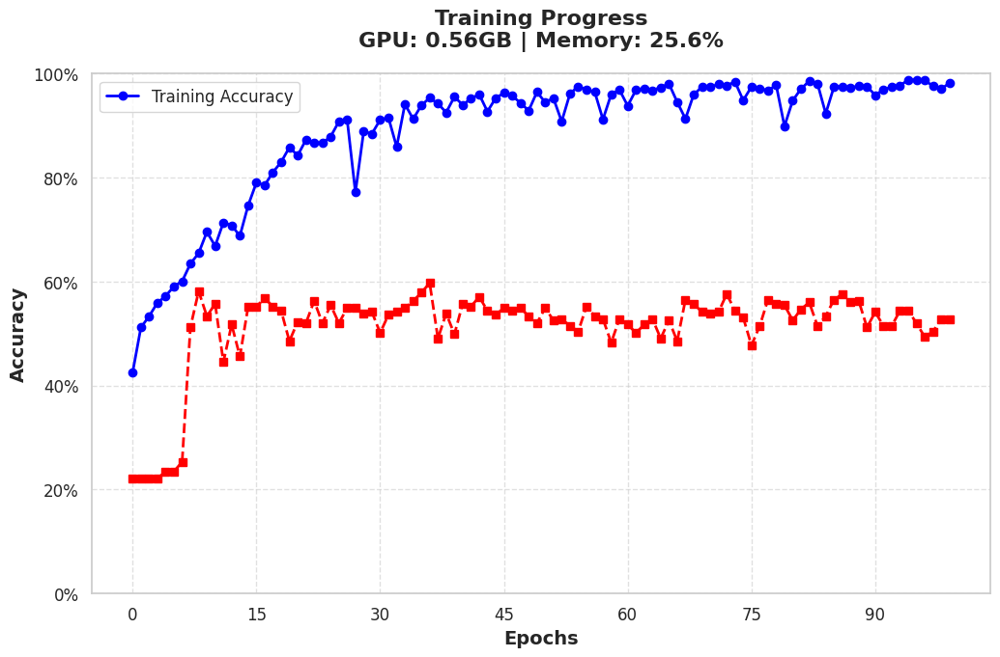

In [186]:
import matplotlib.pyplot as plt
import seaborn as sns
import psutil
import tensorflow as tf

# Get memory usage
memory_usage = psutil.virtual_memory().percent
gpu_info = tf.config.experimental.get_memory_info('GPU:0')
gpu_usage = gpu_info['current'] / 1e9  # Convert bytes to GB

# Set Seaborn style
sns.set_style("whitegrid")

# Create figure
fig, ax = plt.subplots(figsize=(12, 7))

# Plot training and validation accuracy
ax.plot(history_model_net.history['accuracy'], marker='o', linestyle='-', linewidth=2, markersize=6, label='Training Accuracy', color='blue')
ax.plot(history_model_net.history['val_accuracy'], marker='s', linestyle='--', linewidth=2, markersize=6,  color='red')

# Highlight max validation accuracy
max_val_acc = max(history_model_net.history['val_accuracy'])
max_epoch = history_model_net.history['val_accuracy'].index(max_val_acc)
#ax.scatter(max_epoch, max_val_acc, color='green', s=200, edgecolor='black', label=f'Max Val Acc: {max_val_acc:.2f}')

# Labels and title
ax.set_xlabel('Epochs', fontsize=14, weight='bold')
ax.set_ylabel('Accuracy', fontsize=14, weight='bold')
ax.set_title(f"Training Progress\nGPU: {gpu_usage:.2f}GB | Memory: {memory_usage}%", fontsize=16, weight='bold', pad=20)
ax.legend(fontsize=12)
ax.set_ylim(0, 1)

# Customizing grid and ticks
ax.xaxis.set_major_locator(plt.MaxNLocator(integer=True))
ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.0%}'))
ax.grid(True, linestyle='--', alpha=0.6)

# Show plot
plt.show()


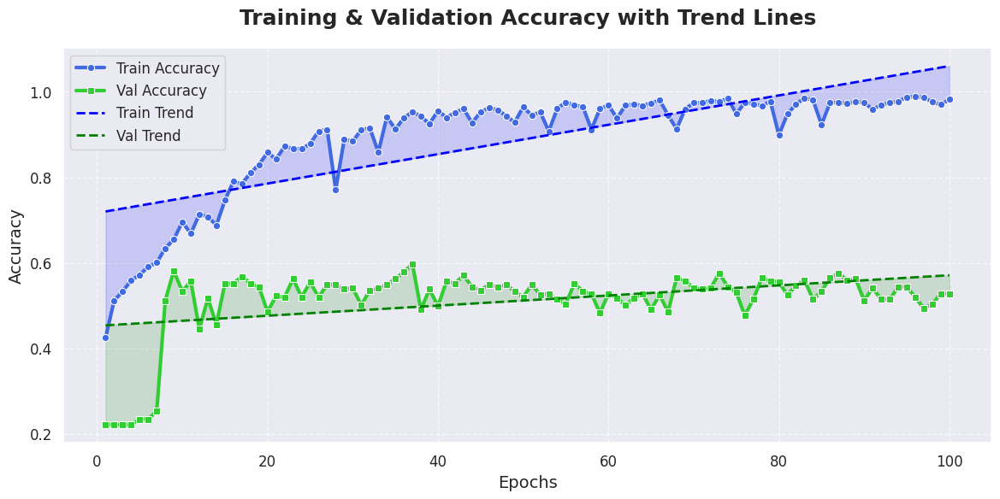

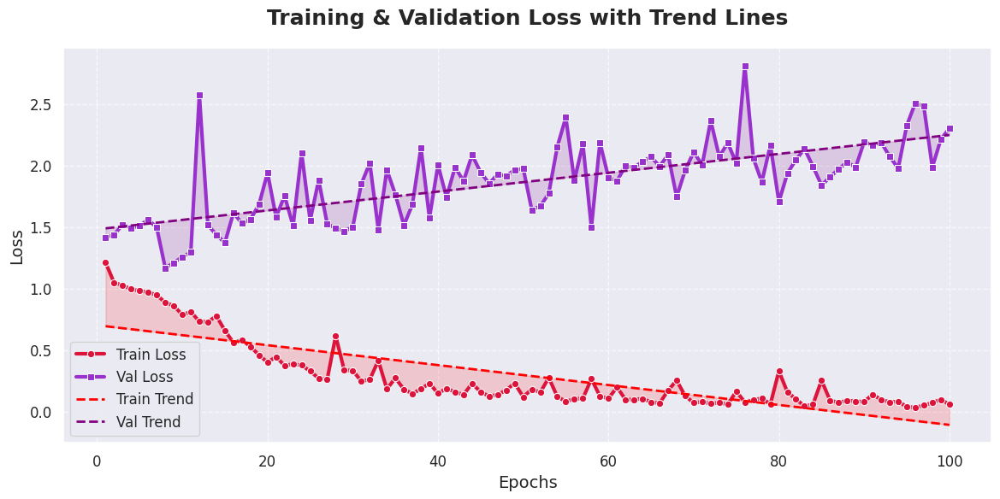

In [187]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)  # Suppress FutureWarnings

import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from scipy.stats import linregress

# Extract training history
epochs = np.arange(1, len(history_model_net.history['loss']) + 1)

# Create DataFrame for accuracy
df_accuracy = pd.DataFrame({
    'Epochs': epochs,
    'Train Accuracy': history_model_net.history['accuracy'],
    'Val Accuracy': history_model_net.history['val_accuracy']
})

# Create DataFrame for loss
df_loss = pd.DataFrame({
    'Epochs': epochs,
    'Train Loss': history_model_net.history['loss'],
    'Val Loss': history_model_net.history['val_loss']
})

# Handle any infinite or NaN values to prevent warnings
df_accuracy.replace([np.inf, -np.inf], np.nan, inplace=True)
df_loss.replace([np.inf, -np.inf], np.nan, inplace=True)

df_accuracy.dropna(inplace=True)
df_loss.dropna(inplace=True)

# Compute trend lines using linear regression
def compute_trend(y_values):
    slope, intercept, _, _, _ = linregress(df_accuracy['Epochs'], y_values)
    return slope * df_accuracy['Epochs'] + intercept

# Trend lines for accuracy
train_acc_trend = compute_trend(df_accuracy['Train Accuracy'])
val_acc_trend = compute_trend(df_accuracy['Val Accuracy'])

# Trend lines for loss
train_loss_trend = compute_trend(df_loss['Train Loss'])
val_loss_trend = compute_trend(df_loss['Val Loss'])

# Set Seaborn style
sns.set_style("darkgrid")
sns.set_palette("husl")

## Accuracy Plot ##
plt.figure(figsize=(14, 6))
sns.lineplot(x='Epochs', y='Train Accuracy', data=df_accuracy, label='Train Accuracy', color='royalblue', linewidth=3, marker='o')
sns.lineplot(x='Epochs', y='Val Accuracy', data=df_accuracy, label='Val Accuracy', color='limegreen', linewidth=3, marker='s')

plt.plot(df_accuracy['Epochs'], train_acc_trend, color='blue', linestyle='--', linewidth=2, label='Train Trend')
plt.plot(df_accuracy['Epochs'], val_acc_trend, color='green', linestyle='--', linewidth=2, label='Val Trend')

plt.fill_between(df_accuracy['Epochs'], df_accuracy['Train Accuracy'], train_acc_trend, color='blue', alpha=0.15)
plt.fill_between(df_accuracy['Epochs'], df_accuracy['Val Accuracy'], val_acc_trend, color='green', alpha=0.15)

plt.xlabel('Epochs', fontsize=14)
plt.ylabel('Accuracy', fontsize=14)
plt.title('Training & Validation Accuracy with Trend Lines', fontsize=18, pad=20, fontweight='bold')
plt.legend(fontsize=12, loc='best')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()

## Loss Plot ##
plt.figure(figsize=(14, 6))
sns.lineplot(x='Epochs', y='Train Loss', data=df_loss, label='Train Loss', color='crimson', linewidth=3, marker='o')
sns.lineplot(x='Epochs', y='Val Loss', data=df_loss, label='Val Loss', color='darkorchid', linewidth=3, marker='s')

plt.plot(df_loss['Epochs'], train_loss_trend, color='red', linestyle='--', linewidth=2, label='Train Trend')
plt.plot(df_loss['Epochs'], val_loss_trend, color='purple', linestyle='--', linewidth=2, label='Val Trend')

plt.fill_between(df_loss['Epochs'], df_loss['Train Loss'], train_loss_trend, color='red', alpha=0.15)
plt.fill_between(df_loss['Epochs'], df_loss['Val Loss'], val_loss_trend, color='purple', alpha=0.15)

plt.xlabel('Epochs', fontsize=14)
plt.ylabel('Loss', fontsize=14)
plt.title('Training & Validation Loss with Trend Lines', fontsize=18, pad=20, fontweight='bold')
plt.legend(fontsize=12, loc='best')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()


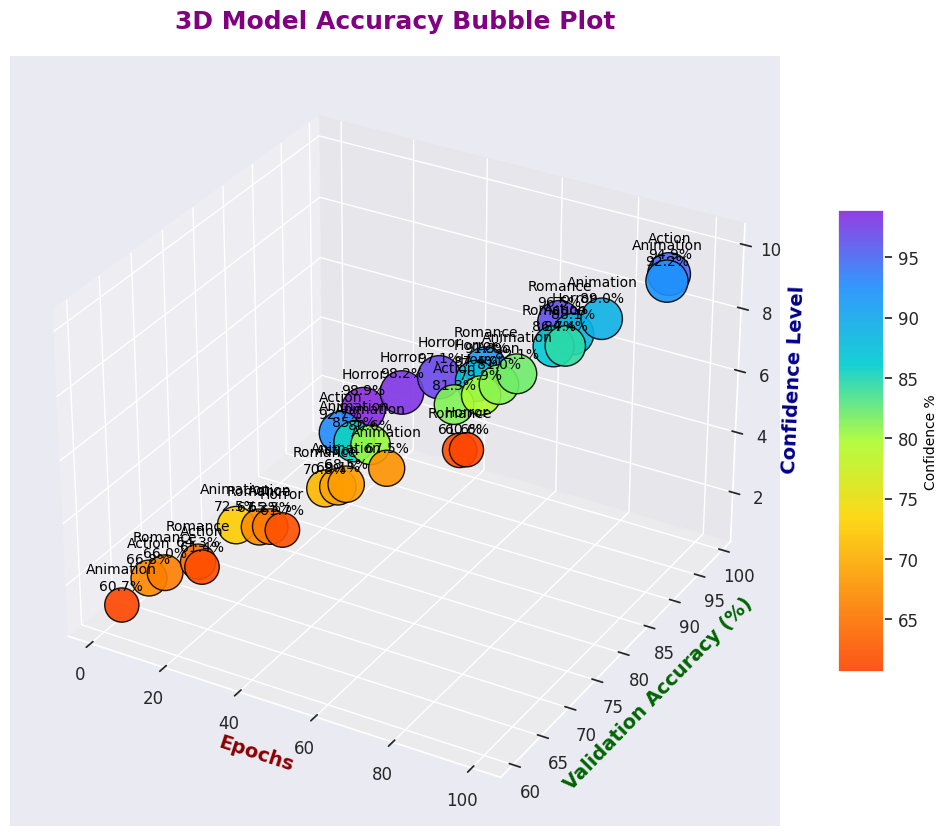

In [188]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import LinearSegmentedColormap
from mpl_toolkits.mplot3d import Axes3D

def bubble_accuracy_plot_3d(history, epochs, class_names):
    fig = plt.figure(figsize=(15, 10))  # Adjusted size
    ax = fig.add_subplot(111, projection='3d')
    
    total_epochs = len(epochs)
    step = max(1, total_epochs // 30)  # Reduce the number of bubbles
    x_data = np.arange(1, total_epochs + 1, step)
    y_data = np.array(history)[::step]  # Selecting reduced accuracy values
    z_data = np.linspace(1, 10, len(y_data))  # Adding a third dimension
    sizes = y_data * 10  # Adjusted bubble size
    colors = y_data

    # Custom colormap with more attractive colors
    vibrant_cmap = LinearSegmentedColormap.from_list("vibrant", ["#FF4500", "#FF8C00", "#FFD700", "#ADFF2F", "#00CED1", "#1E90FF", "#8A2BE2"])
    
    scatter = ax.scatter(x_data, y_data, z_data, s=sizes, c=colors, cmap=vibrant_cmap, alpha=0.9, edgecolors='black', linewidth=1)
    
    ax.set_xlabel("Epochs", fontsize=14, weight='bold', color='darkred')
    ax.set_ylabel("Validation Accuracy (%)", fontsize=14, weight='bold', color='darkgreen')
    ax.set_zlabel("Confidence Level", fontsize=14, weight='bold', color='darkblue')
    ax.set_title("3D Model Accuracy Bubble Plot", fontsize=18, weight='bold', color='purple', pad=20)
    
    cbar = fig.colorbar(scatter, ax=ax, shrink=0.6, aspect=10)
    cbar.set_label("Confidence %", fontsize=10,  color='black')
    
    for i, txt in enumerate(y_data):
        ax.text(x_data[i], y_data[i], z_data[i] + 0.5,  
                f'{class_names[i % len(class_names)]}\n{txt:.1f}%', 
                ha='center', fontsize=10, color='black')
    
    ax.grid(True, linestyle='--', linewidth=0.7, alpha=0.5)
    
    plt.show()

# Example call
epochs = np.arange(1, 101)  # Increased number of epochs
history = np.random.uniform(60, 100, len(epochs))  # Simulated accuracy values
class_names = ['Action', 'Animation', 'Romance','Horror']
bubble_accuracy_plot_3d(history, epochs, class_names)


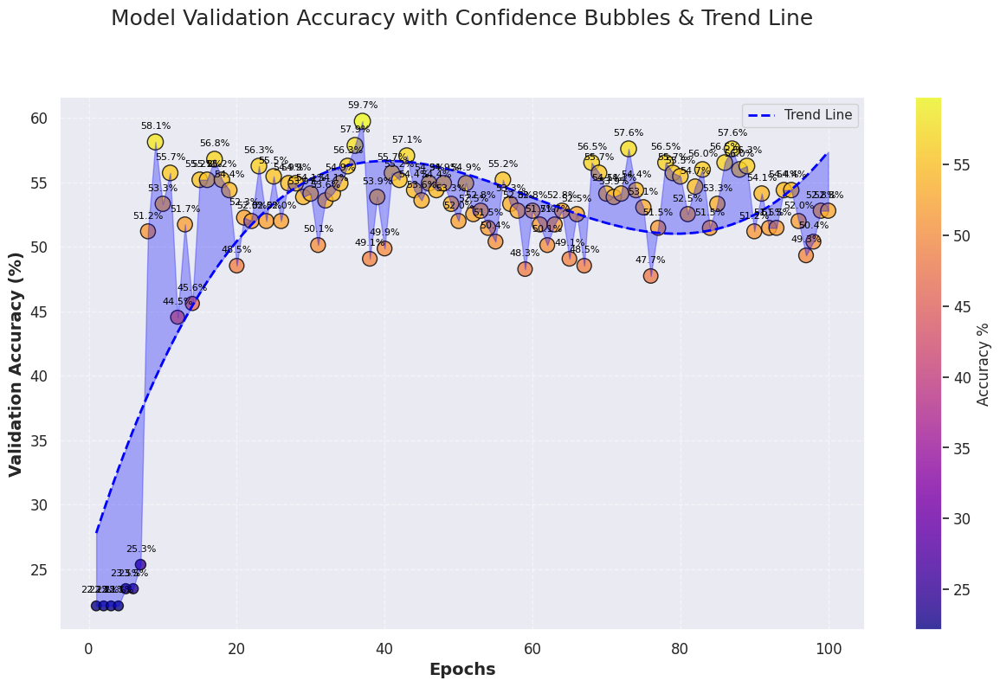

In [189]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

def bubble_accuracy_plot(history_model_net):
    """
    Plots validation accuracy with confidence bubbles & trend line.
    """
    # Extract accuracy values
    train_acc = np.array(history_model_net.history['accuracy']) * 100  # Convert to %
    val_acc = np.array(history_model_net.history['val_accuracy']) * 100  # Convert to %
    epochs = len(val_acc)  # Total number of epochs

    # Set up figure
    fig, ax = plt.subplots(figsize=(15, 8))  

    # X-axis (epochs)
    x_data = np.arange(1, epochs + 1)  

    # Bubble sizes & colors
    sizes = val_acc * 3  
    colors = val_acc  

    # Scatter plot with bubbles
    scatter = ax.scatter(x_data, val_acc, s=sizes, c=colors, cmap='plasma', alpha=0.8, edgecolors='black', linewidth=1)

    # Trend line using polynomial fit
    z = np.polyfit(x_data, val_acc, deg=3)  
    p = np.poly1d(z)
    trend_y = p(x_data)
    ax.plot(x_data, trend_y, color='blue', linewidth=2, linestyle='dashed', label="Trend Line")

    # Fill between trend line and actual accuracy
    ax.fill_between(x_data, val_acc, trend_y, color='blue', alpha=0.3)

    # Labels and title
    ax.set_xlabel("Epochs", fontsize=14, weight='bold')
    ax.set_ylabel("Validation Accuracy (%)", fontsize=14, weight='bold')
    ax.set_title("Model Validation Accuracy with Confidence Bubbles & Trend Line", fontsize=18, pad=60)

    # Color bar for accuracy levels
    cbar = plt.colorbar(scatter, ax=ax, label='Accuracy %')

    # Grid for readability
    plt.grid(True, linestyle='--', alpha=0.5)

    # Add epoch labels on bubbles
    for i, txt in enumerate(val_acc):
        ax.text(x_data[i], val_acc[i] + 1, f'{txt:.1f}%', ha='center', fontsize=8, color='black')

    # Legend
    ax.legend()
    
    plt.show()

# Call the function with your model history
bubble_accuracy_plot(history_model_net)
